<a href="https://colab.research.google.com/github/tomorrownow/FCMAnalysis/blob/master/analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# FCM Analysis

## Import python libraries

In [1]:
import os
import matplotlib.pyplot as plt; plt.rcdefaults()
import matplotlib.pyplot as plt
import seaborn as sns

import xlrd
import numpy as np
import networkx as nx
import pandas as pd

## Configure Env

In [2]:
!mkdir ./FCMs
!mkdir ./data

In [3]:
data_location ="./drive/Shared drives/TomorrowNow/Workshop #2 - April 2019/Results/FCM/con_agg"
save_location = "/content/drive/Shared drives/TomorrowNow/Workshop #2 - April 2019/Results/FCM/figures"

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
from google.colab import auth
auth.authenticate_user()

## Generate List of All FCM Variables

In [6]:
allConcepts = []
for root, dirs, files in os.walk(data_location, topdown=False):
    for name in files:
        if "allFCMs" not in name and name != ".DS_Store":
            fileLocation = os.path.join(root, name)
            df = pd.read_excel(fileLocation)
            concepts = np.delete(df.columns.values, 0)
            group = name.split("_")[1].split(".")[0]
            groupedConcepts = [group].append(concepts)
            dic = dict(key=group, value=concepts)
            allConcepts.append(dic)


In [7]:
conceptTable = []
id = 0
for concepts in allConcepts:
    # print("Concepts: {}".format(concepts))   
    groupName = concepts["key"]
    model = concepts["value"]
    for concept in model:
        # print("Concept: {}".format(concept))
        conceptTable.append([id, groupName, concept])
    id+=1

df_concepts = pd.DataFrame(data=conceptTable, columns=["model_id","group","concept"]) 
df_concepts.describe()

,model_id
count,278.000000
mean,10.017986
std,6.073232
min,0.000000
25%,4.000000
50%,10.000000
75%,15.000000
max,20.000000


## Import Inductive Coding Google Sheet

In [9]:
# Import Variables from Inductive coding
import gspread
from oauth2client.client import GoogleCredentials
gc = gspread.authorize(GoogleCredentials.get_application_default())
wb = gc.open_by_url('https://docs.google.com/spreadsheets/d/1HBa4zdeW38044pTCgk7J9ix9ktvWlftyZ8dk4yHxFa8/edit#gid=1416274663')
sheet = wb.worksheet('Todd_CoreyMerge')
data = sheet.get_all_values()


In [10]:
df_grouped_variables = pd.DataFrame(data)
df_grouped_variables.columns = df_grouped_variables.iloc[0]
df_grouped_variables = df_grouped_variables.iloc[1:]
df_grouped_variables.head()

,var,name,group_name,Todd group #,Todd group name,notes,Collab Group_num,Collab_Group_Name,,
1,125,agriculture,agriculture,,,,1,agriculture,,
2,77,algal blooms,algal blooms,,,,2,algal blooms,,
3,151,benthic habitat,stream health,,,,3,benthic habitat,,
4,13,canopy,canopy,,,,4,canopy,,
5,26,citizen satisfaction,citizen satisfaction,,,,5,citizen satisfaction,,


#### Map original variables to grouped varibales

In [11]:
# Map original variables to grouped variables
concept_map = dict(zip(df_grouped_variables['name'].values, df_grouped_variables['Collab_Group_Name'].values))
df_concepts['code'] = df_concepts['concept'].map(concept_map)

#### Export table of how variables were map to latex for appedix

In [12]:
df_concepts.groupby(by=['code', 'concept'])['concept'].count().to_latex(index=True, label="concept_map")

"\\begin{table}\n\\centering\n\\label{concept_map}\n\\begin{tabular}{llr}\n\\toprule\n                   &                    &  concept \\\\\ncode & concept &          \\\\\n\\midrule\nDevelopment Planning and Policies & development planning and policies &        1 \\\\\nHighway commercial development & highway commercial development &        3 \\\\\nLocal economy & economic development &        1 \\\\\n                   & local economy &        2 \\\\\nOpen Space & land conservation areas &        1 \\\\\n                   & land preservation &        1 \\\\\n                   & open space &        2 \\\\\n                   & pervious area &        1 \\\\\n                   & urban parks/greenspace &        1 \\\\\nOpen Space Quality & pervious area quality &        1 \\\\\nPolitical will & political climate &        1 \\\\\n                   & political will &        3 \\\\\n                   & state government and legislature policy preferences &        1 \\\\\nPrivate land 

In [13]:
pd.DataFrame(df_concepts['code'].unique()).to_csv("./data/variableList.csv")

## Variable Count Bar Chart

126
flooding                                     16
impervious surfaces                          15
rainfall                                     15
runoff                                       11
Urban development with specific land uses     9
water quality                                 8
retention/detention capacity                  6
property damage                               6
climate change                                6
Open Space                                    6
Political will                                5
stream/ecosystem health                       5
streamflow                                    5
erosion                                       5
SCM                                           5
population                                    4
natural areas                                 4
traffic                                       4
development restrictions                      3
canopy                                        3
Highway commercial development      

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 
  


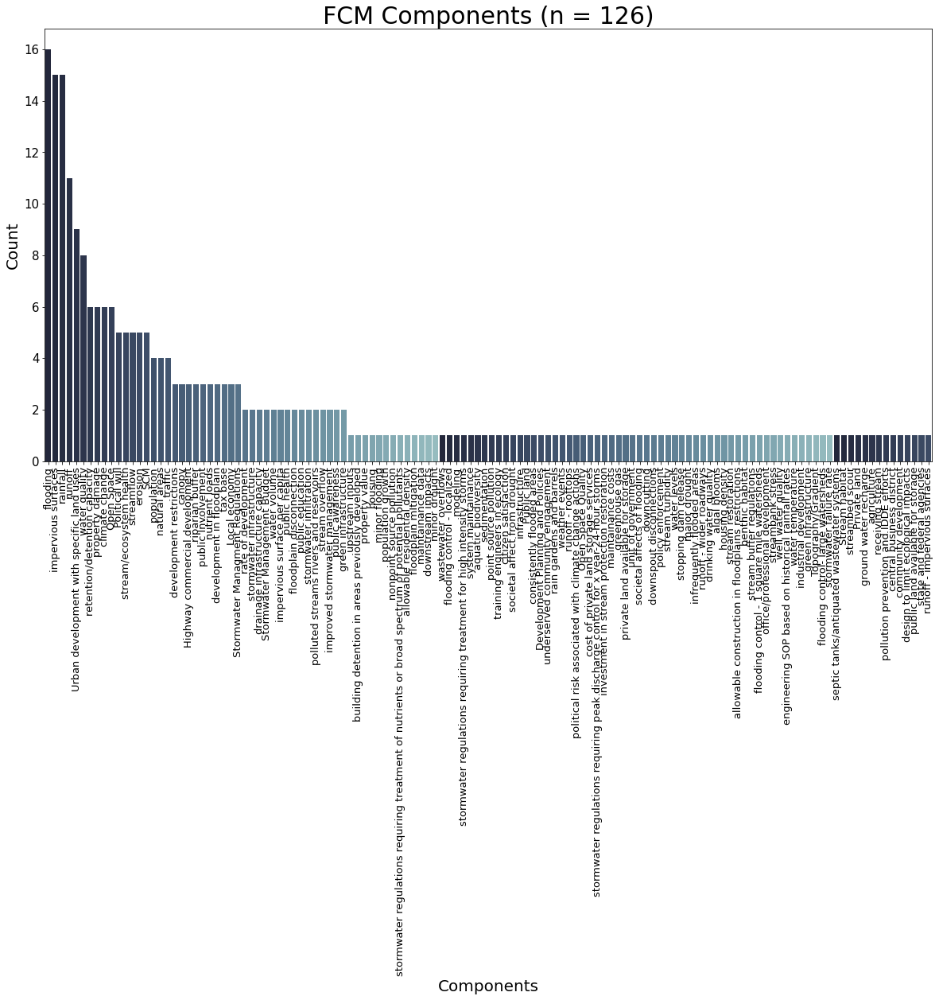

In [14]:
components_count = len(df_concepts['code'].unique())
print(len(df_concepts['code'].unique()))
print(df_concepts["code"].value_counts().head(25))
fig,ax= plt.subplots(figsize=(20, 10))
# print(df_concepts['concept'].value_counts())
pal = sns.cubehelix_palette(56, rot=-.25, light=.7, reverse=True)
sns.countplot(x="code", data=df_concepts, ax=ax, order = df_concepts['code'].value_counts().index, dodge=False, palette=pal, orient='h')
plt.xticks(rotation=90)
plt.ylabel('Count', size = 20)
plt.xlabel('Components', size = 20)
plt.yticks(size = 15)
plt.xticks(size = 13)
ax.set_title(("FCM Components (n = %d)" % components_count), fontsize=30)
plt.tight_layout()
# sns.countplot(y="concept", col_wrap=5, data=df_concepts, kind="count",height=4, aspect=.7)
plt.savefig(os.path.join(save_location, "FCM Components"),dpi=300)

## FCM Variable Distribution

The mean number of variables in each participants FCM is 13 and follows a normal distribution.

count    21.000000
mean     13.238095
std       3.548306
min       7.000000
25%      11.000000
50%      13.000000
75%      16.000000
max      20.000000
Name: code, dtype: float64


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


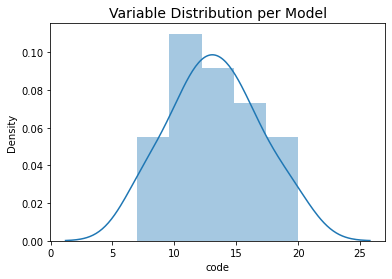

In [15]:
df_model_counts = df_concepts.groupby('model_id')['code'].count()
print(df_model_counts.describe())
fig, ax = plt.subplots()
ax.set_title(("Variable Distribution per Model"), fontsize=14)
ax.set_xlabel("Number of Variables")
sns.distplot(df_model_counts, ax=ax, bins=5)
plt.savefig(os.path.join(save_location, "Variable Distribution per Model"))

### Distributions by Stakeholder Group

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


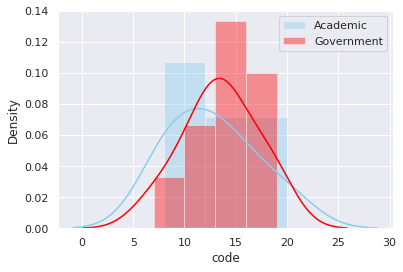

In [16]:
 sns.set(style="darkgrid")

sns.distplot(df_concepts[df_concepts['group'] == "academic"].groupby('model_id')['code'].count(), color="skyblue", label="Academic", kde=True)
sns.distplot(df_concepts[df_concepts['group'] == "government"].groupby('model_id')['code'].count(), color="red", label="Government", kde=True)

plt.legend() 
plt.show()

## Bar Chart of the total of FCMs by Stakeholder Group

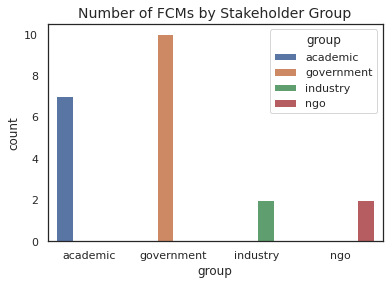

In [17]:
df_model_counts = df_concepts.groupby(['group', 'model_id']).agg(['count']).reset_index()
sns.set(style="white")
fig, ax = plt.subplots()
ax.set_title(("Number of FCMs by Stakeholder Group"), fontsize=14)
ax.set_xlabel("Stakeholder Group")
ax.set_ylabel("Number of FCMs")
sns.countplot(hue="group", x="group", data=df_model_counts,ax=ax)
plt.savefig(os.path.join(save_location, "Number of FCMs by Stakeholder Group"))


# Accumulation Curves

An accumlation curve was generated using Monte Carlo techniques to generate 500 possible accumulations of variables to determine if the sample size of maps is large enough to capture the complexity of the model (Özesmi and Özesmi, 2004). The accumulation curve of total variables (Figure 1) shows that the number of new variables added by each map has not yet reached a stable state, and the accumulation curve of new variable shows that the number of new variable captured with each new map is decreasing, but that stakeholders do not share a strong shared vocabulary.

## Function: Accumualtoin_curve

In [18]:
from sklearn.utils import shuffle
from matplotlib.ticker import MaxNLocator

def fcm_accumualtion_curve(df,ax=None, new_variables=False, n=500):
    """Generate accumulation curve of the number of model variables by using
    a Monte Carlo technique to determine how the variables accumulate.
    
    :param df: DataFrame.
    :param ax: axes object from matplotlib.
    :param new_variables: Deterimes which accumulation curve to generate. False generates the total varibale accumulation curve and True generates the new variables accumulation curve.
    :param n: Number of time to run Monte Carlo simulation.
    :return: ax and plt
    """
    ax = ax or plt.gca()
    
    #Set random seed for shuffling dataframes
    np.random.seed(1)
    
    #DataFrame to store the results of each accumualtion curve
    allDataFrames = pd.DataFrame()
    

    df_models = df.groupby('model_id')['concept'].apply(list).reset_index()
    
    for x in range(n+1):
        #empty set that is used to keep track of which concepts are already counted. It is reset to empty during each iteration
        used_concepts = set()

        def _accumulate(concepts):
            """Determines new concepts and adds them to used_concepts set to keep track
            
            :param concepts: List of model concepts (variables).
            :return: Count of new concepts add from each model.
            """
            new_concepts = 0
            for concept in concepts:
                if concept not in used_concepts:
                    used_concepts.add(concept)
                    new_concepts+=1
            return new_concepts
        
        df_shuffled = shuffle(df_models)
        df_accumulate = df_shuffled['concept'].apply(_accumulate)
        if new_variables:
            df_concept_cum_sum = df_accumulate.reset_index()
        else:
            df_concept_cum_sum = df_accumulate.cumsum(0).reset_index()
            
        #Concat all accumulation curves into a single dataframe to generate the average, min, and max.
        allDataFrames = pd.concat((allDataFrames, df_concept_cum_sum))
    
   
    
    df_mean = allDataFrames.groupby(level=0).mean()
    df_mean['name'] = "Mean"
    df_mean['index_col'] = df_mean.index
    
    df_min=allDataFrames.groupby(level=0).min()
    df_min['name'] = "Envelope"
    df_min['index_col'] = df_min.index
    
    df_max = allDataFrames.groupby(level=0).max()
    df_max['name'] = "Envelope"
    df_max['index_col'] = df_max.index

    
    df_final = pd.concat([df_mean, df_min, df_max])
    
    #Plot the mean and the envelope
    palette = sns.color_palette("mako_r", 2)
    sns.lineplot(
        x="index_col",
        y="concept",
        hue="name",
        style="name",
        markers=True,
        dashes=True, 
        data=df_final,
        palette=palette,
        legend="brief",
        ax=ax)
    
    #Configure plot labels
    plt.suptitle('Accumulation Curves', fontsize=20)
    plt.yticks(size = 14)
    plt.xticks(size = 14) 
    ax.set_xlabel("Number of FCMs", fontsize=14)
    ax.xaxis.set_major_locator(MaxNLocator(integer=True))
    if new_variables:
        ax.set_title(("Number of Unique Components added Per FCM" ), fontsize=16)
        ax.set_ylabel("Unique Components")
    else:
        ax.set_title(("Total Number of Unique Components" ), fontsize=16)
        ax.set_ylabel("Unique Components") 
        
    return ax, plt


## All Stakeholders

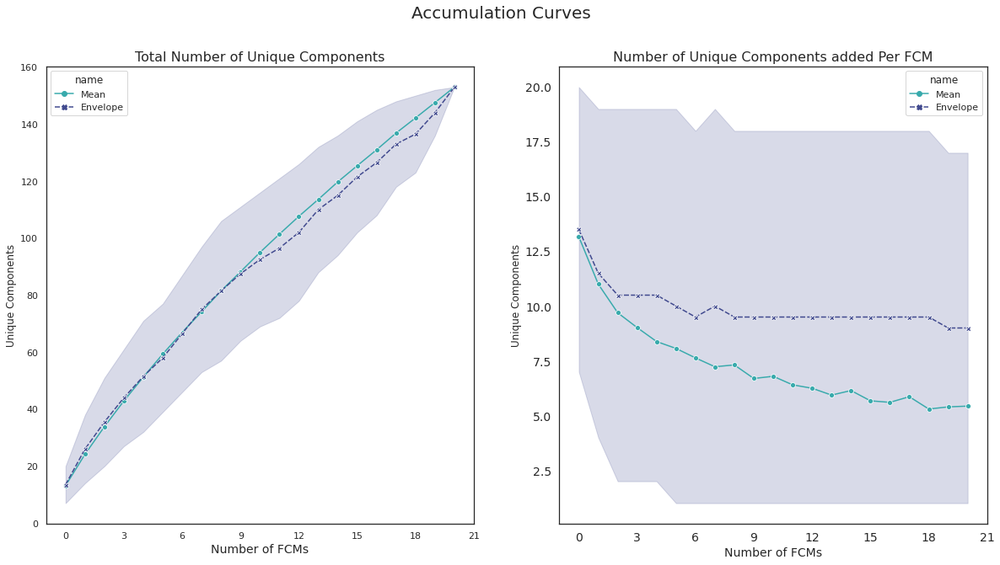

In [19]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20, 10))
# plt.title('Combined Stakeholders', fontsize=14)
fcm_accumualtion_curve(df_concepts,ax1,new_variables=False, n= 500)   
fcm_accumualtion_curve(df_concepts,ax2,new_variables=True, n= 500)

plt.savefig(os.path.join(save_location, "Accumulation_Curves"), dpi=300)

## Government Stakeholders

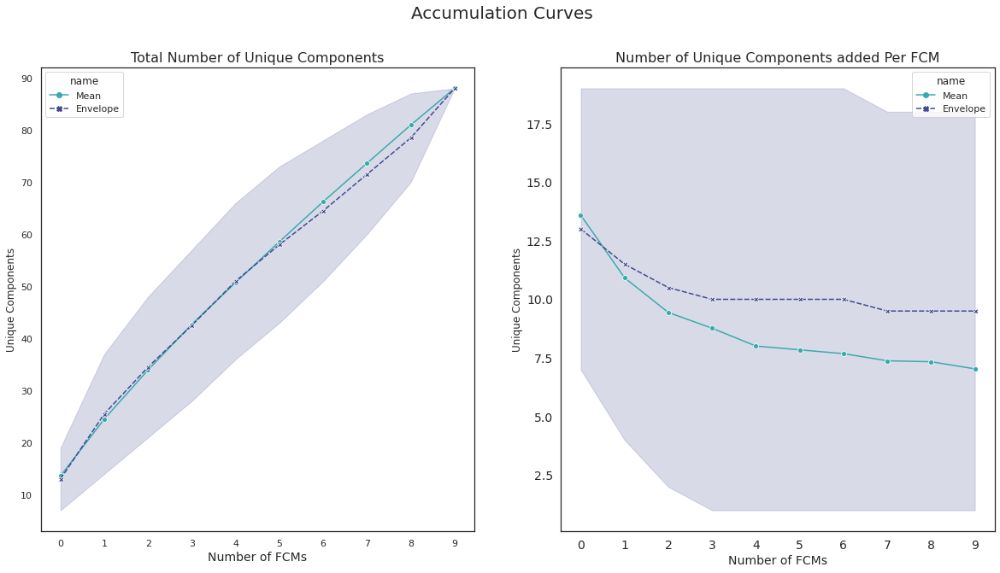

In [20]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20, 10))
plt.title('Government Stakeholders', fontsize=14)
fcm_accumualtion_curve(df_concepts[df_concepts["group"] == "government"],ax1,new_variables=False, n= 500)   
fcm_accumualtion_curve(df_concepts[df_concepts["group"] == "government"],ax2,new_variables=True, n= 500)
plt.savefig(os.path.join(save_location, "Accumulation_Curves_Government"))

## Academic Stakeholders

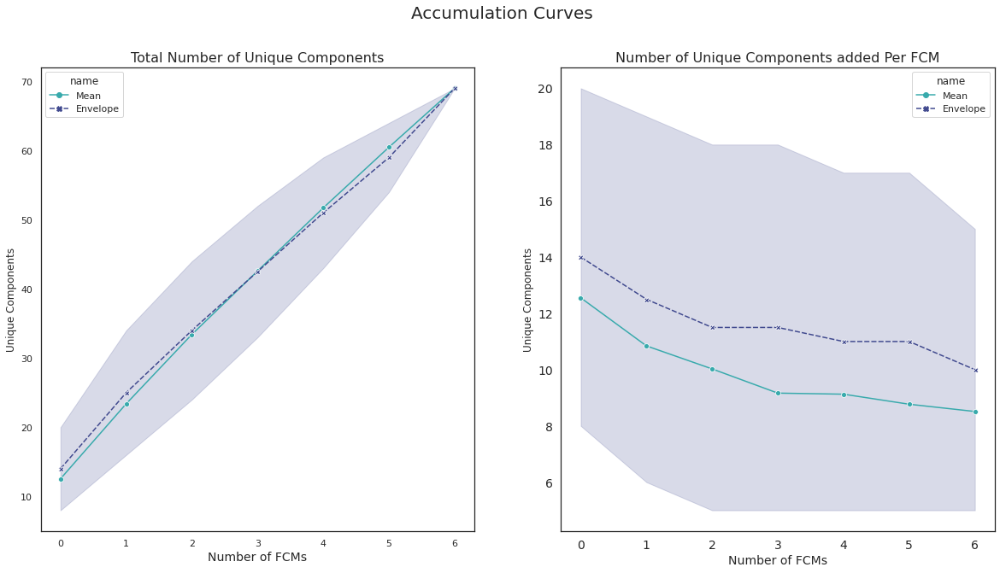

In [21]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20, 10))
fcm_accumualtion_curve(df_concepts[df_concepts["group"] == "academic"],ax1,new_variables=False, n= 500)   
fcm_accumualtion_curve(df_concepts[df_concepts["group"] == "academic"],ax2,new_variables=True, n= 500)
plt.savefig(os.path.join(save_location, "Accumulation_Curves_Academic"))

## NGO Stakeholders

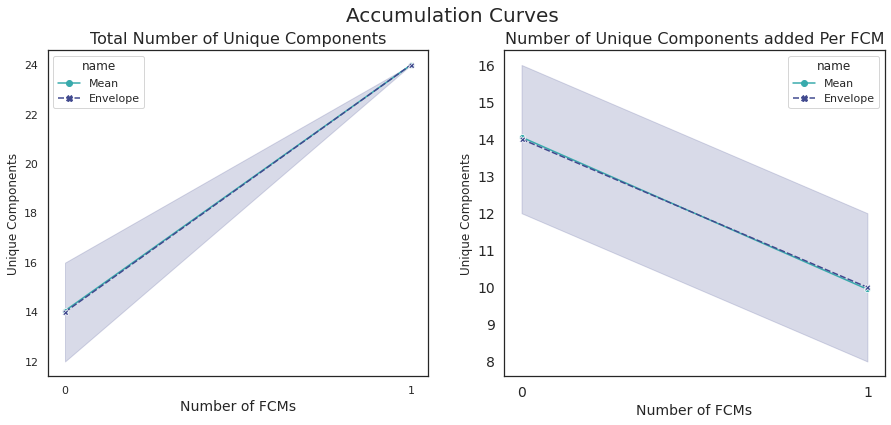

In [22]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(15, 6))
plt.title('NGO Stakeholders', fontsize=14)
fcm_accumualtion_curve(df_concepts[df_concepts["group"] == "ngo"],ax1,new_variables=False, n= 500)   
fcm_accumualtion_curve(df_concepts[df_concepts["group"] == "ngo"],ax2,new_variables=True, n= 500)
plt.savefig(os.path.join(save_location, "Accumulation_Curves_NGO"))

## Industry Stakeholders

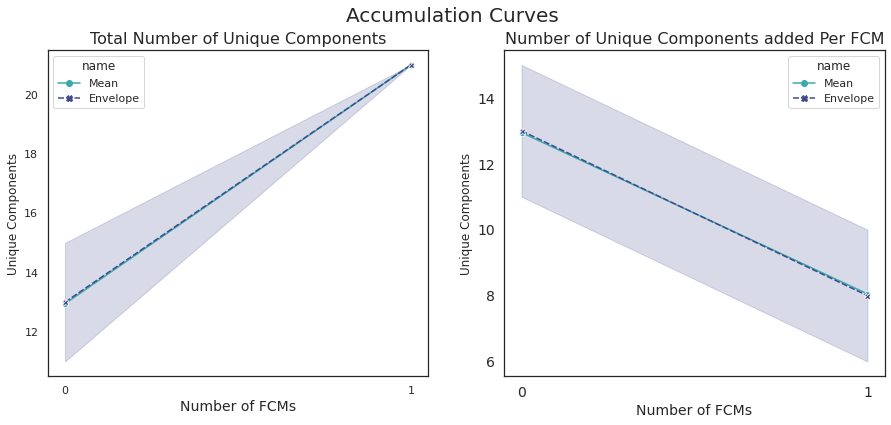

In [23]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(15, 6))
plt.title('Industry Stakeholders', fontsize=14)
fcm_accumualtion_curve(df_concepts[df_concepts["group"] == "industry"],ax1,new_variables=False, n= 500)   
fcm_accumualtion_curve(df_concepts[df_concepts["group"] == "industry"],ax2,new_variables=True, n= 500)
plt.savefig(os.path.join(save_location, "Accumulation_Curves_Industry"))

# FCM Graph Functions

## Function: Graph_Complexity

In [24]:
def graph_complexity(r,t):
    """Calculates grapth complexity by returning the ratio of receivers to transmitters. Complex maps have a higher ratio
    define more outcomes and have less forces that contorl the system.
    
    :param r: Receiver.
    :param t: Transmitter.
    :return: Graph complexity as a float.
    """
    complexity = float('NaN')
    try:
        complexity = float(r)/float(t)
    except ZeroDivisionError:
        print("Complexity can not be calculated because the graph has zero transmitters")
    return complexity

        
        
    

## Function: generate_map

In [29]:
# These global variables are bad and need to be refactored so they do not get unintentionally mutated
# They are currenlty used to record data for each individual FCM when they are created
total_recievers = []
total_transmitters = []
central_nodes = []

def generate_map(data, columns, ax=None, verbose=False):
    """Generates FMC graph and basic statistics
    
    :param data: np.matrix or numpy.ndarray of graph values
    :param columns: List of column names used to label graph nodes.
    :param ax: Axes object from matplotlib.
    
    :return: Dictionary of graph statistics.
    """
    from operator import add

    ax = ax or plt.gca()
    G = nx.DiGraph(data)

    # # Lable Nodes in Graph with varible names
    # g_labels = {}
    # for nod in G.nodes():
    #   g_labels[nod] = columns[nod]
    # G = nx.relabel_nodes(G, g_labels)

    total_edges = G.number_of_edges()
    
    total_nodes = G.number_of_nodes()
  
    transmitters = 0
    receivers = 0
    ordinary = 0
    this_total_recievers = []
    this_total_transmitters = []
    this_central_nodes = []
    this_new_centrality = {"variable": [], "in-degree": [], "out-degree": []}

    for out_node, out_degree in G.out_degree():
        for in_node, in_degree in G.in_degree():
            
            if (in_node == out_node):
                
                #Receiver Varibale
                if (in_degree > 0 and out_degree == 0):
                    receivers+=1
                    total_recievers.append( columns[in_node])
                    this_total_recievers.append( columns[in_node])

                #Transmitter Varibale
                elif (out_degree > 0 and in_degree == 0):
                    transmitters+=1
                    total_transmitters.append(columns[in_node])
                    this_total_transmitters.append(columns[in_node])

                else:
                    ordinary+=1

    
    # 0 column id
    # 1 row od
    
    this_new_centrality['variable'] = columns
    this_new_centrality['in-degree'] = np.sum(np.abs(data), axis = 0) #.append(in_degree)
    this_new_centrality['out-degree'] = np.sum(np.abs(data), axis=1) #.append(out_degree)
    this_new_centrality['centrality'] = list(map(add, this_new_centrality['in-degree'], this_new_centrality['out-degree']))
    print(G.edges(data=True))
    poseverylarge=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] >=0.75]
    poselarge=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] >0.5 and d['weight'] <0.75]
    posesmall=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] <=0.5 and d['weight'] >0.25]
    poseverysmall=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] <=0.25 and d['weight'] > 0]
    
    everyzero=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] == 0]

    negeverylarge=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] <= -0.75]
    negelarge=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] <-0.5 and d['weight'] >-0.75]
    negesmall=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] >=-0.5 and d['weight'] <-0.25]
    negeverysmall=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] >=-0.25 and d['weight'] < 0]

    #################Centrality#####################################################################
    label= {}
    for nod in G.nodes():
        label[nod] = columns[nod]

    # pos = nx.random_layout(G, dim=2)
    pos=nx.spring_layout(G,dim=2, k=0.5)
    # pos = nx.circular_layout(G)
   


    #########################Visualization##############################################################
    
    nx.draw_networkx(G,pos,labels=label,font_size=24, node_size= 200 ,node_color='lightgrey' ,alpha=0.6)
    nx.draw_networkx_edges(G,pos,edgelist=poseverylarge, width=2,alpha=0.5,edge_color='#6a51a3')
    nx.draw_networkx_edges(G,pos,edgelist=poselarge, width=1.5,alpha=0.5,edge_color='#9e9ac8',style='dashed')
    nx.draw_networkx_edges(G,pos,edgelist=posesmall, width=1,alpha=0.5,edge_color='#cbc9e2',style='dashed')
    nx.draw_networkx_edges(G,pos,edgelist=poseverysmall, width=0.25,alpha=0.5,edge_color='#f2f0f7',style='dashed')

    #['#edf8e9','#bae4b3','#74c476','#238b45']
  
    nx.draw_networkx_edges(G,pos,edgelist=negeverylarge, width=2,alpha=0.5,edge_color='#238b45')
    nx.draw_networkx_edges(G,pos,edgelist=negelarge, width=1.5,alpha=0.5,edge_color='#74c476',style='dashed')
    nx.draw_networkx_edges(G,pos,edgelist=negesmall, width=1,alpha=0.5,edge_color='#bae4b3',style='dashed')
    nx.draw_networkx_edges(G,pos,edgelist=negeverysmall, width=0.25,alpha=0.5,edge_color='#edf8e9',style='dashed')



#     nx.write_edgelist(G, "aggregated_edg.csv")
    print(pd.DataFrame(np.sum(np.abs(data), axis = 0) + np.sum(np.abs(data), axis=1), columns=["centrality"], index=columns).sort_values(by=['centrality'], ascending=False).head(25))
    most_central_node = pd.DataFrame(np.sum(np.abs(data), axis = 0) + np.sum(np.abs(data), axis=1), columns=["centrality"], index=columns).sort_values(by=['centrality'], ascending=False).index.tolist()[0]
    central_nodes.append(most_central_node)
    this_central_nodes.append(most_central_node)
    if verbose:
        print("Total Nodes: {}".format(total_nodes))
        print("Total Edges: {}".format(total_edges))
        print("Distance: {}".format(total_edges / total_nodes))
        print("Central Node: {}".format(this_central_nodes))
        print("Transmitter Nodes: {}".format(this_total_transmitters))
        print("Receiver Nodes: {}".format(this_total_recievers))
        print("Clusters: {}".format(nx.clustering(G)))
        print("Degree: {}".format(nx.degree(G)))
        print("Density {}".format(nx.density(G)))

    map_stats = {
        "total_nodes": total_nodes, # Variables (N)
        "total_edges": total_edges, # Connections (C)
        "distance": total_edges / total_nodes, # distance = C/N
        "ordinary": ordinary,
        "receivers": receivers,
        "transmitters":transmitters,
        "total variables": transmitters + receivers + ordinary,
        "receiver_components": this_total_recievers,
        "transmitters_components": this_total_transmitters,
        "central_components": this_central_nodes,
        "weights": [d['weight'] for (u,v,d) in G.edges(data=True)],
        "density": nx.density(G),
        "new_centrality": this_new_centrality
    }
    
        
    if transmitters != 0:
        map_stats["complexity"] = graph_complexity(receivers, transmitters)

        
        map_stats["hierarchy"] = nx.flow_hierarchy(G)

        if verbose:
          print("Complexity {}".format(map_stats["complexity"]))
          print("Hierarchy {}".format(map_stats["hierarchy"]))
    else:
        print("Zero transmitters identified")
    nx.write_gexf(G, "test.gexf")
    return map_stats


## Function: Generate Condensed Map (Depreiated)


In [25]:
total_recievers = []
total_transmitters = []
central_nodes = []
def generate_condensed_map(data, columns, ax=None):
    """Generates FMC graph and basic statistics
    
    :param data: np.matrix or numpy.ndarray of graph values
    :param columns: List of column names used to label graph nodes.
    :param ax: Axes object from matplotlib.
    
    :return: Dictionary of graph statistics.
    """
    ax = ax or plt.gca()
    G = nx.DiGraph(data)
    
    scc = list(nx.strongly_connected_components(G))
    C = nx.condensation(G, scc=scc) 
     
    g_labels = {}
    
    for nod in G.nodes():
      g_labels[nod] = columns[nod]
    G = nx.relabel_nodes(G, g_labels)
    
    # print(G.nodes())
    label= {}
    # original = {}
    weak_nodes = []
    for source_nod, new_nod in C.graph['mapping'].items():
      print("key (source_nod): {}, value (new_nod): {}, label: {}, gLabel: {}".format(source_nod, new_nod, columns[source_nod], g_labels[source_nod]))
      # label[new_nod] = columns[source_nod]
      # original[source_nod] = columns[source_nod]
      if new_nod != 20:
        weak_nodes.append(source_nod)
      else:
        label[source_nod] = columns[source_nod]
    
    weak_nodes = [g_labels[wn] for wn in weak_nodes]
    # weak_nodes = [ for k, v in g_labels.items()]
    print("Weak Nodes: {}".format(weak_nodes))
    G.remove_nodes_from(weak_nodes)
    for (u,v,d) in G.edges(data=True):
      print("u: {}, v: {}, d: {}".format(u,v,d))
      if u in weak_nodes or v in weak_nodes:
        G.remove_edge(u,v)


    # print(G.nodes())
    
    # for c in C.nodes():
    #   print(c)
    # # print(columns)
    print("g_labels: {}".format(g_labels))
    # print("orginal: {}".format(original))
    print("c_labels: {}".format(label))

    transmitters = 0
    receivers = 0
    ordinary = 0
    this_total_recievers = []
    this_total_transmitters = []
    this_central_nodes = []

    for out_node, out_degree in G.out_degree():
        for in_node, in_degree in G.in_degree():
            if (in_node == out_node):
                #Receiver Varibale
                if (in_degree > 0 and out_degree == 0):
                    receivers+=1
                    total_recievers.append( label[in_node])
                    this_total_recievers.append( label[in_node])
                    # print("Node %s is a receiver variable" % columns[in_node])
                #Transmitter Varibale
                elif (out_degree > 0 and in_degree == 0):
                    transmitters+=1
                    total_transmitters.append(label[in_node])
                    this_total_transmitters.append(label[in_node])

                    # print("Node %s is a transmitter variable" % columns[in_node])
                else:
                    ordinary+=1

  
    print(G.edges(data=True))
    poseverylarge=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] >=0.75]
    poselarge=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] >0.5 and d['weight'] <0.75]
    posesmall=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] <=0.5 and d['weight'] >0.25]
    poseverysmall=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] <=0.25 and d['weight'] > 0]
    
    everyzero=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] == 0]

    negeverylarge=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] <= -0.75]
    negelarge=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] <-0.5 and d['weight'] >-0.75]
    negesmall=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] >=-0.5 and d['weight'] <-0.25]
    negeverysmall=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] >=-0.25 and d['weight'] < 0]

    #################Centrality#####################################################################
    
    print(C.graph['mapping'])
    
    
  
    
    # pos = nx.random_layout(G, dim=2)
    pos=nx.spring_layout(G,dim=2, k=0.75)
    # pos = nx.circular_layout(G)
   


    #########################Visualization##############################################################
    
    nx.draw_networkx(G,pos,with_labels=True,font_size=36, node_size= 200 ,node_color='lightgrey' ,alpha=0.6)
    nx.draw_networkx_edges(G,pos,edgelist=poseverylarge, width=2,alpha=0.5,edge_color='#6a51a3')
    nx.draw_networkx_edges(G,pos,edgelist=poselarge, width=1.5,alpha=0.5,edge_color='#9e9ac8',style='dashed')
    nx.draw_networkx_edges(G,pos,edgelist=posesmall, width=1,alpha=0.5,edge_color='#cbc9e2',style='dashed')
    nx.draw_networkx_edges(G,pos,edgelist=poseverysmall, width=0.25,alpha=0.5,edge_color='#f2f0f7',style='dashed')

  
    nx.draw_networkx_edges(G,pos,edgelist=negeverylarge, width=2,alpha=0.5,edge_color='#238b45')
    nx.draw_networkx_edges(G,pos,edgelist=negelarge, width=1.5,alpha=0.5,edge_color='#74c476',style='dashed')
    nx.draw_networkx_edges(G,pos,edgelist=negesmall, width=1,alpha=0.5,edge_color='#bae4b3',style='dashed')
    nx.draw_networkx_edges(G,pos,edgelist=negeverysmall, width=0.25,alpha=0.5,edge_color='#edf8e9',style='dashed')



#     nx.write_edgelist(G, "aggregated_edg.csv")
    print(pd.DataFrame(np.sum(data, axis = 0) + np.sum(data, axis=1), columns=["centrality"], index=columns).sort_values(by=['centrality'], ascending=False).head(25))
    most_central_node = pd.DataFrame(np.sum(data, axis = 0) + np.sum(data, axis=1), columns=["centrality"], index=columns).sort_values(by=['centrality'], ascending=False).index.tolist()[0]
    central_nodes.append(most_central_node)
    this_central_nodes.append(most_central_node)
    print("Central Node: {}".format(this_central_nodes))
    print("Transmitter Nodes: {}".format(this_total_transmitters))
    print("Receiver Nodes: {}".format(this_total_recievers))
    print("Clusters: {}".format(nx.clustering(G)))
    print("Degree: {}".format(nx.degree(G)))
    map_stats = {
        "ordinary": ordinary,
        "receivers": receivers,
        "transmitters":transmitters,
        "total variables": transmitters + receivers + ordinary,
        "receiver_components": this_total_recievers,
        "transmitters_components": this_total_transmitters,
        "central_components": this_central_nodes
    }
    
    map_stats["density"] = nx.density(G)
    print("Density {}".format(map_stats["density"]))
    if transmitters != 0:
        map_stats["complexity"] = graph_complexity(receivers, transmitters)
        print("Complexity {}".format(map_stats["complexity"]))
        map_stats["hierarchy"] = nx.flow_hierarchy(G)
        print("Hierarchy {}".format(map_stats["hierarchy"]))
    else:
        print("Zero transmitters identified")
    # nx.write_gexf(C, "test.gexf")
    return map_stats

## Function: Sensitivity Analysis


In [26]:

def sensitivity_analysis(data, columns, noise_threshold=0, lambda_thres=0, principles=[], list_of_consepts_to_run=[], function_type="tanh", infer_rule="mk"):
    """Generates FMC Sensitivity Analysis
    
    :param data: 
    :param columns: List of variable names.
    :param noise_threshold: 
    :param lambda_thres: [0 - 10] Squashing function
    :param principles: List of principle components in system you want to track changes in
    :param list_of_consepts_to_run:
    :param function_type: biv = Bivalent, triv = Trivalent, sig = Sigmoid, tanh = Hyperbolic Tangent
    :param infer_rule: k = Kasko, mk = Modified Kasko, r = Rescaled Kasko
    :return: Dictionary of graph statistics.
    """
    import math
    import networkx as nx
    import numpy as np
    # ax = ax or plt.gca()
    n_concepts = len(columns)
    Adj_matrix = np.zeros((n_concepts,n_concepts))

    activation_vec = np.ones(n_concepts)
    print(columns.values)
    Concepts_matrix = [] #[]
    # print(data)
    for i in range (1,n_concepts):
        print(columns.values[i])
        Concepts_matrix.append(columns.values[i])

    

    G = nx.DiGraph(data)
    
    #label nodes with variable names
    node_name = {}
    for nod in G.nodes():
      node_name[nod] = columns[nod]

    G = nx.relabel_nodes(G, node_name)
    print(G)

    def TransformFunc (x, n, f_type,landa=lambda_thres):
    
      if f_type == "sig":
          x_new = np.zeros(n)
          for i in range (n):
              x_new[i]= 1/(1+math.exp(-landa*x[i]))
              
          return x_new    

      
      if f_type == "tanh":
          x_new = np.zeros(n)
          for i in range (n):
              x_new[i]= math.tanh(landa*x[i])
          
          return x_new
      
      if f_type == "bivalent":
          x_new = np.zeros(n)
          for i in range (n):
              if x[i]> 0:
                  x_new[i]= 1
              else:
                  x_new[i]= 0
          
          return x_new
      
      if f_type == "trivalent":
          x_new = np.zeros(n)
          for i in range (n):
              if x[i]> 0:
                  x_new[i] = 1
              elif x[i]==0:
                  x_new[i] = 0
              else:
                  x_new[i] = -1
          
          return x_new
    
  
    def infer_steady (init_vec = activation_vec , AdjmT = Adj_matrix.T, n =n_concepts , f_type="sig", infer_rule ="mk"):
      act_vec_old= init_vec
      
      resid = 1
      while resid > 0.00001:
          act_vec_new = np.zeros(n)
          x = np.zeros(n)
          
          if infer_rule == "k":
              x = np.matmul(AdjmT, act_vec_old)
          if infer_rule == "mk":
              x = act_vec_old + np.matmul(AdjmT, act_vec_old)
          if infer_rule == "r":
              x = (2*act_vec_old-np.ones(n)) + np.matmul(AdjmT, (2*act_vec_old-np.ones(n)))
              
          act_vec_new = TransformFunc (x ,n, f_type)
          resid = max(abs(act_vec_new - act_vec_old))
          
          act_vec_old = act_vec_new
      return act_vec_new

    def infer_scenario (Scenario_concept,init_vec = activation_vec , AdjmT = Adj_matrix.T, n =n_concepts , f_type="sig", infer_rule ="mk" , changeLevel = 1):
      act_vec_old= init_vec
      
      resid = 1
      while resid > 0.00001:
          act_vec_new = np.zeros(n)
          x = np.zeros(n)
          
          if infer_rule == "k":
              x = np.matmul(AdjmT, act_vec_old)
          if infer_rule == "mk":
              x = act_vec_old + np.matmul(AdjmT, act_vec_old)
          if infer_rule == "r":
              x = (2*act_vec_old-np.ones(n)) + np.matmul(AdjmT, (2*act_vec_old-np.ones(n)))
              
          act_vec_new = TransformFunc (x ,n, f_type)
          act_vec_new [Scenario_concept] = changeLevel
          #act_vec_new [what] = 1
          resid = max(abs(act_vec_new - act_vec_old))
          #if resid < 0.0001:
              #break
          
          act_vec_old = act_vec_new
      return act_vec_new

    prin_concepts_index = []
    for nod in node_name.keys():
        if node_name[nod] in principles:
            prin_concepts_index.append(nod)

    SteadyState = infer_steady (f_type = function_type , infer_rule =infer_rule)

    #Scenario 
    for name in list_of_consepts_to_run:
        Sce_Con_name =name
      
        Scenario_concept = Concepts_matrix.index(Sce_Con_name)
        change_levels = np.linspace(0,1,21)
        
        change_in_principles ={}
        for pr in prin_concepts_index:
            change_in_principles[pr]=[]
        

        for c in change_levels:
        
            ScenarioState = infer_scenario (Scenario_concept,f_type=function_type, infer_rule = infer_rule , changeLevel=c)
            changes = ScenarioState - SteadyState
            
            for pr in prin_concepts_index:
                change_in_principles[pr].append(changes[pr])


        fig = plt
        fig.clf()   # Clear figure
        for pr in prin_concepts_index:
            fig.plot(change_levels,change_in_principles[pr], '-o' ,markersize=3 ,label=node_name[pr])
            fig.legend(fontsize=8 )
            plt.xlabel("activation state of {}".format(Sce_Con_name))
            plt.ylabel('State of system principles')

            fig.savefig('{}.pdf'.format(Sce_Con_name))
        plt.show()


## Function: Scenario Analysis

In [27]:
def scenario_analysis(data, columns, noise_threshold=0, lambda_thres=0, principles=[], list_of_consepts_to_run=[], function_type="tanh", infer_rule="mk", change_level={}, what_to_show="A"):
  import numpy as np
  import math
  import networkx as nx

  n_concepts = len(columns)
  Adj_matrix = np.zeros((n_concepts,n_concepts))

  activation_vec = np.ones(n_concepts)
  Concepts_matrix = [] #[]
  # print(data)
  for i in range (1,n_concepts):
    print(columns.values[i])
    Concepts_matrix.append(columns.values[i])

    

  G = nx.DiGraph(data)
    
  #label nodes with variable names
  node_name = {}
  for nod in G.nodes():
    node_name[nod] = columns[nod]

  # G = nx.relabel_nodes(G, node_name)

 

  def TransformFunc (x, n, f_type,Lambda=lambda_thres):
      
      if f_type == "sig":
          x_new = np.zeros(n)
          for i in range (n):
              x_new[i]= 1/(1+math.exp(-Lambda*x[i]))
              
          return x_new    

      
      if f_type == "tanh":
          x_new = np.zeros(n)
          for i in range (n):
              x_new[i]= math.tanh(Lambda*x[i])
          
          return x_new
      
      if f_type == "biv":
          x_new = np.zeros(n)
          for i in range (n):
              if x[i]> 0:
                  x_new[i]= 1
              else:
                  x_new[i]= 0
          
          return x_new
      
      if f_type == "triv":
          x_new = np.zeros(n)
          for i in range (n):
              if x[i]> 0:
                  x_new[i] = 1
              elif x[i]==0:
                  x_new[i] = 0
              else:
                  x_new[i] = -1
          
          return x_new
#______________________________________________________________________________

  def infer_steady (init_vec = activation_vec , AdjmT = Adj_matrix.T, n =n_concepts , f_type="sig", infer_rule ="mk"):
          
      act_vec_old= init_vec
      
      resid = 1
      while resid > 0.00001:  # here you have to define the stoping rule for steady state calculation
          act_vec_new = np.zeros(n)
          x = np.zeros(n)
                  

          if infer_rule == "k":
              x = np.matmul(AdjmT, act_vec_old)
          if infer_rule == "mk":
              x = act_vec_old + np.matmul(AdjmT, act_vec_old)
          if infer_rule == "r":
              x = (2*act_vec_old-np.ones(n)) + np.matmul(AdjmT, (2*act_vec_old-np.ones(n)))
              
          act_vec_new = TransformFunc (x ,n, f_type)
          resid = max(abs(act_vec_new - act_vec_old))

          
          act_vec_old = act_vec_new
      return act_vec_new
#______________________________________________________________________________
  def infer_scenario (Scenario_concepts,change_level, init_vec = activation_vec , AdjmT = Adj_matrix.T, n =n_concepts , f_type="sig", infer_rule ="mk" ):
      act_vec_old= init_vec
      
      resid = 1
      while resid > 0.00001:
          act_vec_new = np.zeros(n)
          x = np.zeros(n)
          
          if infer_rule == "k":
              x = np.matmul(AdjmT, act_vec_old)
          if infer_rule == "mk":
              x = act_vec_old + np.matmul(AdjmT, act_vec_old)
          if infer_rule == "r":
              x = (2*act_vec_old-np.ones(n)) + np.matmul(AdjmT, (2*act_vec_old-np.ones(n)))
              
          act_vec_new = TransformFunc (x ,n, f_type)
          
          for c in  Scenario_concepts:
              
              act_vec_new[c] = change_level[c]
          
              
          resid = max(abs(act_vec_new - act_vec_old))
          
          act_vec_old = act_vec_new
      return act_vec_new
#______________________________________________________________________________


  Principles= principles


  prin_concepts_index = []
  for nod in node_name.keys():
      if node_name[nod] in Principles:
          prin_concepts_index.append(nod)


#______________________________________________________________________________


  change_level_by_index = {} 
  for name in change_level.keys():
      change_level_by_index[Concepts_matrix.index(name)] = change_level[name]

  Scenario_concepts = [] 
  for name in list_of_consepts_to_run:
      Sce_Con_name =name
      Scenario_concepts.append(Concepts_matrix.index(Sce_Con_name))

      
  change_IN_PRINCIPLES = []
      

  SteadyState = infer_steady (f_type=function_type, infer_rule = infer_rule)
  ScenarioState = infer_scenario (Scenario_concepts,change_level_by_index ,f_type=function_type, infer_rule = infer_rule)
  change_IN_ALL = ScenarioState - SteadyState

  for c in Scenario_concepts:
      change_IN_ALL[c] = 0

  for i in range (len(prin_concepts_index)): 
      change_IN_PRINCIPLES.append(change_IN_ALL[prin_concepts_index[i]])



  What_to_show = what_to_show #input("You want to see the results in All (Type: 'A') or only Principles (Type: 'P')?  ")

  if What_to_show =="A":
      changes = change_IN_ALL
      a = 10
      plt.figure(figsize=(a,5))
      plt.bar(np.arange(len(changes)), changes, align='center', alpha=1 ,color='g')
      plt.xticks(np.arange(len(changes)) , Concepts_matrix , rotation='vertical' )

  else:
      changes = change_IN_PRINCIPLES
      a = 10
      plt.figure(figsize=(a,3))
      plt.bar(np.arange(len(changes)), changes, align='center', alpha=1 ,color='b')
      plt.xticks(np.arange(len(changes)) , Principles , rotation='vertical' )

  plt.title("changes in variables")
  ax = plt.axes()        
  ax.xaxis.grid() # vertical lines
  plt.savefig('Scenario_Results.pdf')
  plt.show()


  changes_dic ={}
  for nod in G.nodes():
      changes_dic[node_name[nod]] = change_IN_ALL[nod]
      
  with open('Changes_In_All_Concepts.csv', 'w') as f:
      [f.write('{0},{1}\n'.format(key, value)) for key, value in changes_dic.items()]



# Create Individual FCMS and Confusion Matrix

FCMs 06_ngo.xlsFCM - ngo - 0
(12, 12)
Index(['rainfall', 'impervious surfaces', 'riparian buffer', 'Open Space',
       'flooding', 'SCM', 'nutrient loads', 'population growth',
       'Urban development with specific land uses', 'water quality',
       ...
       'streambed scour', 'benthic habitat', 'downspout disconnections',
       'downcutting', 'green Infrastructure',
       'investment in stream protection restoration', 'property value',
       'stream turbidity', 'water levels', 'stopping dam release'],
      dtype='object', length=126)
[(0, 4, {'weight': 0.5}), (1, 4, {'weight': 0.5}), (1, 6, {'weight': 0.5}), (1, 10, {'weight': 0.55}), (2, 4, {'weight': 0.5}), (2, 6, {'weight': 0.5}), (2, 10, {'weight': 0.51}), (3, 4, {'weight': -0.5}), (4, 11, {'weight': 0.51}), (5, 4, {'weight': -0.5}), (5, 6, {'weight': -0.5}), (5, 10, {'weight': -0.53}), (6, 9, {'weight': -0.5}), (7, 1, {'weight': 0.5}), (8, 1, {'weight': -0.5}), (8, 3, {'weight': -0.5}), (10, 4, {'weight': 0.51}), (10, 6

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


[(0, 4, {'weight': 0.78}), (0, 5, {'weight': 0.76}), (2, 1, {'weight': 0.51}), (3, 4, {'weight': 0.4}), (4, 3, {'weight': 0.4}), (5, 2, {'weight': 0.49}), (5, 4, {'weight': 0.36}), (5, 7, {'weight': 0.71}), (6, 4, {'weight': 0.31}), (7, 6, {'weight': 0.49}), (7, 9, {'weight': 0.56}), (8, 2, {'weight': -0.16}), (8, 5, {'weight': 0.56}), (10, 7, {'weight': -0.71}), (10, 9, {'weight': 0.69})]
                                  centrality
runoff                                  2.88
streamflow                              2.47
flooding                                2.25
rainfall                                1.54
stopping dam release                    1.40
water levels                            1.25
erosion                                 1.16
drainage infrastructure capacity        0.80
stream overflow                         0.80
impervious surfaces                     0.72
stream turbidity                        0.51


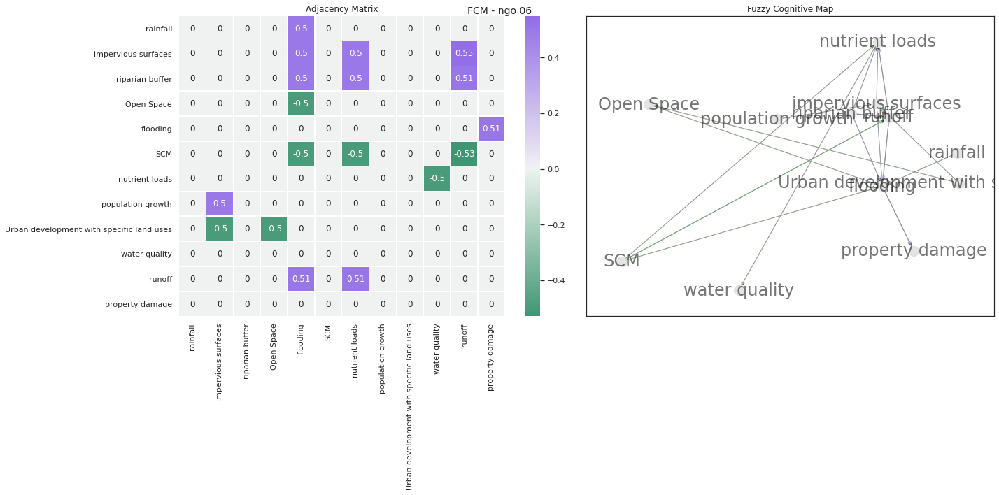

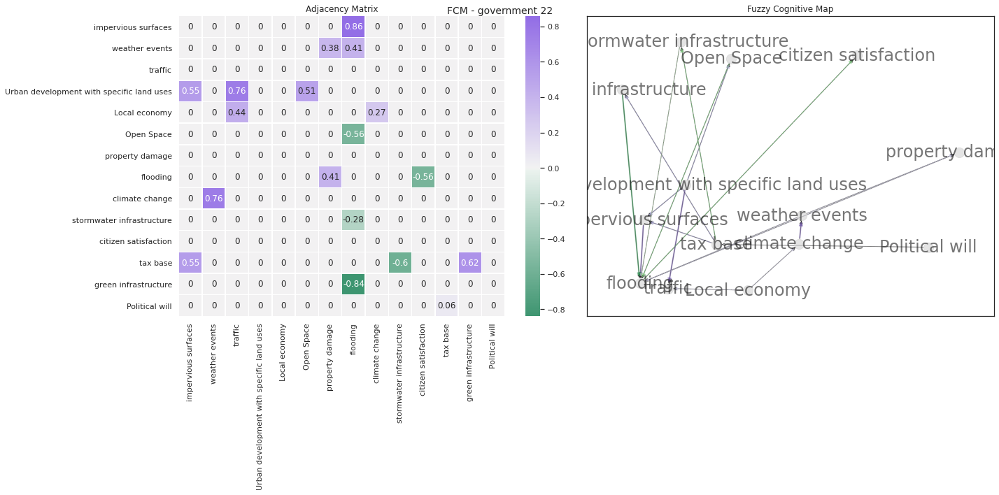

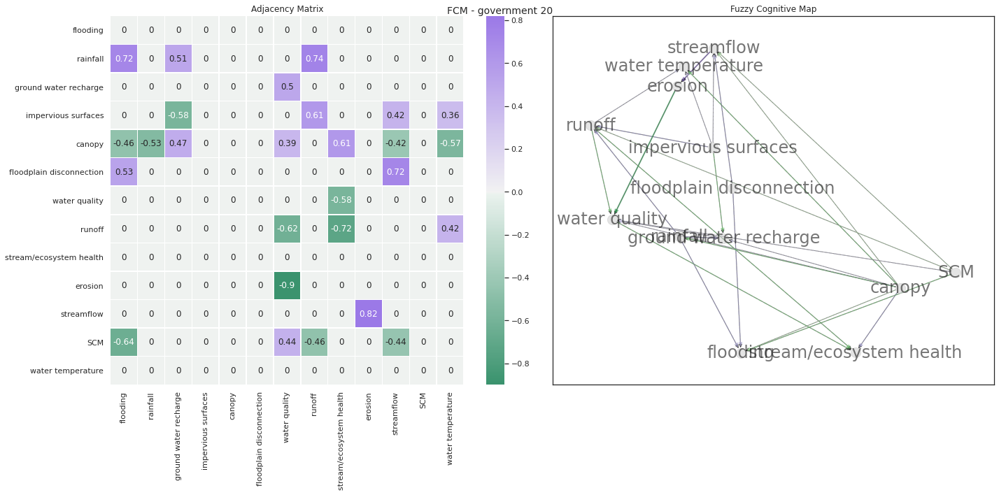

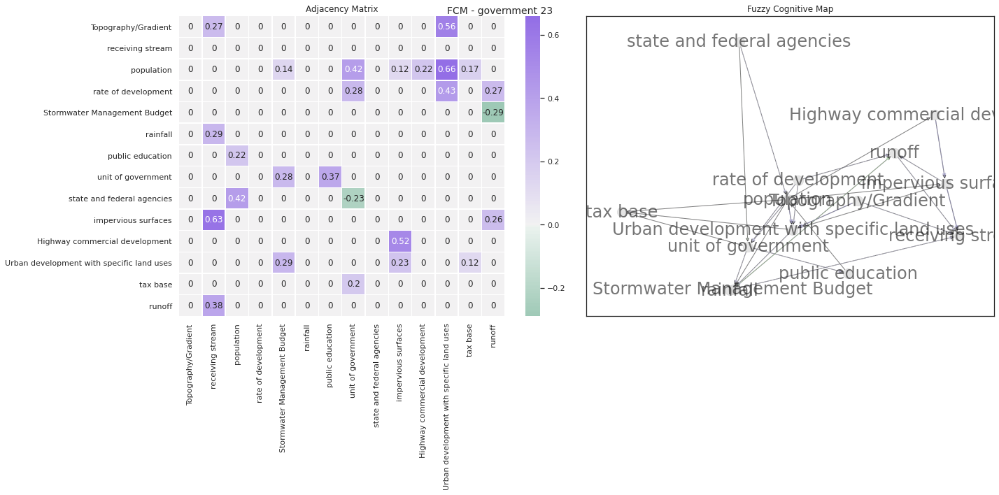

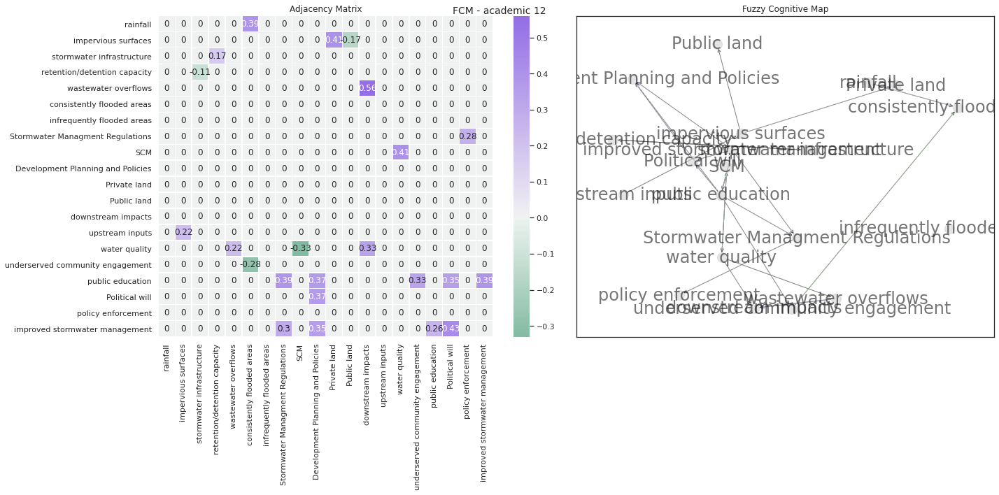

...

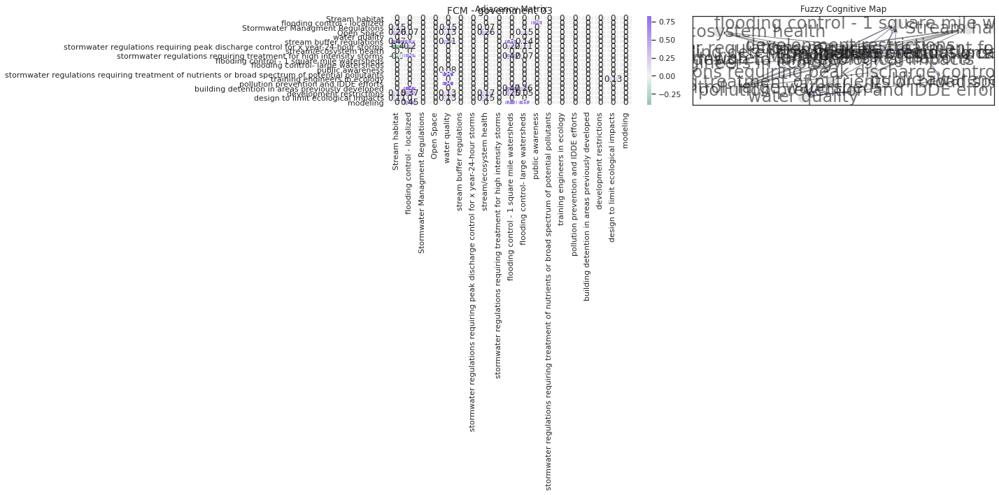

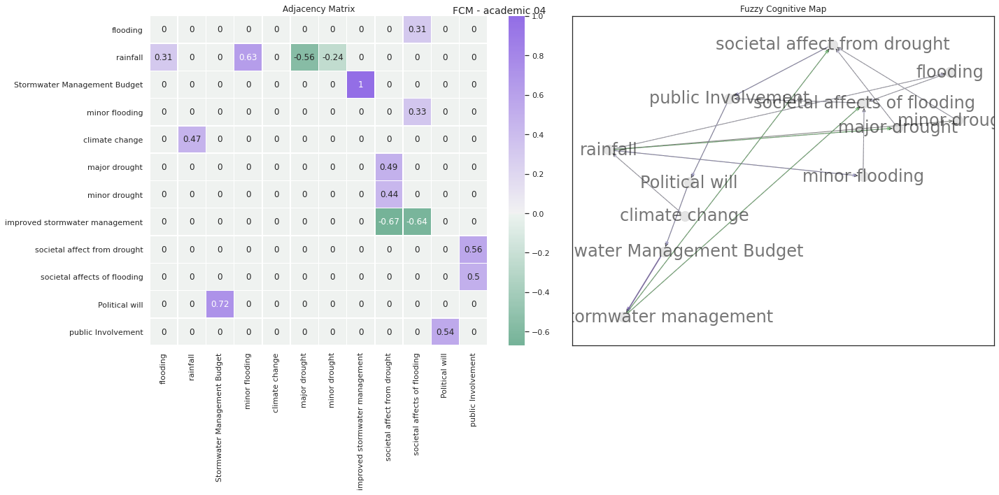

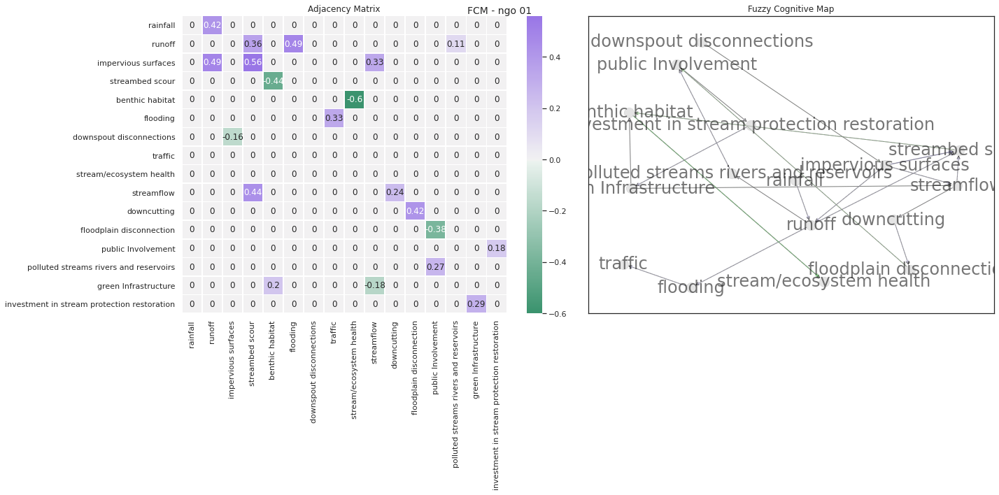

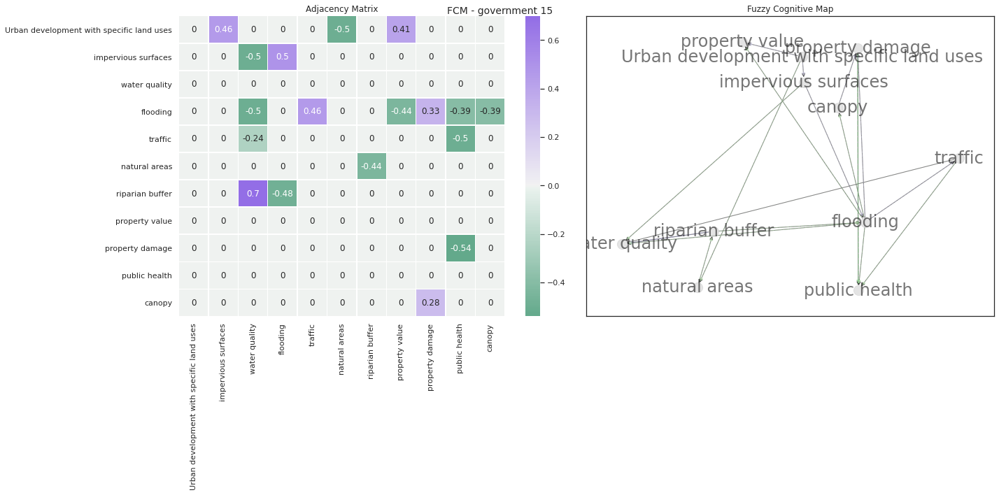

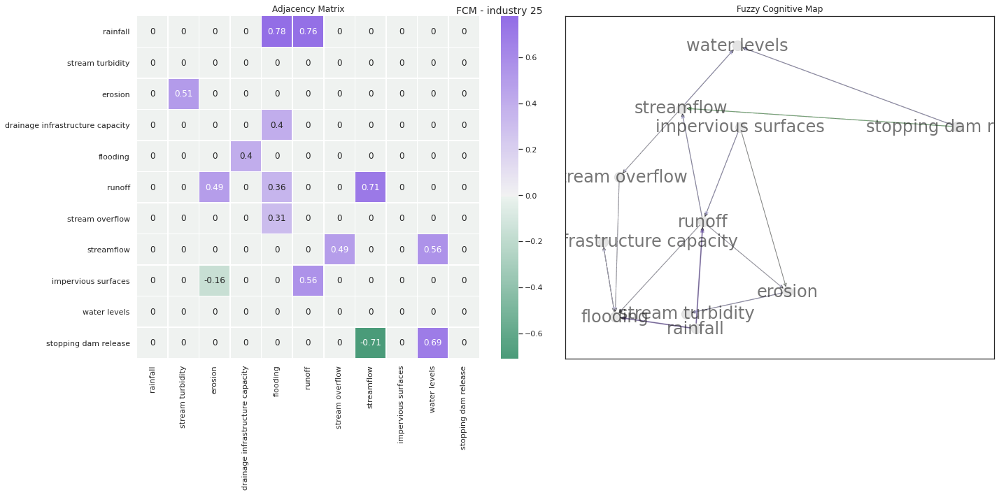

In [30]:
df_graph_stats_data = []  
cmap = sns.diverging_palette(150, 275, s=80, l=55, n=9, as_cmap=True)
All_ADJs =[]
all_data_frames = pd.DataFrame(columns=df_concepts['code'].unique(), index=df_concepts['code'].unique()).fillna(0)
for root, dirs, files in os.walk(data_location, topdown=False):
    for name in files:
        if "allFCMs" not in name and name != ".DS_Store":
            file_location = os.path.join(root, name)
            participant_organization = name.split("_")[-1].split('.')[0]
            participant_number = name.split("_")[0]
            df = pd.read_excel(file_location,index_col=0).fillna(0)
            
            df.columns = df.columns.map(concept_map)
            df.index = df.index.map(concept_map)
            print("FCMs", "%sFCM - %s - %d" % (name, participant_organization, len(All_ADJs)))
            print(df.shape)
            # print(df.head())
            print(all_data_frames.columns)
            # Take the value if it's not zero
            take_not_zero = lambda s1, s2: s1 if s1.sum() != 0 else s2

            df_copy = all_data_frames.combine(df, take_not_zero, fill_value=0, overwrite=True)
            
            # print(all_data_frames.columns)
            # print(df_copy.columns)
            # Add matric to list
            # All_ADJs.append(df_copy.values)
            All_ADJs.append(df_copy.loc[all_data_frames.columns,all_data_frames.columns].values)


            fig, (ax, ax1) = plt.subplots(1,2,figsize=(20,10))
            plt.suptitle('FCM - %s %s' % (participant_organization, participant_number), fontsize=14)
            ax.set_title("Adjacency Matrix", fontsize=12)

            sns.heatmap(df, annot=True, linewidths=.5, ax=ax, center=0,cmap=cmap)
            graph_stats = generate_map(df.values, df.columns, ax1)
            ax1.set_title("Fuzzy Cognitive Map", fontsize=12)
            graph_stats['type'] = participant_organization
            plt.tight_layout()
            save_path = os.path.join(save_location, "FCMs", "FCM - %s - %s" % (participant_organization, participant_number))
            plt.savefig(save_path)
            df_graph_stats_data.append(graph_stats)
            
df_graph_stats = pd.DataFrame(df_graph_stats_data)  



## Function reportNodeType(nodeType, valueList)

In [31]:
def reportNodeType(nodeType, valueList):
  df = pd.DataFrame({nodeType: valueList})
  df['components'] = df[nodeType] #.map(concept_map)
  components_count = len(df['components'].unique())
  fig,ax= plt.subplots(figsize=(15, 15))
  pal = sns.cubehelix_palette(56, rot=-.25, light=.7, reverse=True)
  sns.countplot(x="components", data=df, ax=ax, order = df['components'].value_counts().index, dodge=False, palette=pal, orient='h')
  plt.xticks(rotation=90)
  plt.ylabel('Count', size = 20)
  plt.xlabel('{} Components'.format(nodeType.upper()), size = 20)
  plt.yticks(size = 15)
  plt.xticks(size = 15)
  ax.set_title(("FCM {} Components (n = {})".format(nodeType.upper(),components_count)), fontsize=30)
  plt.tight_layout()

  plt.savefig(os.path.join(save_location, "FCM {} Components".format(nodeType.upper())),bbox_inches="tight")


## Transmitter Components

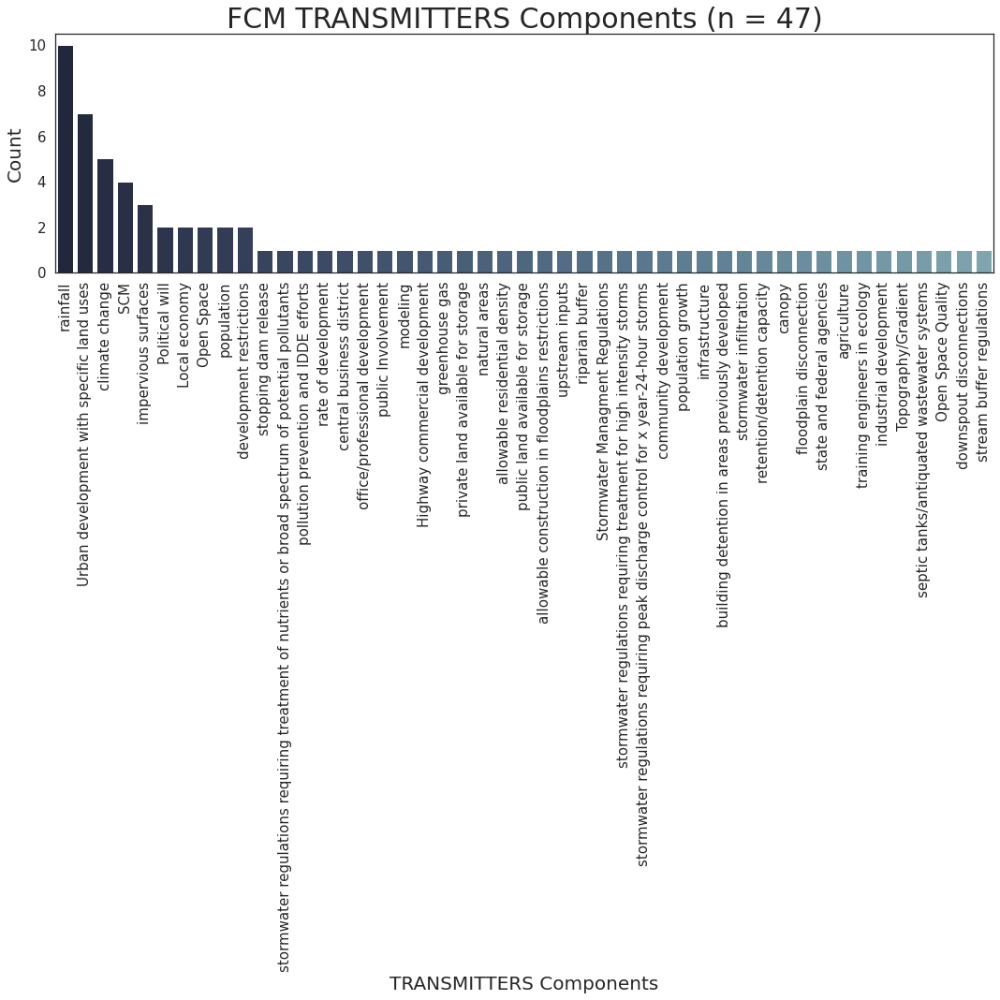

In [32]:
reportNodeType("transmitters", total_transmitters)

## Reciever Components

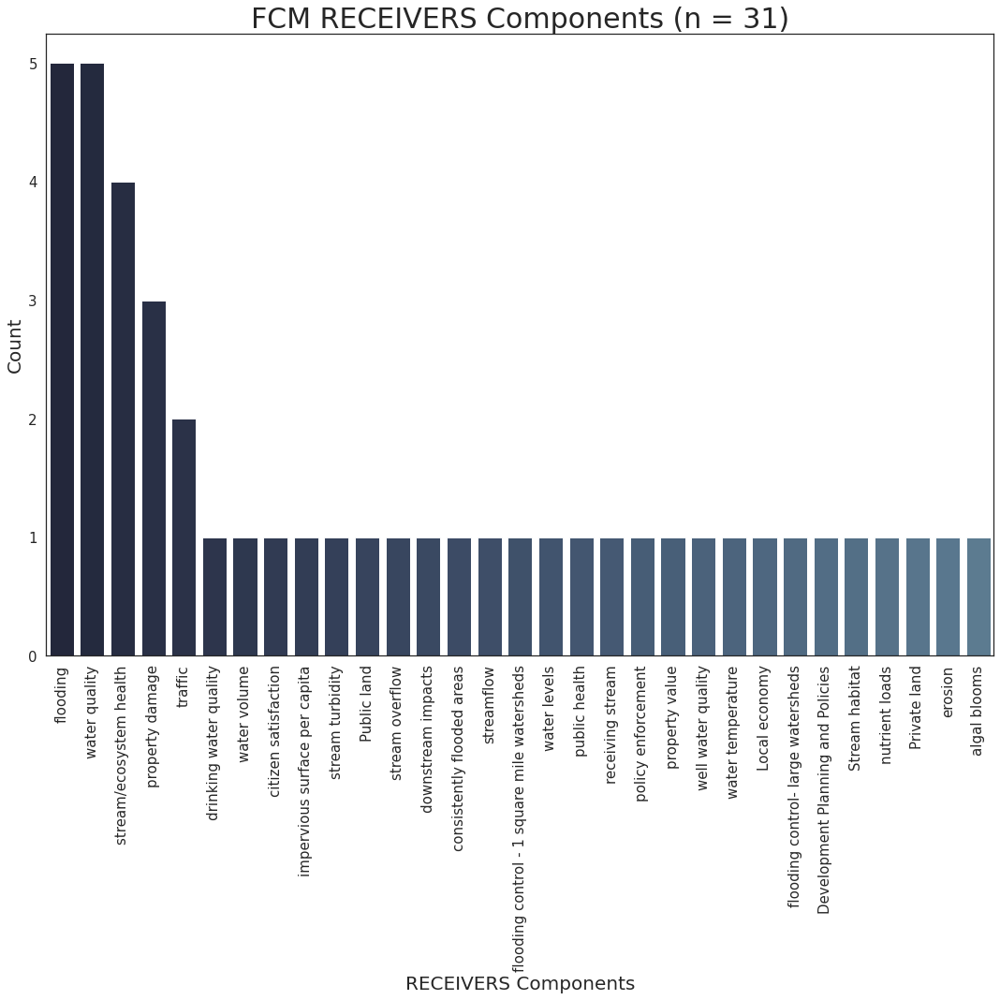

In [33]:
reportNodeType("receivers", total_recievers)



## Central Components

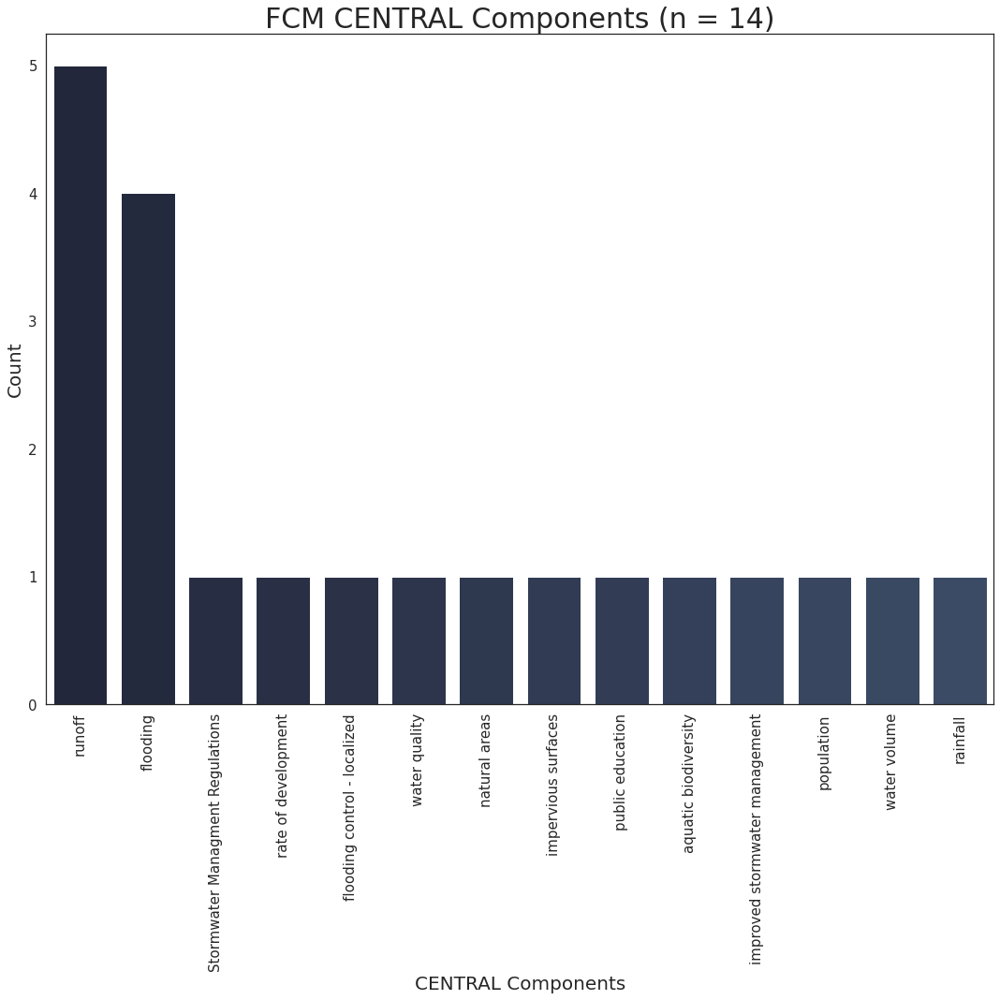

In [34]:
reportNodeType("central", central_nodes)

# Comparing Stakeholder Groups by FCM Indices

## Pair Grid of Graph indices by Stakeholder Group

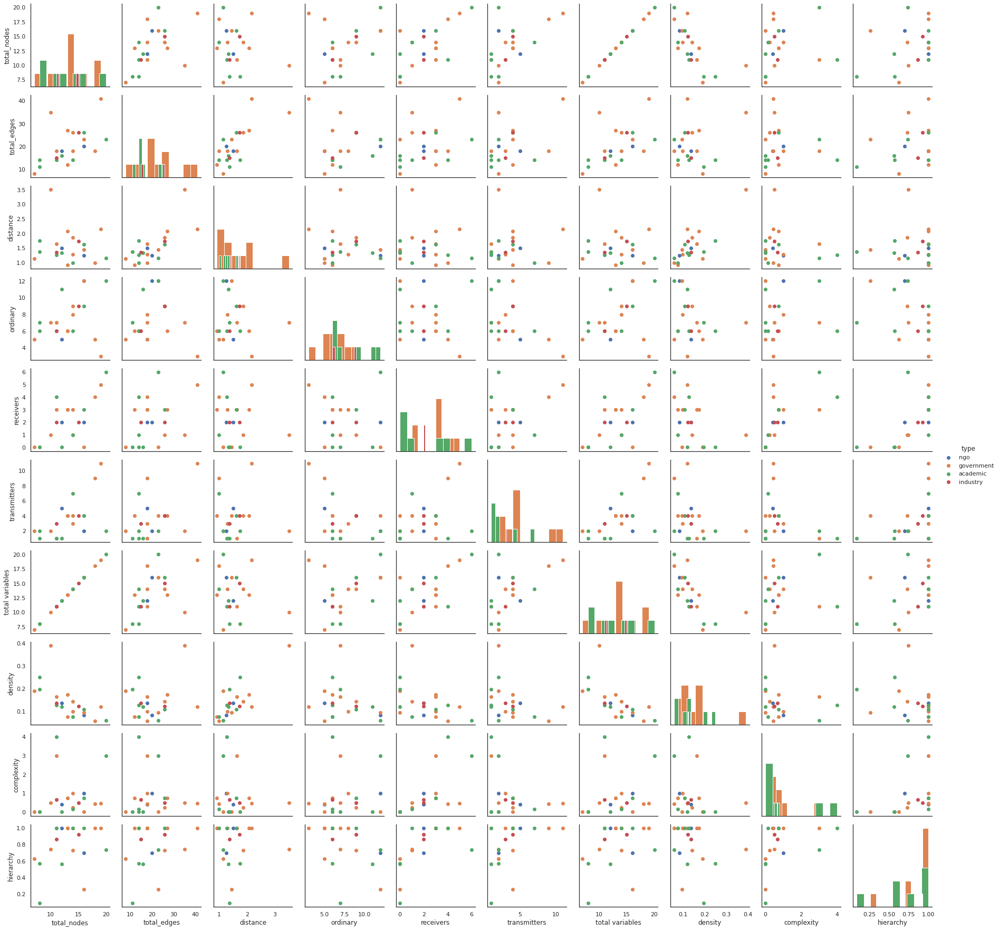

In [38]:
g = sns.PairGrid(df_graph_stats, hue="type")
g = g.map_diag(plt.hist)
g = g.map_offdiag(plt.scatter)
g = g.add_legend()

## Histograms

          type  variable  value
0          ngo  ordinary    5.0
1   government  ordinary    8.0
2   government  ordinary    6.0
3   government  ordinary    9.0
4     academic  ordinary   12.0
5     academic  ordinary    6.0
6     academic  ordinary    6.0
7     academic  ordinary    9.0
8     academic  ordinary    6.0
9     academic  ordinary    7.0
10  government  ordinary   12.0
11  government  ordinary    5.0
12  government  ordinary    7.0
13  government  ordinary    5.0
14    industry  ordinary    9.0
15  government  ordinary    6.0
16  government  ordinary    3.0
17    academic  ordinary   11.0
18         ngo  ordinary   12.0
19  government  ordinary    7.0


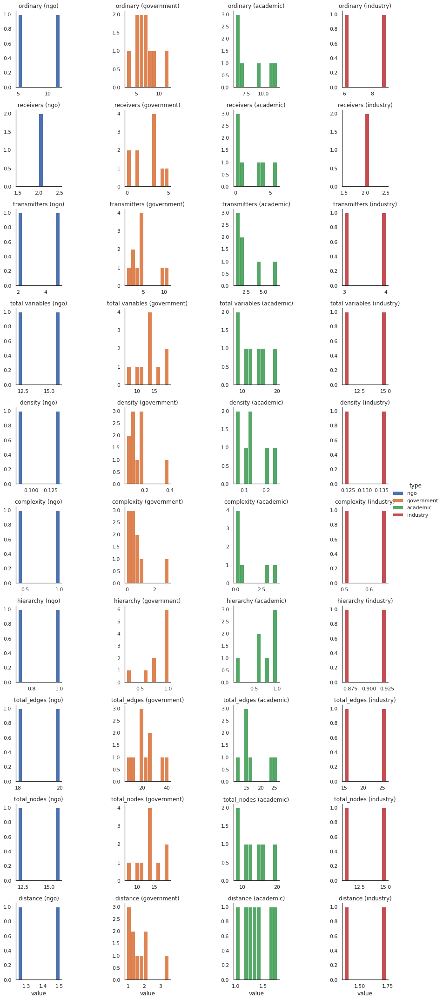

In [36]:
df_graph_stats_tp = df_graph_stats.copy().melt(id_vars=['type'], value_vars=['ordinary', 'receivers', 'transmitters','total variables', 'density', 'complexity', 'hierarchy','total_edges', 'total_nodes', 'distance'])
print(df_graph_stats_tp.head(20))
df_graph_stats_tp['log'] = df_graph_stats_tp['value']
g= sns.FacetGrid(df_graph_stats_tp, col="type", row="variable",sharey=False, sharex=False, hue="type")
g = g.map(plt.hist, "value").set_titles("{row_name} ({col_name})").add_legend()

## Box Plots

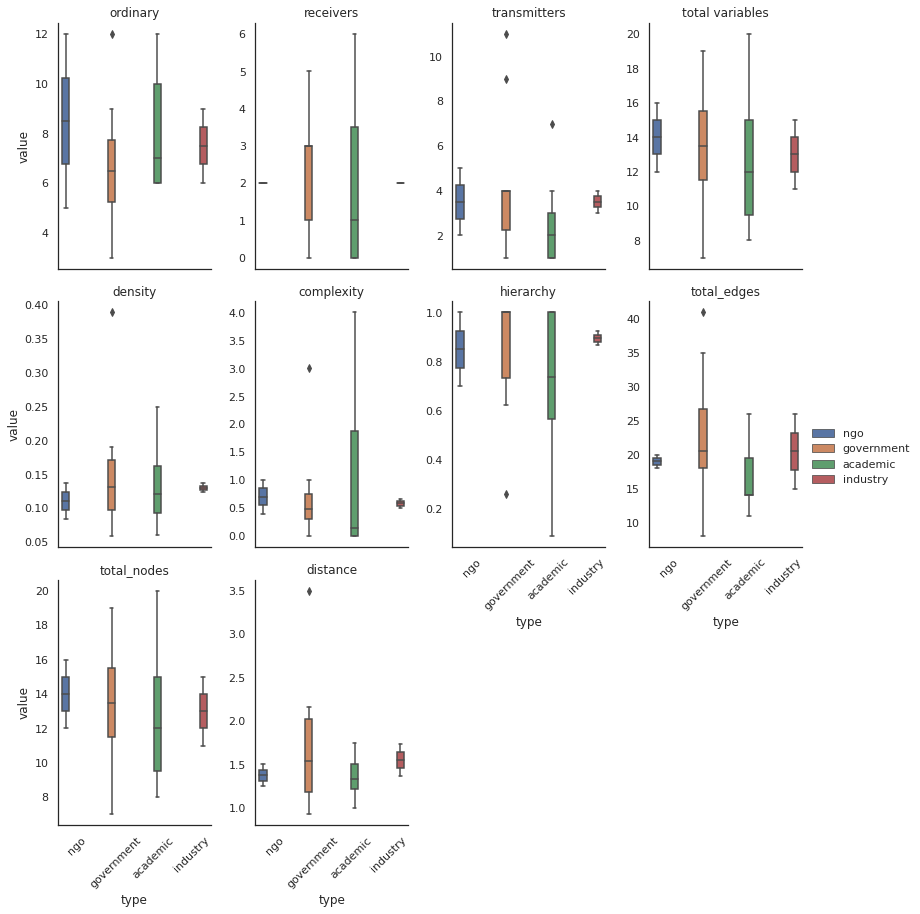

In [39]:
g = sns.catplot(x="type", y="value",
                hue="type", col="variable",
                data=df_graph_stats_tp, kind="box", orient="v",
                height=4, aspect=.7,sharey=False,col_wrap=4,).add_legend().set_titles("{col_name}")
g.set_xticklabels(labels=df_graph_stats_tp['type'].unique(), rotation=45)
plt.savefig(os.path.join(save_location, "FCM Statistics by Stakeholder Group"), orientation="landscape")

### Complexity (Receivers/transmitters) = R/T

> REWRITE IN OWN WORDS

* Large amount of receivers = FCM conciders many outcomes and situtations that result from the system
* Large amount of transmitters = Top down influencers (hierarchical system), flattens where causal arguments are not well elaborated

Complex maps have a large ratio because they define more utility outcomes and less controlling forcing functions. 

### Hierarchy

Graph hierarchy ranges from zero to one graphs with a vaule of one are hierarchical while graphs with a value of zero are democratic (MacDonald, 1983; Özesmi and Özesmi, 2004). The graphs produced by stakeholders during the workshop are hierarchacl, which can be interpreded that stakeholders beleive that stormwater management practices in the Triangle, NC are not easy to modify (Sandell, 1996; Özesmi and Özesmi, 2004). 

## Summary Statistics

In [40]:
df_graph_stats_tp.groupby(["variable"])['value'].describe()

,count,mean,std,min,25%,50%,75%,max
variable,,,,,,,,
complexity,21.0,0.838501,1.107119,0.000000,0.142857,0.500000,0.750000,4.000000
density,21.0,0.139517,0.074619,0.058824,0.095833,0.123810,0.163636,0.388889
distance,21.0,1.541453,0.562013,0.923077,1.250000,1.375000,1.733333,3.500000
hierarchy,21.0,0.800629,0.262116,0.090909,0.700000,0.923077,1.000000,1.000000
ordinary,21.0,7.476190,2.581067,3.000000,6.000000,7.000000,9.000000,12.000000
receivers,21.0,2.142857,1.740279,0.000000,1.000000,2.000000,3.000000,6.000000
total variables,21.0,13.238095,3.548306,7.000000,11.000000,13.000000,16.000000,20.000000
total_edges,21.0,20.142857,8.045407,8.000000,14.000000,18.000000,26.000000,41.000000
total_nodes,21.0,13.238095,3.548306,7.000000,11.000000,13.000000,16.000000,20.000000


## Skew

In [41]:
df_graph_stats_tp.groupby(["variable"])['value'].skew()

variable
complexity         1.955996
density            2.040184
distance           2.238668
hierarchy         -1.430374
ordinary           0.570129
receivers          0.450652
total variables    0.095067
total_edges        0.985643
total_nodes        0.095067
transmitters       1.526867
Name: value, dtype: float64

## Summary Statistics by Stakeholder Group

In [42]:
df_graph_stats_tp.groupby(["type","variable"])['value'].describe()

count       mean  ...        75%        max
type       variable                           ...                      
academic   complexity         7.0   1.127551  ...   1.875000   4.000000
           density            7.0   0.134385  ...   0.161851   0.250000
           distance           7.0   1.358009  ...   1.500000   1.750000
           hierarchy          7.0   0.709138  ...   1.000000   1.000000
           ordinary           7.0   8.142857  ...  10.000000  12.000000
           receivers          7.0   2.000000  ...   3.500000   6.000000
           total variables    7.0  12.714286  ...  15.000000  20.000000
           total_edges        7.0  16.857143  ...  19.500000  26.000000
           total_nodes        7.0  12.714286  ...  15.000000  20.000000
           transmitters       7.0   2.571429  ...   3.000000   7.000000
government complexity        10.0   0.714899  ...   0.750000   3.000000
           density           10.0   0.150930  ...   0.170717   0.388889
           distance          10.0   1.701747  ...   2.021978   3.500000
           hierarchy         10.0   0.835950  ...   1.000000   1.000000
           ordinary          10.0   6.800000  ...   7.750000  12.000000
           receivers         10.0   2.300000  ...   3.000000   5.000000
           total variables   10.0  13.500000  ...  15.500000  19.000000
           total_edges       10.0  22.600000  ...  26.750000  41.000000
           total_nodes       10.0  13.500000  ...  15.500000  19.000000
           transmitters      10.0   4.400000  ...   4.000000  11.000000
industry   complexity         2.0   0.583333  ...   0.625000   0.666667
           density            2.0   0.130087  ...   0.133225   0.136364
           distance           2.0   1.548485  ...   1.640909   1.733333
           hierarchy          2.0   0.894872  ...   0.908974   0.923077
           ordinary           2.0   7.500000  ...   8.250000   9.000000
           receivers          2.0   2.000000  ...   2.000000   2.000000
           total variables    2.0  13.000000  ...  14.000000  15.000000
           total_edges        2.0  20.500000  ...  23.250000  26.000000
           total_nodes        2.0  13.000000  ...  14.000000  15.000000
           transmitters       2.0   3.500000  ...   3.750000   4.000000
ngo        complexity         2.0   0.700000  ...   0.850000   1.000000
           density            2.0   0.109848  ...   0.123106   0.136364
           distance           2.0   1.375000  ...   1.437500   1.500000
           hierarchy          2.0   0.850000  ...   0.925000   1.000000
           ordinary           2.0   8.500000  ...  10.250000  12.000000
           receivers          2.0   2.000000  ...   2.000000   2.000000
           total variables    2.0  14.000000  ...  15.000000  16.000000
           total_edges        2.0  19.000000  ...  19.500000  20.000000
           total_nodes        2.0  14.000000  ...  15.000000  16.000000
           transmitters       2.0   3.500000  ...   4.250000   5.000000

[40 rows x 8 columns]

# ANOVA

## Samples

In [43]:
#https://www.pythonfordatascience.org/anova-python/

import scipy.stats as stats
print(df_graph_stats.head(20))

academic_sample = df_graph_stats[df_graph_stats['type'] == 'academic']#.sample(n=7)
government_sample = df_graph_stats[df_graph_stats['type'] == 'government']#.sample(n=7)

    total_nodes  total_edges  distance  ...  complexity  hierarchy        type
0            12           18  1.500000  ...    0.400000   1.000000         ngo
1            14           18  1.285714  ...    1.000000   1.000000  government
2            13           27  2.076923  ...    0.750000   1.000000  government
3            14           26  1.857143  ...    0.250000   0.730769  government
4            20           23  1.150000  ...    3.000000   0.739130    academic
5             8           14  1.750000  ...    0.000000   0.571429    academic
6            11           14  1.272727  ...    4.000000   1.000000    academic
7            16           26  1.625000  ...    0.750000   1.000000    academic
8            14           14  1.000000  ...    0.142857   1.000000    academic
9             8           11  1.375000  ...    0.000000   0.090909    academic
10           16           23  1.437500  ...    0.000000   0.260870  government
11            7            8  1.142857  ...    0.000

## Function: calcAnova

In [44]:
def calcAnova(variable):
  academic_sample = df_graph_stats[df_graph_stats['type'] == 'academic']#.sample(n=7)
  government_sample = df_graph_stats[df_graph_stats['type'] == 'government']
  print('#' * 75)
  print("{}".format(variable))
  shapiro_test = stats.shapiro(df_graph_stats[df_graph_stats['type'].isin(['government', 'academic'])][variable])
  print("Shapiro Test: {}".format(shapiro_test))
  shapiro_test_academic = stats.shapiro(academic_sample[variable])
  print("Academic Shapiro Test: {}".format(shapiro_test_academic))
  shapiro_test_government = stats.shapiro(government_sample[variable])
  print("Government Shapiro Test: {}".format(shapiro_test_government))
  #The test rejects the hypothesis of normality when the p-value is less than or equal to 0.05.
  #Accept Null Hypothesis
 
  print("pvalue={} <= {} equals {}".format(shapiro_test[1],0.05, shapiro_test[1] <= 0.05))
  if shapiro_test[1] > 0.05:
    print("Accept Hypo Null thesis: Normal")
    print("Use ANOVA")
    print(stats.f_oneway(academic_sample[variable], government_sample[variable]))
  # Reject Null Hypothesis
  else:
    print("Rejected Null Hypothesis")
    print("Mann–Whitney Test")
    # variable_log = variable+'_log'
    
    # df_graph_stats[variable_log]= df_graph_stats[variable].apply(lambda x: np.log10(x))
    # shapiro_test = stats.shapiro(df_graph_stats[df_graph_stats['type'].isin(['government', 'academic'])][variable_log])
    # academic_sample[variable_log] = academic_sample[variable].apply(lambda x: np.log10(x))
    # government_sample[variable_log] = government_sample[variable].apply(lambda x: np.log10(x))
    # print("Shapiro Test Log10: {}".format(shapiro_test))

    print(stats.mannwhitneyu(academic_sample[variable], government_sample[variable]))



In [45]:
cols=['complexity','hierarchy','distance','density','ordinary','transmitters','receivers','total_edges','total_nodes' ]
for i in cols:
  calcAnova(i)


###########################################################################
complexity
Shapiro Test: (0.7138159275054932, 0.00016647660231683403)
Academic Shapiro Test: (0.7373476624488831, 0.009341271594166756)
Government Shapiro Test: (0.7168773412704468, 0.0014114206423982978)
pvalue=0.00016647660231683403 <= 0.05 equals True
Rejected Null Hypothesis
Mann–Whitney Test
MannwhitneyuResult(statistic=31.5, pvalue=0.38309560546840726)
###########################################################################
hierarchy
Shapiro Test: (0.7771285176277161, 0.001002142089419067)
Academic Shapiro Test: (0.8516150712966919, 0.1271468847990036)
Government Shapiro Test: (0.7285563945770264, 0.0019568742718547583)
pvalue=0.001002142089419067 <= 0.05 equals True
Rejected Null Hypothesis
Mann–Whitney Test
MannwhitneyuResult(statistic=26.0, pvalue=0.18454404993925)
###########################################################################
distance
Shapiro Test: (0.8111581802368164, 0.00289719016291

# Graph Functions

## Function: remove_orphan_nodes

In [46]:
def remove_orphan_nodes(df_matrix):
  drop_list = []
  for i in df_matrix.index:
    if df_matrix[i].sum(axis = 0, skipna = True) == 0 and df_matrix.loc[i].sum(axis = 0, skipna = True) == 0:
      drop_list.append(i)
  return df_matrix.drop(columns=drop_list, index=drop_list)

## Function: remove_weak_connections

In [47]:
def remove_weak_connections(df_matrix, threshold=0.0):
  import statistics 

  drop_list = []
  weight_list = []
  #Get weight and set threashold
  #Set all edges with weights under 0.25 to 0
  for i in df_matrix.index:
    for c in df_matrix.columns:
      weight_list.append(df_matrix.loc[i,c])

  df_weight = pd.DataFrame({'weights': weight_list})
  sns.histplot(df_weight, color="skyblue", kde=False, bins=5, stat='density')
  # statistics.mean(weight_list) + (statistics.stdev(weight_list) * 2)
  _mean = statistics.mean(weight_list)
  print("Mean: {}".format(_mean))
  # print("Geometric Mean: {}".format(statistics.geometric_mean(weight_list)))
  print("Median: {}".format(statistics.median(weight_list)))
  _std = statistics.stdev(weight_list)
  print("Std: {}".format(_std))
  # print("Quantiles: {}".format(statistics.Quantiles(weight_list, n=10)))
  high_threshold= _mean + 3 * _std
  print("High Threshold: {}".format(high_threshold))
  low_threshold = _mean - 3 * _std
  print("Low Threshold: {}".format(low_threshold))
  for i in df_matrix.index:
    for c in df_matrix.columns:
      # zscore = (df_matrix.loc[i,c] - _mean)/_std
      # if abs(zscore) <= 3:
      # if df_matrix.loc[i,c] < low_threshold or df_matrix.loc[i,c] > high_threshold:
      if abs(df_matrix.loc[i,c]) < threshold:
        df_matrix.loc[i,c] = 0
  # Remove Nodes that no longer have any connections
  for i in df_matrix.index:
    if df_matrix[i].sum(axis = 0, skipna = True) == 0 and df_matrix.loc[i].sum(axis = 0, skipna = True) == 0:
      drop_list.append(i)
  return df_matrix.drop(columns=drop_list, index=drop_list)

## Function: Aggregate_mean

In [48]:
def aggregate_mean(adj_matrices, concepts, zeros="M", verbose=False):
    """Aggregates arithmatic mean of adjacency matrices.
    
    :param adj_matrices: List of FCM adjaceny matrices.
    :param concepts: List of variable names used to label graph adjaceny matrix.
    :param zeros: Determines if zeros are included in arithmatic mean calculation.
    
    :return: np.array of the arithmatic mean of adjacency matrices.
    """
    # adj_matrices = np.array([
    #                          [[2.,2.,0.],[0.,2.,0.],[2.,2.,0.]],
    #                          [[2.,2.,5.],[-2.,2.,-5.],[2.,2.,-5.]],
    #                          [[5.,5.,5.],[5.,5.,-5.],[0.,0.,5.]],
    #                          [[5.,5.,5.],[5.,5.,-5.],[5.,5.,5.]]
    # ]
    # )
    # concepts =["c1", "c2", "c3"]
    # print("Adjecency Matrixs: {}".format(adj_matrices))
    

    from functools import reduce
    from statistics import mean as mean
    from statistics import median as med
    n_concepts = len(concepts)
    # print(concepts)
    print("Number of Maps: {}".format(len(adj_matrices)))
    print("Number of Concepts: {}".format(n_concepts))

    count = np.zeros((n_concepts,n_concepts))
    # print("Zeros Matrix: {}".format(count))



    adj_ag = np.zeros((n_concepts,n_concepts))
    # print(adj_ag)
    #Create matrix of the sums of all adjecency matricies
    adj = (reduce((lambda x, y: x + y), adj_matrices))
    # print("Sum Matrix: {}".format(adj))
    adj_copy = np.copy(adj)   


    
    if zeros == "M":
      if verbose:
        print("Calculating Mean")
      for row in range (n_concepts):
          for col in range (n_concepts):
              a = [ind[row,col] for ind in adj_matrices]
              adj_ag[row,col] = mean(a)
    elif zeros == "MED":
      
      if verbose:
        print("Calculating Median")
      for row in range (n_concepts):
          for col in range (n_concepts):
              a = [ind[row,col] for ind in adj_matrices]
              adj_ag[row,col] = med(a)
    elif zeros == 'WM':
      if verbose:
        print("Calculating Weighted Mean")
      weighted_weight = np.zeros((n_concepts,n_concepts))
      for fcm in adj_matrices:
        for row in range (n_concepts):
          for col in range (n_concepts):
            if fcm[row,col] != 0:
              count[row,col] +=1

      # print("Count Matrix: {}".format(count))
      for row in range (n_concepts):
        for col in range (n_concepts):
            n_maps = len(adj_matrices) # Number of maps
            w = count[row,col]
            s = adj_copy[row,col] # Sum Matrix
            adj_ag[row,col] = (s * w)/ n_maps
            # adj_ag[row,col] = adj_copy[row,col]/len(adj_matrices)

      # np.average()
    else:
        #Creates a variable frequency matrix. 
        for fcm in adj_matrices:
            for row in range (n_concepts):
                for col in range (n_concepts):
                    if fcm[row,col] != 0:
                        count[row,col] +=1

        #Calculates the mean of all matrices by not including zero values.
        for row in range (n_concepts):
            for col in range (n_concepts):
                if count[row,col] == 0:
                    adj_ag[row,col] = 0
                else:
                    adj_ag[row,col] = adj_copy[row,col]/count[row,col]
    # print("Agg Matrix: {}".format(adj_ag))
    return adj_ag
    

## Function: CombineAdjecencyMatrix

In [53]:
def combineAdjacencyMatrix(filtered_concepts,filter=""):
    """
    Combines individual FCMs into a single FCM with all values
    :param filtered_concepts
    :param filter: String (academic, government, ngo, industry, None)
    """
    All_ADJs =[]
    all_data_frames = pd.DataFrame(columns=filtered_concepts, index=filtered_concepts).fillna(0)
    for root, dirs, files in os.walk(data_location, topdown=False):
        for name in files:
            if "allFCMs" not in name and filter in name and name != ".DS_Store":
                file_location = os.path.join(root, name)
                participant_organization = name.split("_")[-1].split('.')[0]
                df = pd.read_excel(file_location,index_col=0).fillna(0)

                df.columns = df.columns.map(concept_map)
                df.index = df.index.map(concept_map)
                # print("FCMs", "%sFCM - %s - %d" % (name, participant_organization, len(All_ADJs)))
                # print(df.shape)
                take_not_zero = lambda s1, s2: s1 if s1.sum() != 0 else s2
                df_copy = all_data_frames.combine(df, take_not_zero, fill_value=0)

                # take_larger = lambda s1, s2: s1 if s1.sum() > s2.sum() else s2
                # df_copy = all_data_frames.combine(df, take_larger, fill_value=0, overwrite=True)
                All_ADJs.append(df_copy.loc[filtered_concepts,filtered_concepts].values)

    return dict(graph_stats=pd.DataFrame(df_graph_stats_data), all_adj=All_ADJs) 

## Function fcmComponentCount

In [49]:
def fcmComponentCount(df_concepts, groupName):
  components_count = len(df_concepts['code'].unique())
  fig,ax= plt.subplots(figsize=(15, 10))
  pal = sns.cubehelix_palette(56, rot=-.25, light=.7, reverse=True)
  sns.countplot(x="code", data=df_gov_concepts,ax=ax, order = filtered_concepts_gov, dodge=False, palette=pal, orient='h')

  plt.xticks(rotation=90)
  plt.ylabel('Count', size = 20)
  plt.xlabel('Components Name', size = 20)
  plt.yticks(size = 15)
  plt.xticks(size = 13)
  ax.set_title(("{} FCM Components (n = {})".format(groupName,components_count)), fontsize=30)
  plt.tight_layout()
  plt.savefig(os.path.join(save_location, "combined_model_varibales_{}.png".format(components_count)), bbox_inches="tight")

## Function centralityGraph

In [50]:
def centralityGraph(fcm_stats, title=""):
  df_centrality = pd.DataFrame(fcm_stats['new_centrality']).sort_values(["centrality","out-degree"], ascending=False)

  f, ax = plt.subplots(figsize=(6, 10))
  # Plot the total crashes
  sns.set_color_codes("pastel")

  ax.set_title("Variable Centrality of {} Socail Cognitive Map".format(title), fontsize=20)

  sns.barplot(x="centrality", y="variable", data=df_centrality, label="In Degree", color="b")
  sns.set_color_codes("muted")
  sns.barplot(x="out-degree", y="variable", data=df_centrality, label="Out Degree", color="b")

  ax.legend(ncol=2, loc="lower right", frameon=True)
  ax.set(xlim=(0, 1.5), ylabel="",
        xlabel="Centrality of Features")
  sns.despine(left=True, bottom=True)
  plt.savefig(os.path.join(save_location, "{}_fcm_centrality.png".format(title)), bbox_inches="tight")

# All FCMs Social Cognitive Map (Mean)

Number of Maps: 21
Number of Concepts: 126
[(0, 4, {'weight': 0.2833333333333333}), (0, 6, {'weight': 0.01904761904761905}), (0, 9, {'weight': -0.014761904761904763}), (0, 10, {'weight': 0.2571428571428572}), (0, 21, {'weight': 0.024285714285714285}), (0, 26, {'weight': 0.006190476190476191}), (0, 29, {'weight': 0.013809523809523808}), (0, 37, {'weight': 0.004285714285714284}), (0, 39, {'weight': 0.018571428571428572}), (0, 41, {'weight': -0.024285714285714285}), (0, 50, {'weight': 0.029523809523809525}), (0, 51, {'weight': -0.006190476190476191}), (0, 52, {'weight': -0.011428571428571429}), (0, 55, {'weight': 0.02523809523809524}), (0, 56, {'weight': 0.023809523809523808}), (0, 57, {'weight': 0.015714285714285715}), (0, 58, {'weight': 0.02238095238095238}), (0, 66, {'weight': 0.0380952380952381}), (0, 82, {'weight': -0.029523809523809525}), (0, 111, {'weight': 0.03}), (0, 112, {'weight': -0.02666666666666667}), (0, 113, {'weight': -0.011428571428571429}), (1, 3, {'weight': -0.03428571

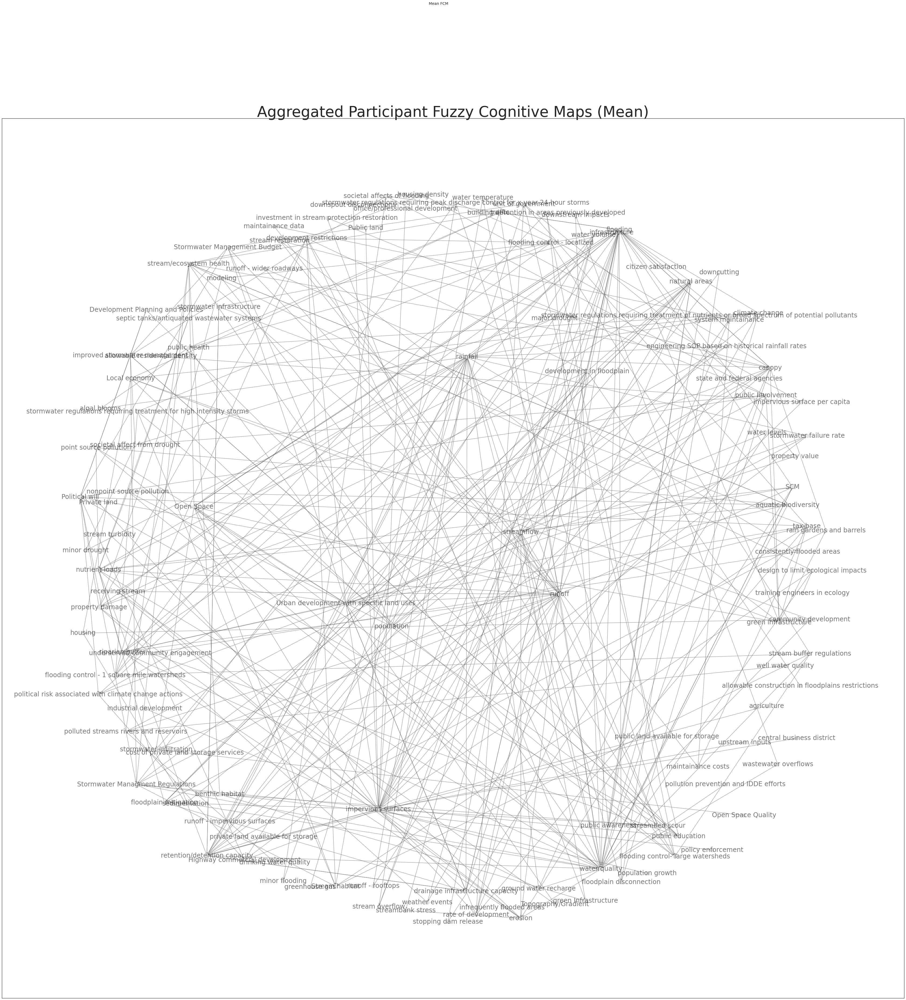

In [51]:
column_headers = df_concepts['code'].unique() #test_column_headers
      
Adj_aggregated_FCM = aggregate_mean(All_ADJs, column_headers, zeros='M')
fig, ax = plt.subplots(figsize=(60,60))
ax.set_title("Aggregated Participant Fuzzy Cognitive Maps (Mean)", fontsize=55)
df_agg_mean = pd.DataFrame(Adj_aggregated_FCM, index=column_headers, columns=column_headers)
df_agg_mean.to_csv(path_or_buf=os.path.join(save_location, "complete_mean_stakeholders_combined_fcm.csv"), index=True)
plt.suptitle('Mean FCM', fontsize=14)


stats= generate_map(Adj_aggregated_FCM, column_headers,ax)
print(stats)
plt.savefig(os.path.join(save_location, "allFCMsMeans.png"))

# All FCMs Social Cognitive Map filtered Concepts > 1 occurance

Number of Maps: 21
Number of Concepts: 43
Mean: 0.0012562775245306343
Median: 0.0
Std: 0.016770690713944388
High Threshold: 0.0515683496663638
Low Threshold: -0.04905579461730253
[(0, 5, {'weight': -0.023809523809523808}), (0, 7, {'weight': 0.15714285714285714}), (0, 9, {'weight': -0.01904761904761905}), (0, 16, {'weight': -0.018095238095238095}), (0, 17, {'weight': 0.06523809523809523}), (0, 19, {'weight': -0.018571428571428572}), (0, 28, {'weight': -0.0380952380952381}), (0, 30, {'weight': 0.01904761904761905}), (0, 34, {'weight': -0.018571428571428572}), (1, 0, {'weight': 0.08857142857142856}), (1, 3, {'weight': 0.29095238095238096}), (1, 5, {'weight': -0.023809523809523808}), (1, 6, {'weight': -0.02}), (1, 9, {'weight': -0.03428571428571429}), (1, 12, {'weight': 0.03571428571428571}), (1, 13, {'weight': -0.007619047619047619}), (1, 16, {'weight': -0.029523809523809525}), (1, 23, {'weight': 0.04904761904761905}), (1, 30, {'weight': -0.029047619047619048}), (1, 32, {'weight': 0.04761

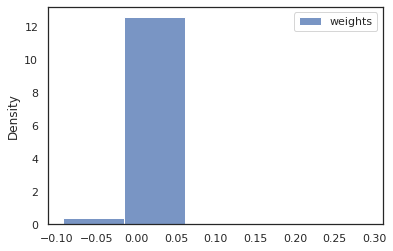

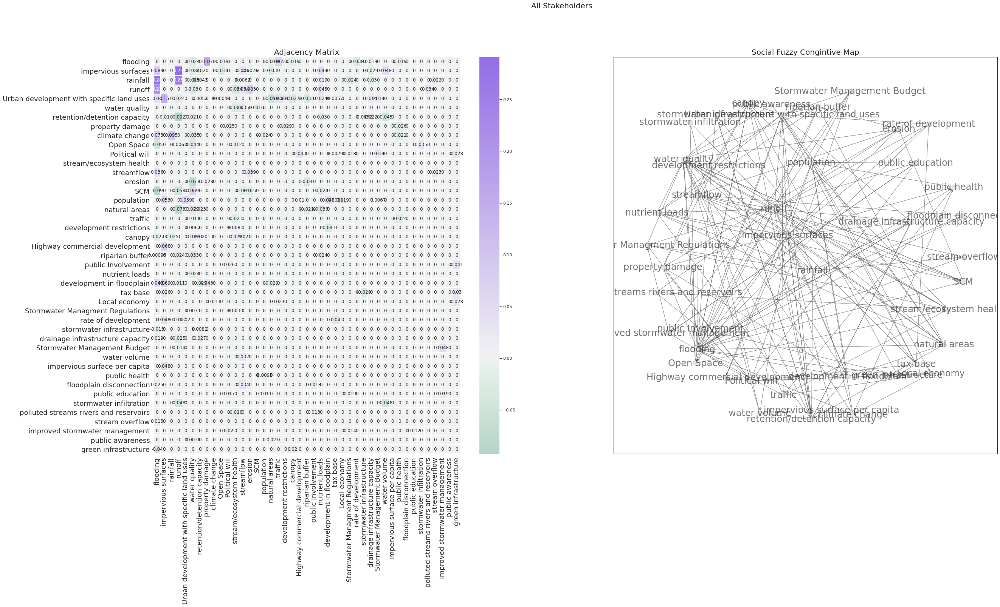

In [54]:
df_all_fcm_counts = df_concepts['code'].value_counts()
df_all_fcm_filtered_concepts = df_all_fcm_counts[df_all_fcm_counts > 1].index
all_fcms = combineAdjacencyMatrix(df_all_fcm_filtered_concepts, "")
all_fcm_adj_aggregated = aggregate_mean(all_fcms["all_adj"], df_all_fcm_filtered_concepts, zeros="M")

df_all_fcm_agg_mean= pd.DataFrame(all_fcm_adj_aggregated, index=df_all_fcm_filtered_concepts, columns=df_all_fcm_filtered_concepts)
df_all_fcm_agg_mean_reduced = remove_weak_connections(df_all_fcm_agg_mean, threshold=0.0) #0.045
df_all_fcm_agg_mean_reduced.to_csv(path_or_buf=os.path.join(save_location, "mean_stakeholders_combined_fcm_filtered_lt_1.csv"), index=True)

fig, (ax, ax1) = plt.subplots(1,2,figsize=(40,20))#w, h
plt.suptitle('All Stakeholders', fontsize=20)
ax.set_title("Adjacency Matrix", fontsize=20)
ax.set_xticklabels(ax.get_xmajorticklabels(), fontsize = 18)
ax.set_yticklabels(ax.get_ymajorticklabels(), fontsize = 18)
sns.heatmap(df_all_fcm_agg_mean_reduced.fillna(0), annot=True, linewidths=.5, ax=ax, center=0,cmap=cmap)
ax1.set_title("Social Fuzzy Congintive Map", fontsize=20)
fig.subplots_adjust(bottom=0.15)
all_fcm_stats = generate_map(df_all_fcm_agg_mean_reduced.to_numpy(), df_all_fcm_agg_mean_reduced.index,ax1)
# print(all_fcm_stats)
plt.savefig(os.path.join(save_location, "mean_fcm_no_weak_connections.png"),bbox_inches="tight")


### Centrality

In [55]:
df_all_fcm_centrality = pd.DataFrame(all_fcm_stats['new_centrality']).sort_values(["centrality","out-degree"], ascending=False)

df_all_fcm_centrality.head()

,variable,in-degree,out-degree,centrality
0,flooding,1.064286,0.377619,1.441905
3,runoff,0.936667,0.479048,1.415714
1,impervious surfaces,0.470952,0.656190,1.127143
2,rainfall,0.120000,0.660952,0.780952
5,water quality,0.470476,0.078095,0.548571


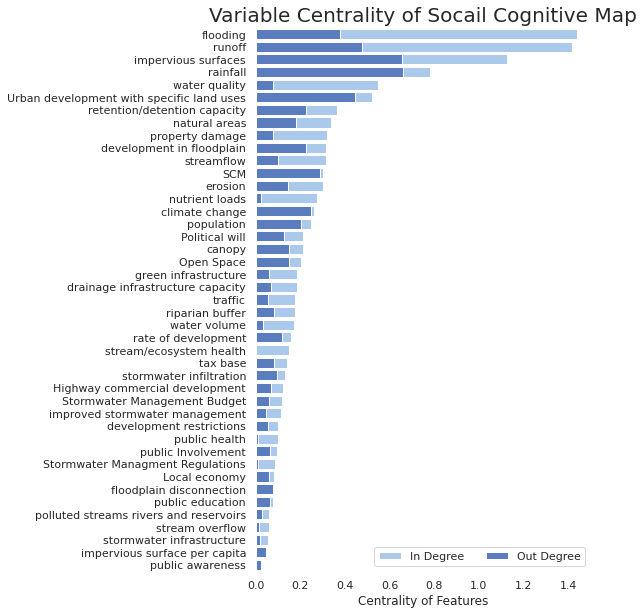

In [56]:
f, ax = plt.subplots(figsize=(6, 10))
# Plot the total crashes
sns.set_color_codes("pastel")

ax.set_title("Variable Centrality of Socail Cognitive Map", fontsize=20)

sns.barplot(x="centrality", y="variable", data=df_all_fcm_centrality, label="In Degree", color="b")
sns.set_color_codes("muted")
sns.barplot(x="out-degree", y="variable", data=df_all_fcm_centrality, label="Out Degree", color="b")

ax.legend(ncol=2, loc="lower right", frameon=True)
ax.set(xlim=(0, 1.5), ylabel="",
       xlabel="Centrality of Features")
sns.despine(left=True, bottom=True)
plt.savefig(os.path.join(save_location, "mean_fcm_centrality.png"), bbox_inches="tight")


# Government Stakeholder Mean FCM

In [57]:
df_gov_concepts = df_concepts[df_concepts["group"] == 'government']
df_gov_counts = df_gov_concepts['code'].value_counts()
filtered_concepts_gov = df_gov_counts[df_gov_counts > 1].index #df_counts.index
df_graph_stats_gov = combineAdjacencyMatrix(filtered_concepts_gov, "government")


## Aggregate Government Component Count

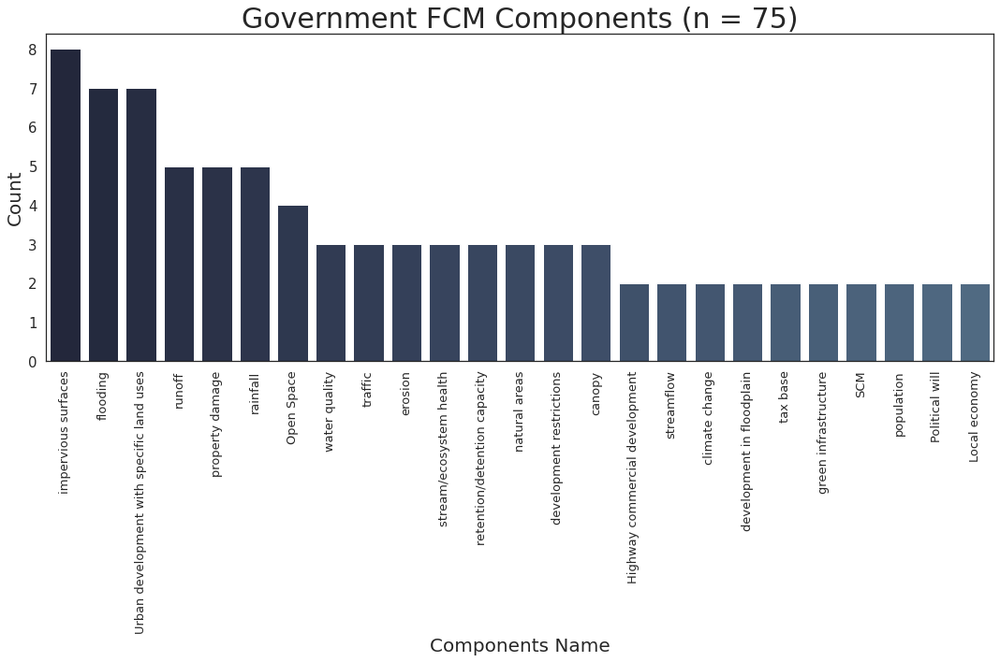

In [58]:
fcmComponentCount(df_gov_concepts, "Government")


## Government Stakeholder Mean FCM

Number of Maps: 10
Number of Concepts: 25
Mean: 0.0028352
Median: 0.0
Std: 0.032136927238111804
High Threshold: 0.09924598171433541
Low Threshold: -0.09357558171433542
[(0, 1, {'weight': 0.136}), (0, 3, {'weight': 0.287}), (0, 6, {'weight': -0.072}), (0, 7, {'weight': -0.05}), (0, 11, {'weight': -0.041999999999999996}), (0, 12, {'weight': -0.062}), (0, 16, {'weight': 0.041999999999999996}), (1, 4, {'weight': 0.279}), (1, 7, {'weight': -0.05}), (1, 8, {'weight': 0.104}), (1, 14, {'weight': -0.039}), (2, 0, {'weight': 0.29200000000000004}), (2, 1, {'weight': 0.08299999999999999}), (2, 3, {'weight': 0.051000000000000004}), (2, 6, {'weight': 0.051000000000000004}), (2, 8, {'weight': 0.076}), (2, 11, {'weight': 0.011}), (2, 12, {'weight': -0.121}), (2, 13, {'weight': 0.031}), (2, 14, {'weight': -0.05600000000000001}), (2, 19, {'weight': 0.012}), (3, 1, {'weight': 0.119}), (3, 7, {'weight': -0.062}), (3, 9, {'weight': 0.053000000000000005}), (3, 10, {'weight': -0.072}), (4, 13, {'weight': 0.

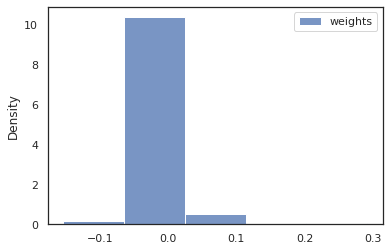

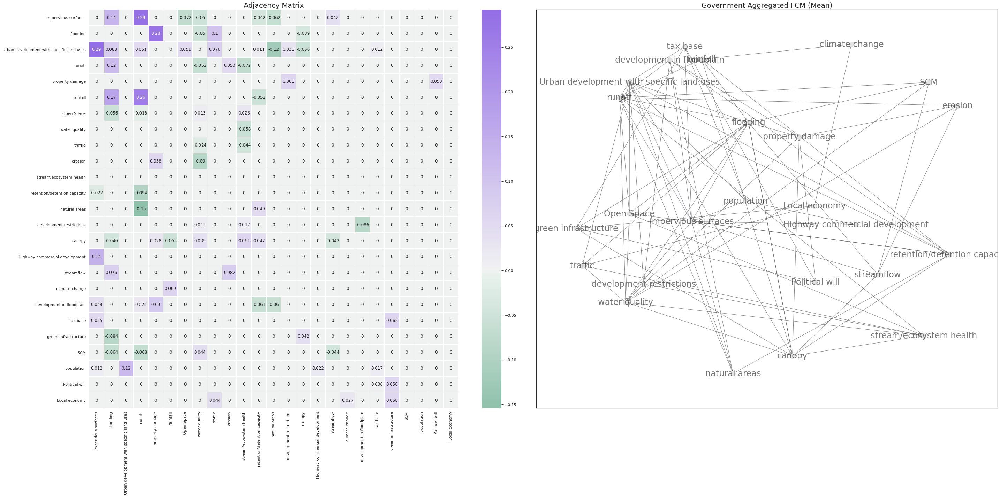

In [59]:
Adj_aggregated_FCM_gov = aggregate_mean(df_graph_stats_gov["all_adj"], filtered_concepts_gov,zeros="M")
df_agg_mean_gov = pd.DataFrame(Adj_aggregated_FCM_gov, index=filtered_concepts_gov, columns=filtered_concepts_gov)
df_agg_mean_reduced_gov = remove_weak_connections(df_agg_mean_gov, threshold=0.0)

df_agg_mean_reduced_gov.to_csv(path_or_buf=os.path.join(save_location, "mean_of_government_stakeholders_combined_fcm.csv"), index=True)

fig, (ax, ax1) = plt.subplots(1,2,figsize=(40,20))
ax.set_title("Adjacency Matrix", fontsize=20)

sns.heatmap(df_agg_mean_reduced_gov.fillna(0), annot=True, linewidths=.5, ax=ax, center=0,cmap=cmap)
ax1.set_title("Government Aggregated FCM (Mean)", fontsize=20)
gov_stats = generate_map(df_agg_mean_reduced_gov.to_numpy(), df_agg_mean_reduced_gov.index,ax1)
print(gov_stats)
plt.tight_layout()
plt.savefig(os.path.join(save_location, "FCM-Government-Mean.png"), bbox_inches="tight")



# Academic Stakeholder Mean FCM

In [60]:
df_academic_concepts = df_concepts[df_concepts["group"] == 'academic']
df_academic_counts = df_academic_concepts['concept'].value_counts()
filtered_concepts_academic = df_academic_counts[df_academic_counts > 1].index # df_counts.index # df_counts[df_counts >= 2].index
df_graph_stats_academic = combineAdjacencyMatrix(filtered_concepts_academic, "academic")

## Aggregate Academic Component Count

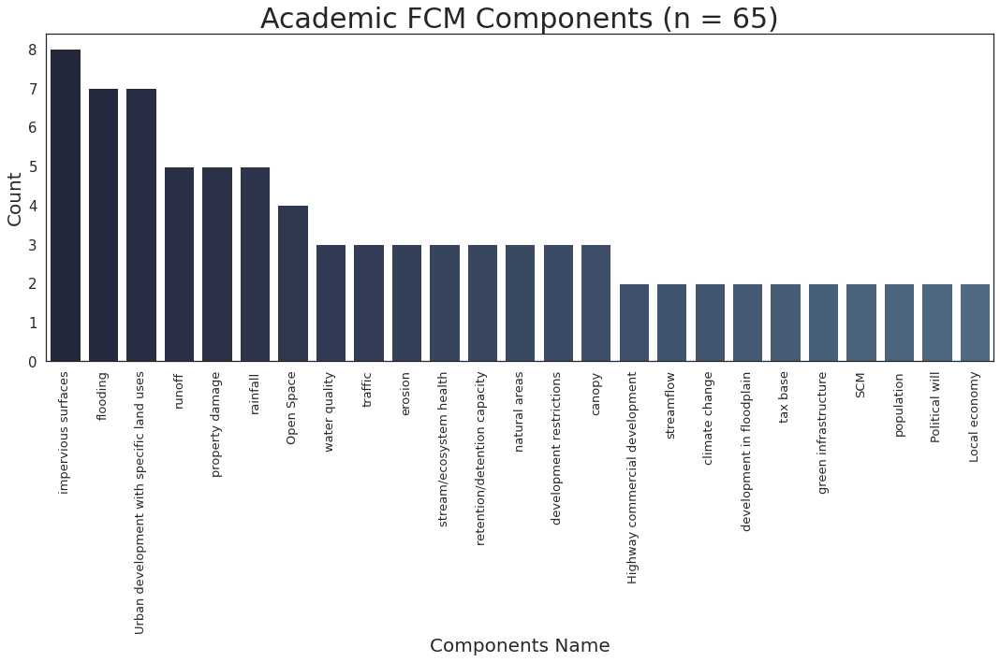

In [61]:
fcmComponentCount(df_academic_concepts, "Academic")


## Academic Mean FCM

Number of Maps: 7
Number of Concepts: 10
Mean: 0.01247142857142857
Median: 0.0
Std: 0.06060093995065171
High Threshold: 0.1942742484233837
Low Threshold: -0.16933139128052654
[(0, 2, {'weight': 0.32571428571428573}), (0, 3, {'weight': -0.04428571428571428}), (0, 5, {'weight': 0.23857142857142857}), (0, 7, {'weight': 0.08714285714285715}), (1, 0, {'weight': 0.1857142857142857}), (1, 2, {'weight': 0.22}), (1, 3, {'weight': -0.10428571428571429}), (1, 6, {'weight': -0.07285714285714286}), (4, 5, {'weight': 0.14285714285714285}), (5, 2, {'weight': 0.2057142857142857}), (6, 4, {'weight': 0.14285714285714285}), (7, 3, {'weight': 0.06285714285714286}), (7, 5, {'weight': -0.14285714285714285})]
                              centrality
rainfall                        0.881429
flooding                        0.751429
runoff                          0.730000
climate change                  0.582857
retention/detention capacity    0.292857
impervious surfaces             0.285714
population       

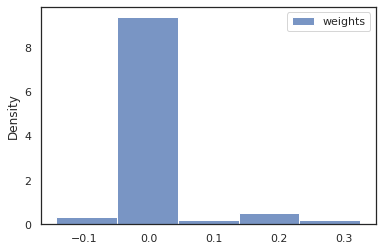

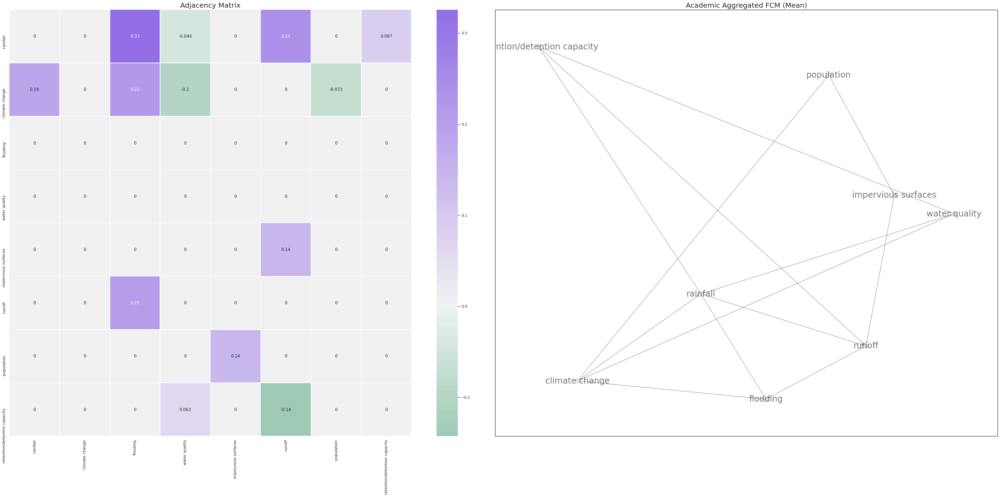

In [62]:
Adj_aggregated_FCM_academic = aggregate_mean(df_graph_stats_academic["all_adj"], filtered_concepts_academic,zeros="M")
df_agg_mean_academic = pd.DataFrame(Adj_aggregated_FCM_academic, index=filtered_concepts_academic, columns=filtered_concepts_academic)
df_agg_mean_academic_reduced = remove_weak_connections(df_agg_mean_academic, threshold=0.0)

# df_agg_mean_academic.to_csv(path_or_buf=os.path.join(save_location, "mean_of_academic_stakeholders_combined_fcm_dirty.csv"), index=True)

# df_agg_mean_clean = remove_orphan_nodes(df_agg_mean)
df_agg_mean_academic_reduced.to_csv(path_or_buf=os.path.join(save_location, "mean_of_academic_stakeholders_combined_fcm.csv"), index=True)

fig, (ax, ax1) = plt.subplots(1,2,figsize=(40,20))
ax.set_title("Adjacency Matrix", fontsize=20)

sns.heatmap(df_agg_mean_academic_reduced.fillna(0), annot=True, linewidths=.5, ax=ax, center=0,cmap=cmap)
ax1.set_title("Academic Aggregated FCM (Mean)", fontsize=20)
gov_stats = generate_map(df_agg_mean_academic_reduced.to_numpy(), df_agg_mean_academic_reduced.index,ax1)
print(gov_stats)
plt.tight_layout()
plt.savefig(os.path.join(save_location, "FCM-Academic-Mean.png"))


# FCM Concepts -> Geospatial Simulation/Model 

> Send back to stakeholders for other modeling suggestions

- Water Quality: Kims project?
- Urban Development: FUTURES
- Natural Areas: FUTURES
- Rainfall: 
- Runoff: SIMWE
- Erosion: SIMWE
- Population: FUTURES 
- Flooding: HAND
- Impervious Surfaces: FUTURES
- Property Damage:
- Retention/Detention Capacity:
- Climate Change:
- Traffic (Transportation):

# Sensitivity & Scenarios

['flooding' 'impervious surfaces' 'rainfall' 'runoff'
 'Urban development with specific land uses' 'water quality'
 'retention/detention capacity' 'property damage' 'climate change'
 'Open Space' 'Political will' 'stream/ecosystem health' 'streamflow'
 'erosion' 'SCM' 'population' 'natural areas' 'traffic'
 'development restrictions' 'canopy' 'Highway commercial development'
 'riparian buffer' 'public Involvement' 'nutrient loads'
 'development in floodplain' 'tax base' 'Local economy'
 'Stormwater Managment Regulations' 'rate of development'
 'stormwater infrastructure' 'drainage infrastructure capacity'
 'Stormwater Management Budget' 'water volume'
 'impervious surface per capita' 'public health'
 'floodplain disconnection' 'public education' 'stormwater infiltration'
 'polluted streams rivers and reservoirs' 'stream overflow'
 'improved stormwater management' 'public awareness'
 'green infrastructure']
impervious surfaces
rainfall
runoff
Urban development with specific land uses
wa

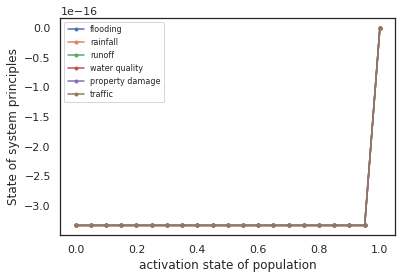

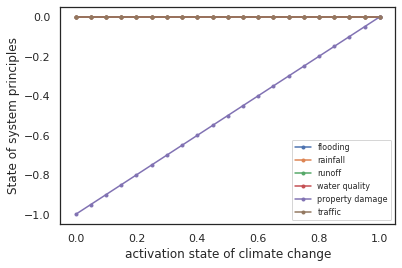

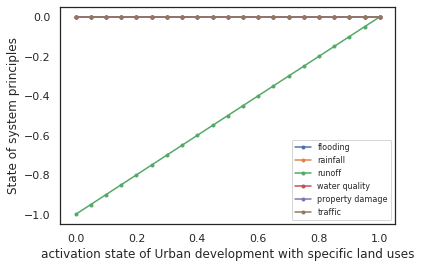

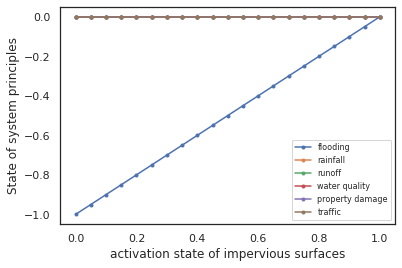

In [63]:
sensitivity_analysis(
    data=df_all_fcm_agg_mean_reduced.to_numpy(),
    columns=df_all_fcm_filtered_concepts,
    noise_threshold=0.0, 
    lambda_thres=10, 
    principles=['flooding','water quality', 'runoff', 'traffic', 'property damage', 'rainfall'], 
    list_of_consepts_to_run=['population','climate change','Urban development with specific land uses','impervious surfaces'], 
    function_type="tanh", 
    infer_rule="mk")


impervious surfaces
rainfall
runoff
Urban development with specific land uses
water quality
retention/detention capacity
property damage
climate change
Open Space
Political will
stream/ecosystem health
streamflow
erosion
SCM
population
natural areas
traffic
development restrictions
canopy
Highway commercial development
riparian buffer
public Involvement
nutrient loads
development in floodplain
tax base
Local economy
Stormwater Managment Regulations
rate of development
stormwater infrastructure
drainage infrastructure capacity
Stormwater Management Budget
water volume
impervious surface per capita
public health
floodplain disconnection
public education
stormwater infiltration
polluted streams rivers and reservoirs
stream overflow
improved stormwater management
public awareness
green infrastructure


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:176: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


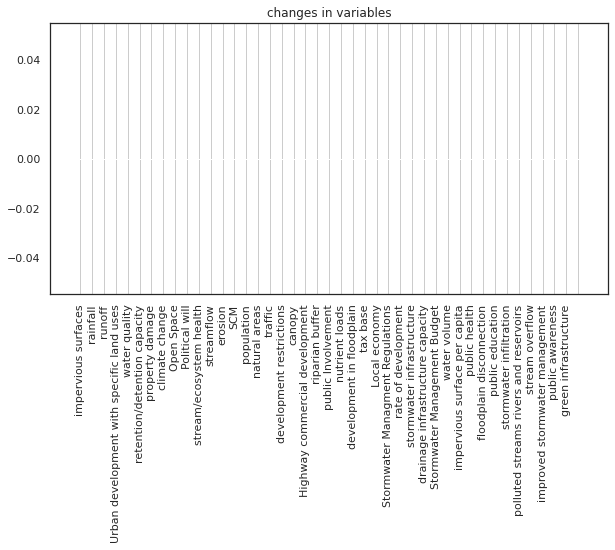

In [64]:
scenario_analysis(
    data=df_all_fcm_agg_mean_reduced.to_numpy(),
    columns=df_all_fcm_filtered_concepts,
    noise_threshold=0.0,
    lambda_thres=10,
    principles=['flooding','water quality', 'runoff', 'traffic', 'property damage', 'rainfall'],
    list_of_consepts_to_run=['Urban development with specific land uses'],
    change_level={
        'Urban development with specific land uses':1,
        'population': 1,
        'climate change': 1,
        'impervious surfaces': 1
    },
    function_type="tanh",
    infer_rule="mk",
    what_to_show="A")

# Survey123

In [65]:

import matplotlib.pyplot as plt; plt.rcdefaults()
import matplotlib.pyplot as plt
import seaborn as sns
import os
import numpy as np
os.environ['PATH'] += ":/root/.local/bin"

!pip install geopandas
import geopandas as gpd

!pip install esri2gpd
from arcgis2geojson import arcgis2geojson

!pip install libpysal
import libpysal as lps

# !pip install spaghetti
# import spaghetti
!pip install mplleaflet



     |████████████████████████████████| 1.0MB 7.9MB/s 
     |████████████████████████████████| 15.3MB 291kB/s 
     |████████████████████████████████| 6.5MB 18.6MB/s 
  Created wheel for esri2gpd: filename=esri2gpd-1.0.7-cp37-none-any.whl size=3704 sha256=fc6a2d47b8eb59b942d6d2e828c5851fd1d681580209b000ade54af38746832d
  Stored in directory: /root/.cache/pip/wheels/5f/f2/e6/1a6ab2e117077f0eefe6132481857d54ae3948dc6c3644ddcb
Successfully built esri2gpd
     |████████████████████████████████| 2.4MB 7.4MB/s 
  Created wheel for mplleaflet: filename=mplleaflet-0.0.5-cp37-none-any.whl size=28556 sha256=20a0bbc66d2e6f1e24dce10cbe96bb517ee97627fd2c6c438fde0180aa4e5087
  Stored in directory: /root/.cache/pip/wheels/bf/fd/0b/0513de62c339c4a56e2234aa42a5d06e6660a4446fdae7b796
Successfully built mplleaflet


## Get Data

In [66]:
featureService = "https://services1.arcgis.com/aT1T0pU1ZdpuDk1t/arcgis/rest/services/survey123_571499fe84ac4125abe48b793b9970a3_stakeholder/FeatureServer/0/query"
# # defining a params dict for the parameters to be sent to the API 
PARAMS = {
    'f':'json',
    'returnGeometry': 'true',
    'inSR': 102100,
    'outFields':'*',
    'outSR': 3857, #3358, #3358 NC NAD83, 3857 Web Mercator
    'where':"CreationDate>=DATE '2019-04-12' AND CreationDate<=DATE '2019-04-13'"
} 
# sending get request and saving the response as response object 
import requests
r = requests.get(url = featureService, params = PARAMS) 

# extracting data in json format 
data = r.json() 
geojson = [arcgis2geojson(f) for f in data["features"]]
df_survey = gpd.GeoDataFrame.from_features(geojson, crs={"init": "epsg:3857"})

df_survey.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 31 entries, 0 to 30
Data columns (total 25 columns):
 #   Column                                 Non-Null Count  Dtype   
---  ------                                 --------------  -----   
 0   geometry                               31 non-null     geometry
 1   ObjectId                               31 non-null     int64   
 2   globalid                               31 non-null     object  
 3   CreationDate                           31 non-null     int64   
 4   Creator                                31 non-null     object  
 5   EditDate                               31 non-null     int64   
 6   Editor                                 31 non-null     object  
 7   why_is_this_location_a_problem         31 non-null     object  
 8   when_will_this_problem_exist_          31 non-null     object  
 9   how_serious_is_this_issue              0 non-null      object  
 10  what_is_the_greatest_barrier_to        31 non-null     o

/usr/local/lib/python3.7/dist-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


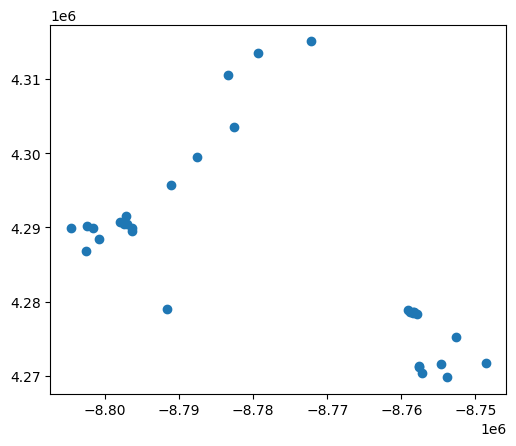

In [67]:
ax = df_survey.plot()



In [68]:
# df_survey['geometry'].centroid
df_survey["x"] = df_survey.centroid.x
df_survey["y"] = df_survey.centroid.y

## Cluster Data w/DBSCAN

In [69]:
from sklearn.cluster import DBSCAN
epsilon = 1000
coords = df_survey[['x', 'y']].values
db = (DBSCAN(eps=epsilon, min_samples=3, algorithm='auto', metric = 'euclidean').fit(coords))

cluster_labels = db.labels_
unique_labels = set(cluster_labels)
# number of clusters
num_clusters = len(set(cluster_labels))
print ('number of clustered verblijfsobjecten: {}'.format(num_clusters))

number of clustered verblijfsobjecten: 4


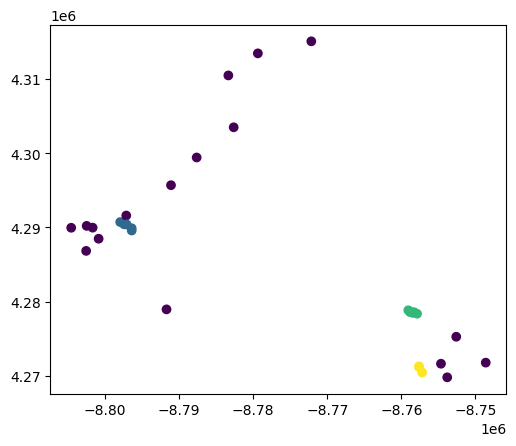

In [91]:
# print(db.labels_)
df_survey['clusters'] = db.labels_
df_survey.plot(column='clusters')

## Clean Data

In [92]:
df_survey[[
           'CreationDate',
           'why_is_this_location_a_problem',
           'what_is_the_greatest_barrier_to',
           'what_actions_can_be_taken_to_fi',
           'how_challenging_is_this_problem',
           'what_type_of_organization_are_y',
           'when_will_this_problem_exist_',
           'field_19', #Probably Stormwater professional question
           'field_21', # Drive Spatial Scale Question
           'field_22', # Impact Spatial Scale Question
           'how_long',
           'how_often',
           'how_serious_is_this_problem',
           'what_would_the_purpose_of_the_g',
           'what_type_of_game_style_could_b'
          ]].head(5)

df_survey.rename(columns={
    'field_19':'Do you consider yourself a stormwater professional?',
    'field_21':'At what spatial scale does the driver of this problem occur?',
    'field_22':'At what spatial scale does the impact of this problem occur?',
    }, inplace=True)
  

KeyError: ignored

In [93]:
df_survey.head()

,geometry,ObjectId,globalid,CreationDate,Creator,EditDate,Editor,why_is_this_location_a_problem,when_will_this_problem_exist_,how_serious_is_this_issue,what_is_the_greatest_barrier_to,what_actions_can_be_taken_to_fi,what_type_of_game_style_could_b,what_type_of_organization_are_y,what_type_of_organization_are_y_other,are_you_a_stormwater_profession,Do you consider yourself a stormwater professional?,how_challenging_is_this_problem,At what spatial scale does the driver of this problem occur?,At what spatial scale does the impact of this problem occur?,what_would_the_purpose_of_the_g,field_19_other,how_often,how_long,how_serious_is_this_problem,x,y,how_long_scaled,how_often_scaled,driver_extent_scaled,impact_extent_scaled,serious_scaled,challenge_scaled,clusters
0,POINT (-8800866.622 4288479.595),37,829b25c7-46ca-4f37-80ca-9c8979b3ff7f,1555090265508,,1555090265508,,This area has undersized stormwater drainage s...,_both,None,Engaging NCDOT to upgrade the infrastructure i...,"Improve infrastructure, model upstream hydrolo...",play_based_eg_sim_city,Government,None,None,no,medium,neighborhood,neighborhood,Training_and_Simulation,None,year,day,somewhat_serious,-8.800867e+06,4.288480e+06,0,3,1,1,1,3,-1
1,POINT (-8796404.937 4289898.117),38,b7719ecb-57b8-4f7d-801a-a4c167f8d360,1555092479441,,1555092479441,,Confluence of two major streams/drainage basin...,_both,None,Established neighborhoods in this location are...,"Upstream retention/retrofit, community underst...",game_based_eg_pac_man,Government,None,None,no,hard,city,city,"Education,Inform_Policy,Training_and_Simulation",None,year,month,somewhat_serious,-8.796405e+06,4.289898e+06,2,3,2,2,1,4,0
2,POINT (-8796400.484 4289590.205),39,47e7237b-0e4c-4f98-8ddd-5ca8ecac2dfe,1555098595808,,1555098595808,,It might not be a problem; it's just that it f...,_both,None,The road is in the wrong place,Block the road,game_based_eg_pac_man,Academia,None,None,no,easy,neighborhood,neighborhood,Inform_Policy,None,month,day,somewhat_unserious,-8.796400e+06,4.289590e+06,0,2,1,1,-1,2,0
3,POINT (-8758286.917 4278560.607),40,3374edda-92e5-460f-88e7-0ef2ed559b4e,1555098631921,opala_NCSU,1555098631921,opala_NCSU,Flooding after every heavy rain event.,_both,None,I am not sure.,I think that the tributaries feeding into the ...,play_based_eg_sim_city,Academia,None,None,no,medium,neighborhood,city,"Education,Training_and_Simulation",None,year,week,somewhat_serious,-8.758287e+06,4.278561e+06,1,3,1,2,1,3,1
4,POINT (-8758469.481 4278489.201),41,3e20e3cc-1e44-49f1-86c8-9a2ddce4e9e8,1555098645546,,1555098645546,,Too much development and impervious surfaces i...,_both,None,Existing development patterns and car-dependen...,Remove housing and smaller scale commercial fr...,game_based_eg_pac_man,"Academia,Government,Other",Citizen,None,no,hard,city,city,"Education,Inform_Policy",None,year,week,serious,-8.758469e+06,4.278489e+06,1,3,2,2,2,4,1


# Does spatial extent change the precieved challenge?

### Driver Scale




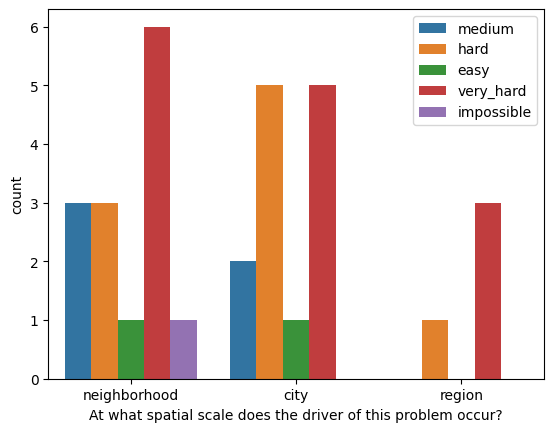

In [75]:
fig, ax1 = plt.subplots(ncols=1)
sns.countplot(x='At what spatial scale does the driver of this problem occur?',
              hue='how_challenging_is_this_problem',
              data=df_survey, orient='v')
plt.legend(loc='upper right')
plt.savefig(os.path.join(save_location, "how_challenging_driver_scale.png"), bbox_inches="tight")


### Impact Scale

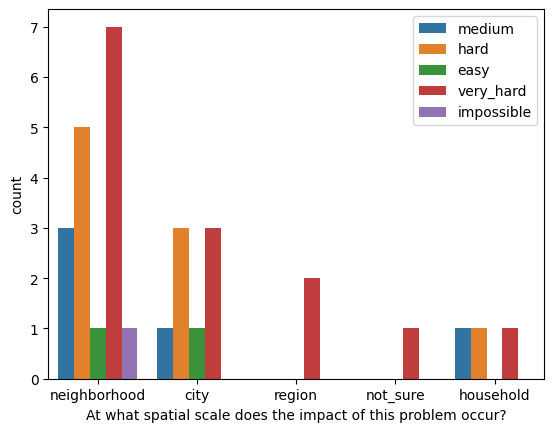

In [76]:
fig, ax1 = plt.subplots(ncols=1)

sns.countplot(x='At what spatial scale does the impact of this problem occur?', hue='how_challenging_is_this_problem',data=df_survey)
plt.legend(loc='upper right')
plt.savefig(os.path.join(save_location, "how_challenging_impact_scale.png"), bbox_inches="tight")


# Does the frequency of a problem event effect the duration of the impact?

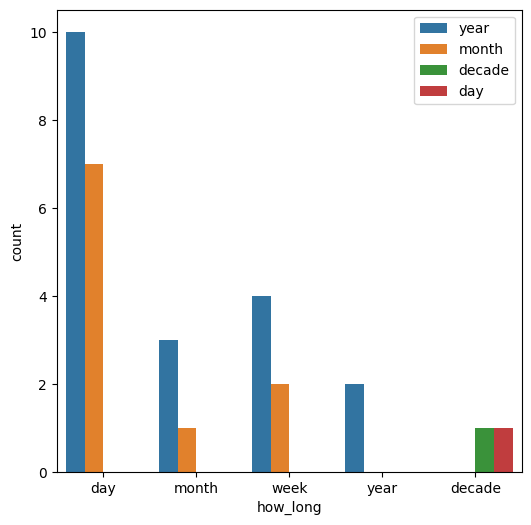

In [77]:
import matplotlib.pyplot as plt

# Initialize the matplotlib figure
f, ax = plt.subplots(figsize=(6, 6))
sns.countplot(x="how_long", hue="how_often", data=df_survey)
plt.legend(loc='upper right')



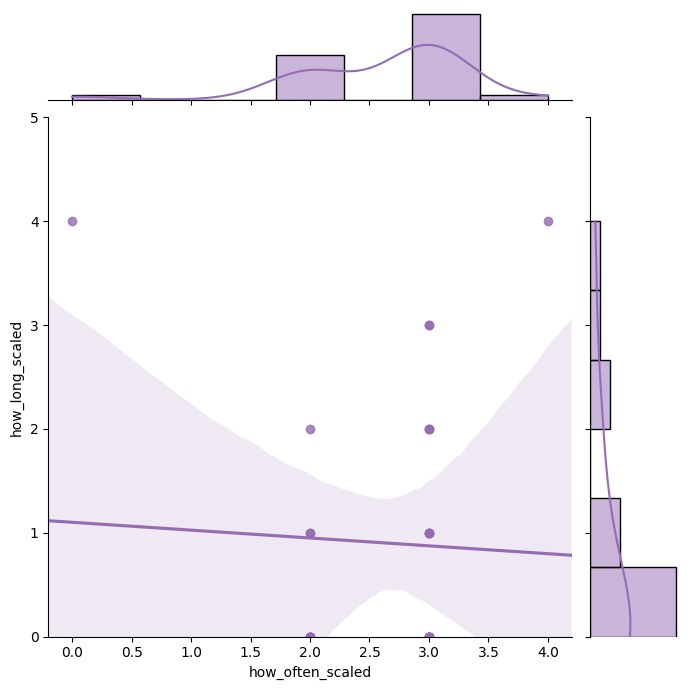

In [94]:
sns.jointplot(x="how_often_scaled", y="how_long_scaled", data=df_survey,
                  kind="reg", truncate=False,
                  color="m", height=7,ylim=[0,5])

In [79]:
# time_map = {"day": 0, "week":7, "month": 31,"year": 365, "decade": 365 *10}
time_map = {"day": 0, "week":1, "month": 2,"year": 3, "decade": 4}
df_survey['how_long_scaled'] = df_survey['how_long'].map(time_map)
df_survey['how_often_scaled'] = df_survey['how_often'].map(time_map)

import numpy as np
extent_map = {"household": 0, "neighborhood":1, "city": 2,"region": 3, 'global': 4, 'not_sure': 5}
# extent_map = {"household": 1, "neighborhood":10, "city": 100,"region": 1000, 'global': 10000, 'not_sure': 2}

df_survey['driver_extent_scaled'] = df_survey['At what spatial scale does the driver of this problem occur?'].map(extent_map)
df_survey['impact_extent_scaled'] = df_survey['At what spatial scale does the impact of this problem occur?'].map(extent_map)

likert_scale = {'unserious': -2, 'somewhat_unserious': -1, 'neutral': 0, 'somewhat_serious': 1, 'serious': 2}	
df_survey['serious_scaled'] = df_survey['how_serious_is_this_problem'].map(likert_scale)


challenge_scale = {'solved': 0, 'very': 1, 'easy': 2, 'medium': 3, 'hard': 4, 'very_hard': 5, 'impossible': 6}
df_survey['challenge_scaled'] = df_survey['how_challenging_is_this_problem'].map(challenge_scale)



No handles with labels found to put in legend.


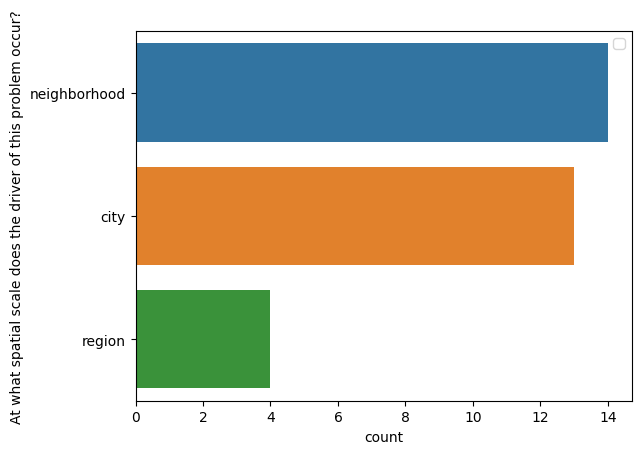

In [80]:
sns.countplot(y='At what spatial scale does the driver of this problem occur?',
              data=df_survey, orient='v')
plt.legend(loc='upper right')

No handles with labels found to put in legend.


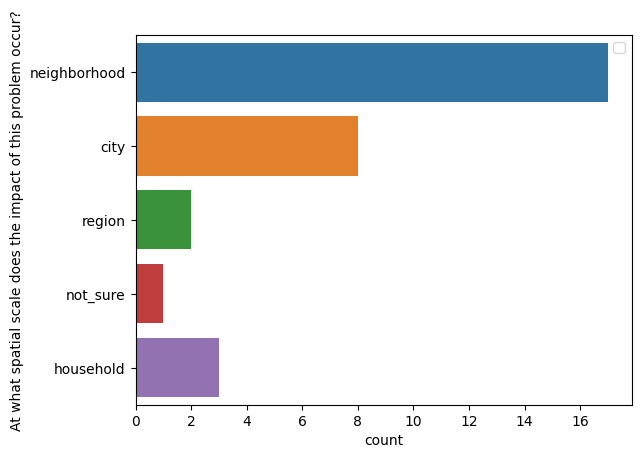

In [81]:
sns.countplot(y='At what spatial scale does the impact of this problem occur?',
              data=df_survey, orient='v')
plt.legend(loc='upper right')

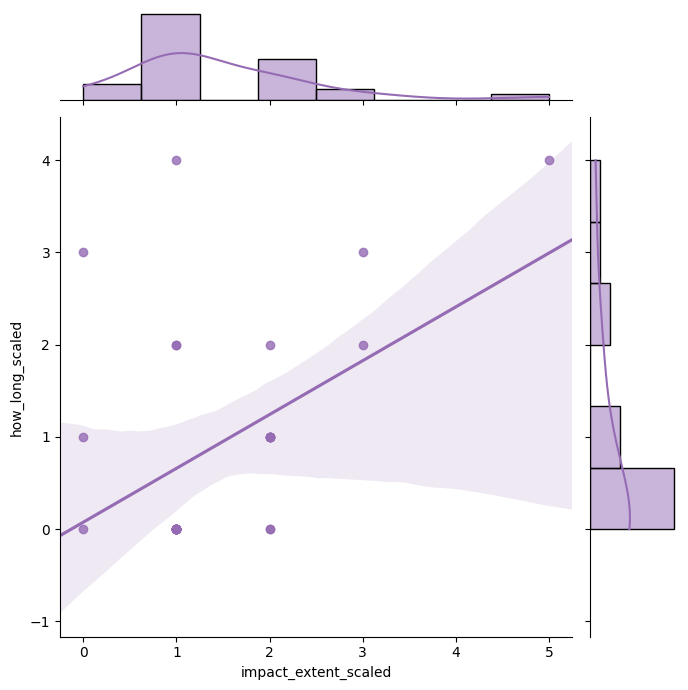

In [82]:
from scipy import stats
def r2(x, y):
    return stats.pearsonr(x, y)[0] ** 2

sns.jointplot(x="impact_extent_scaled", y="how_long_scaled", data=df_survey,kind="reg", truncate=False,color="m", height=7)

# Are diver extent and how often the problem occurs correlated?

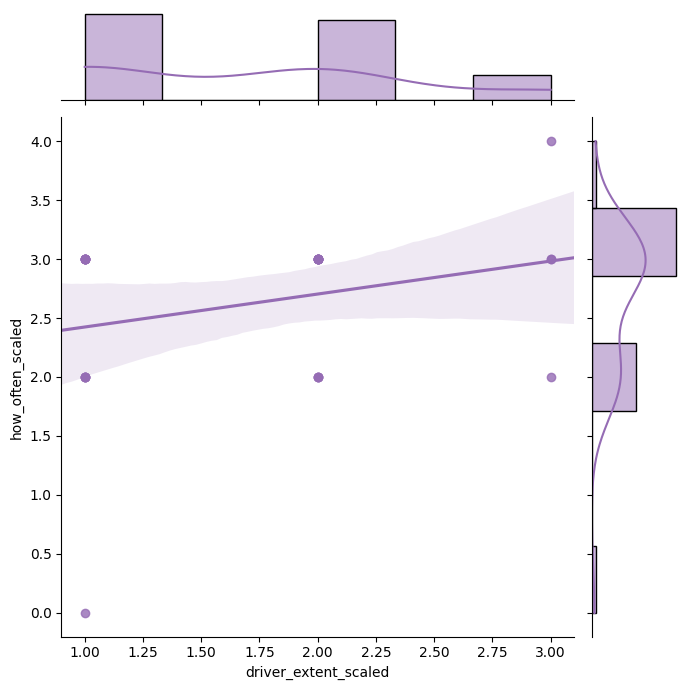

In [83]:
sns.jointplot(x="driver_extent_scaled", y="how_often_scaled", data=df_survey,
                  kind="reg", truncate=False,
                  color="m", height=7)

# Game Play Type

## What style

No handles with labels found to put in legend.


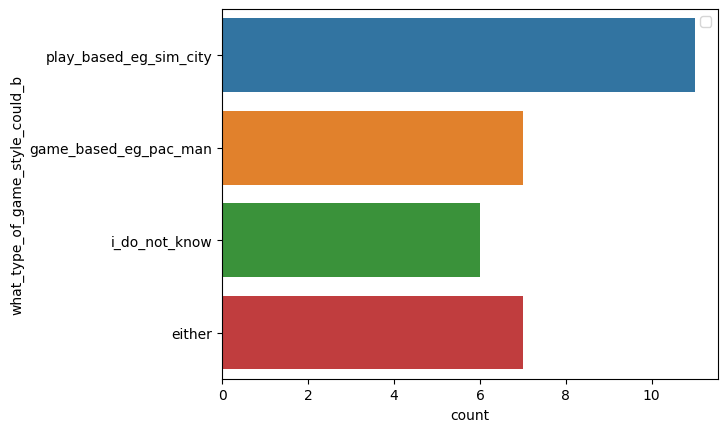

In [84]:
sns.countplot(y='what_type_of_game_style_could_b',
              data=df_survey, orient='v')
plt.legend(loc='upper right')

## What's the purpose?

In [85]:
def gamePurpose(df):
  survey_game_purpose = []
  for row in df['what_would_the_purpose_of_the_g']:
    survey_game_purpose = survey_game_purpose + row.split(',')

  df_survey_purpose = pd.DataFrame(data=survey_game_purpose, columns=["Purpose"])
  return sns.catplot(y="Purpose", kind="count",palette="pastel", edgecolor=".6",data=df_survey_purpose)

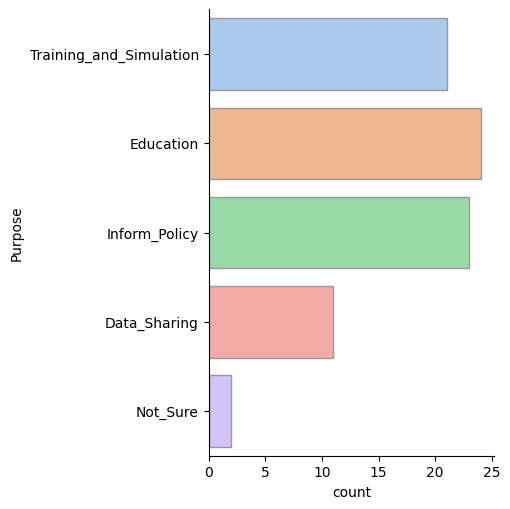

In [86]:
gamePurpose(df_survey)

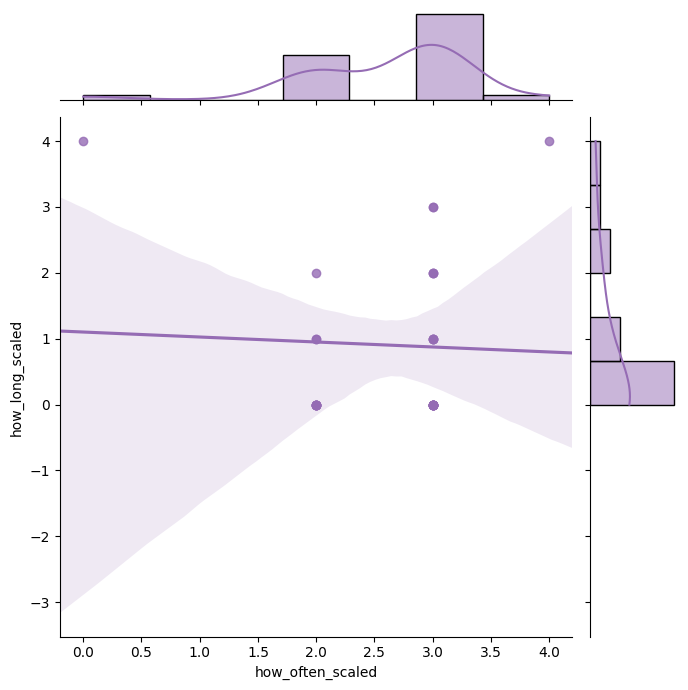

In [87]:
sns.jointplot(x="how_often_scaled", y="how_long_scaled", data=df_survey,
                  kind="reg", truncate=False,
                  color="m", height=7)


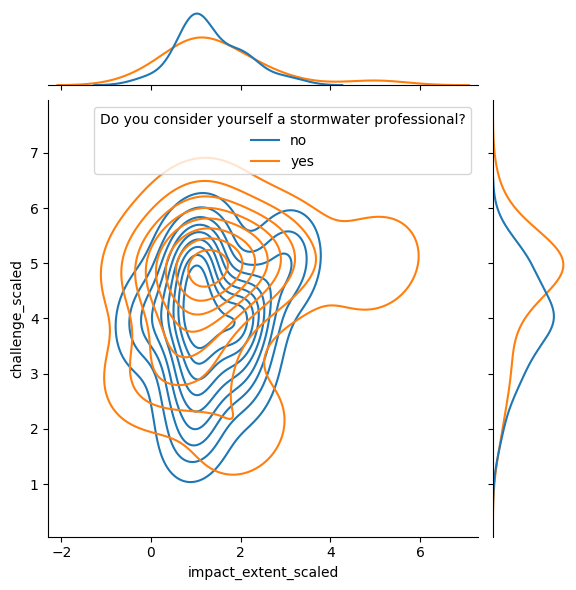

In [95]:
sns.jointplot(data=df_survey, 
              x="impact_extent_scaled", 
              y="challenge_scaled", 
              kind="kde",
              hue="Do you consider yourself a stormwater professional?")



# sns.jointplot(y="driver_extent_scaled", x="impact_extent_scaled", data=df_survey,
#                   kind="reg", truncate=False,
#                   color="m", height=7)

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1078: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1078: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


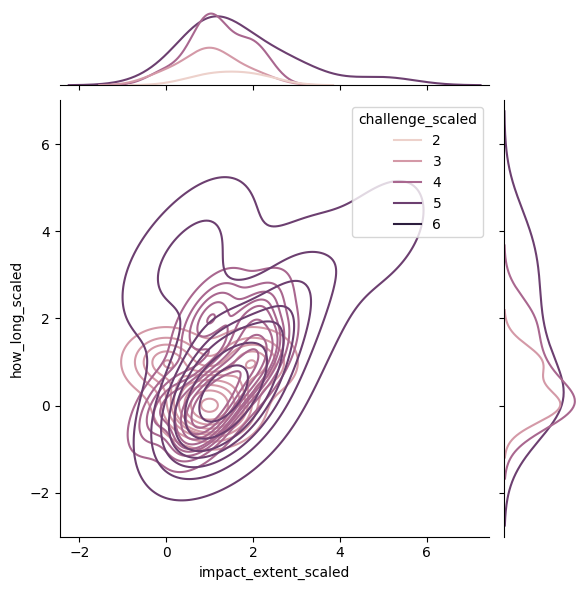

In [96]:
sns.jointplot(data=df_survey, y="how_long_scaled", 
              x="impact_extent_scaled", kind="kde", 
              hue="challenge_scaled")


# Pair Plot group by stormwater professional

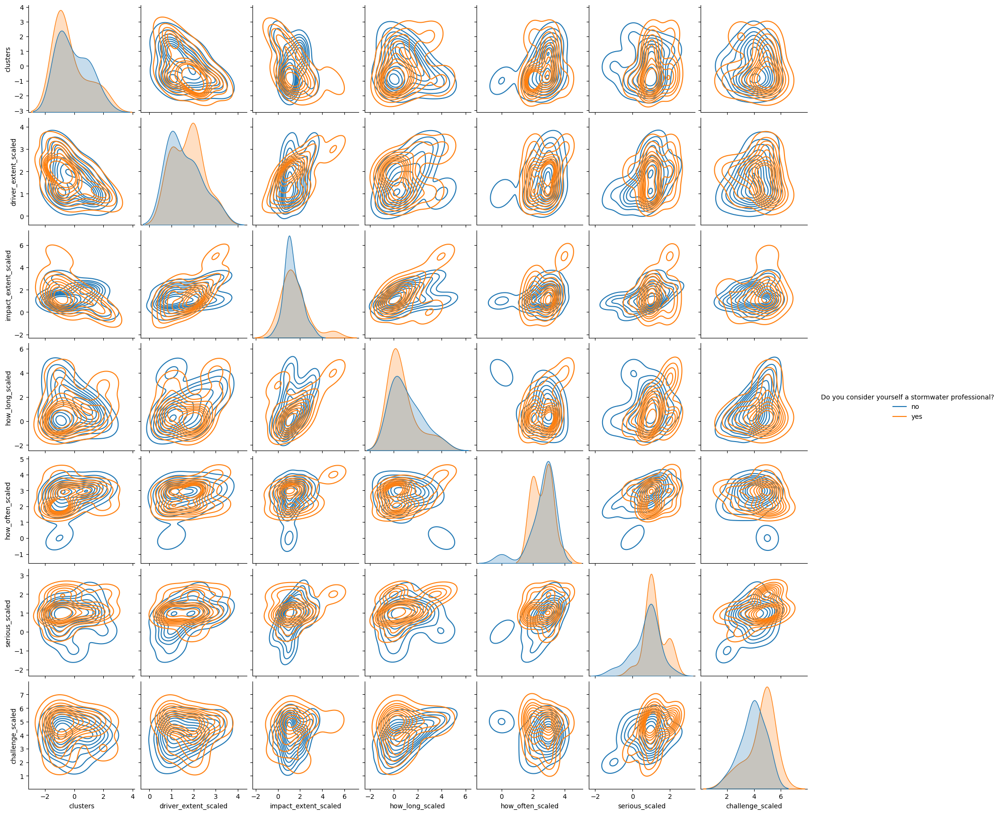

In [97]:
sns.pairplot(df_survey[[
                            'clusters',
                            'driver_extent_scaled',
                            'impact_extent_scaled',
                            'how_long_scaled', 
                            'how_often_scaled',
                            'serious_scaled',
                            'challenge_scaled',
                            'what_type_of_organization_are_y',
                            'Do you consider yourself a stormwater professional?']],
              hue="Do you consider yourself a stormwater professional?",
              kind="kde")


# Pair Plot group by challenge

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning

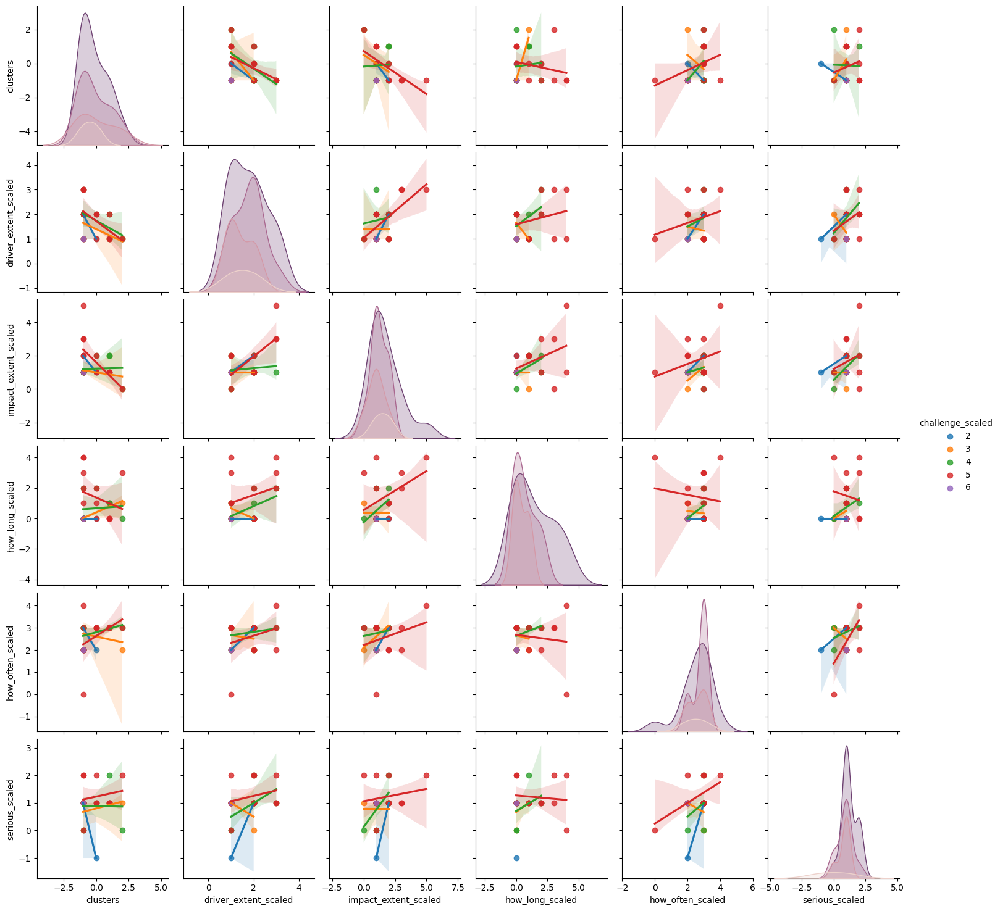

In [98]:
sns.pairplot(df_survey[[    'clusters',
                            'driver_extent_scaled',
                            'impact_extent_scaled',
                            'how_long_scaled', 
                            'how_often_scaled',
                            'serious_scaled',
                            'challenge_scaled',
                            'what_type_of_organization_are_y',
                            'Do you consider yourself a stormwater professional?']], 
             hue="challenge_scaled",
             kind="reg")


# Pair Plot group by serious

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning

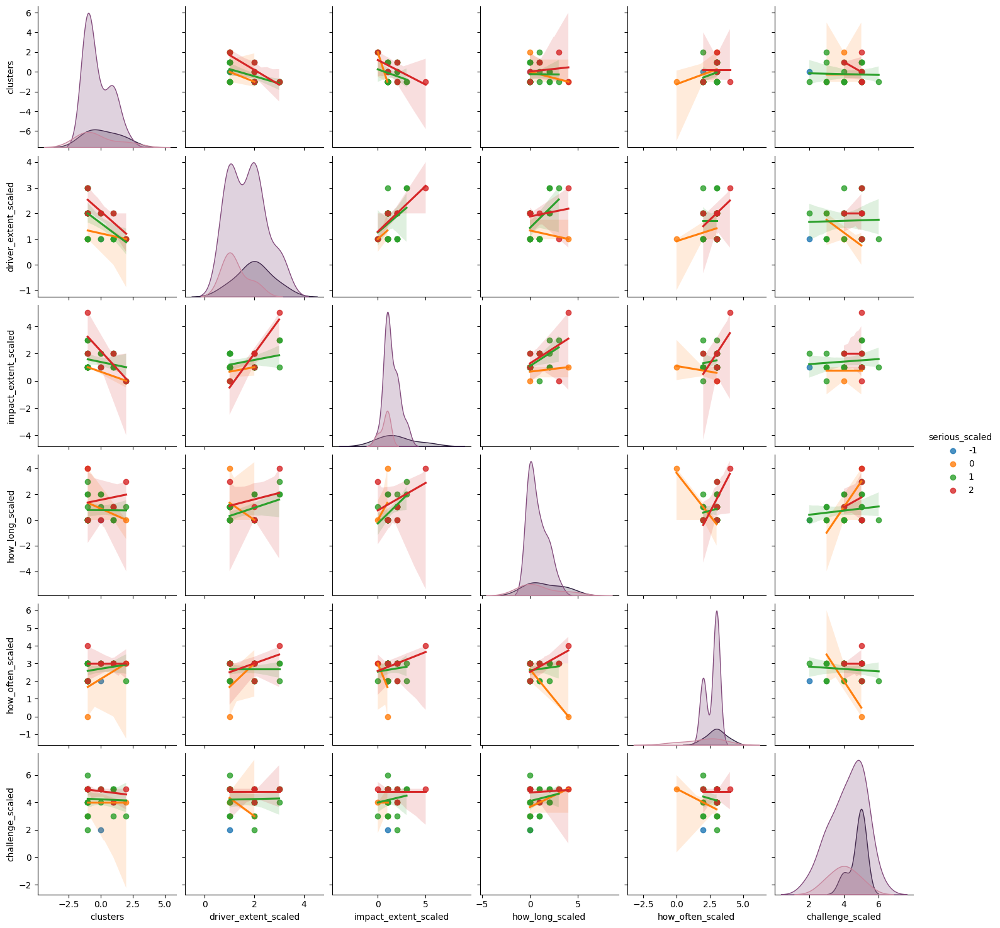

In [152]:
sns.pairplot(df_survey[[    'clusters',
                            'driver_extent_scaled',
                            'impact_extent_scaled',
                            'how_long_scaled', 
                            'how_often_scaled',
                            'serious_scaled',
                            'challenge_scaled',
                            'what_type_of_organization_are_y',
                            'Do you consider yourself a stormwater professional?']], 
             hue="serious_scaled",
             kind="reg")

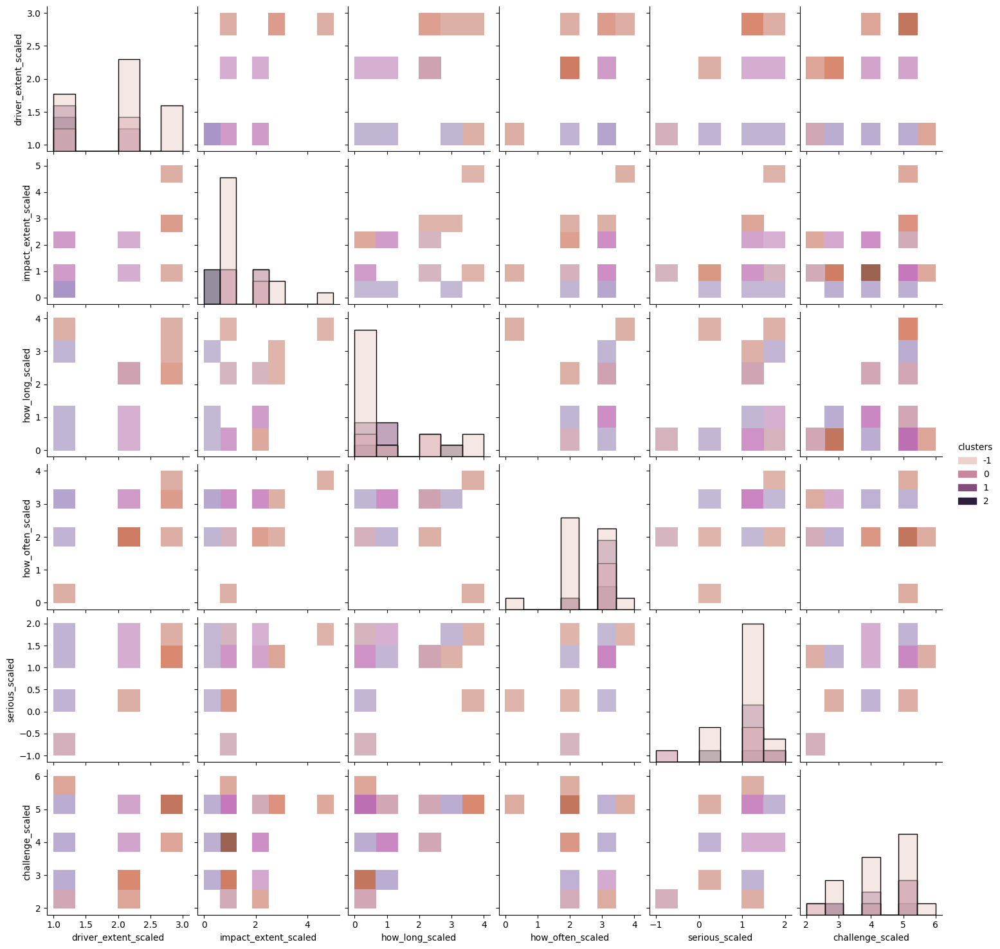

In [154]:
sns.pairplot(df_survey[[    'clusters',
                            'driver_extent_scaled',
                            'impact_extent_scaled',
                            'how_long_scaled', 
                            'how_often_scaled',
                            'serious_scaled',
                            'challenge_scaled',
                            'what_type_of_organization_are_y',
                            'Do you consider yourself a stormwater professional?']], 
             hue="clusters", kind="hist")

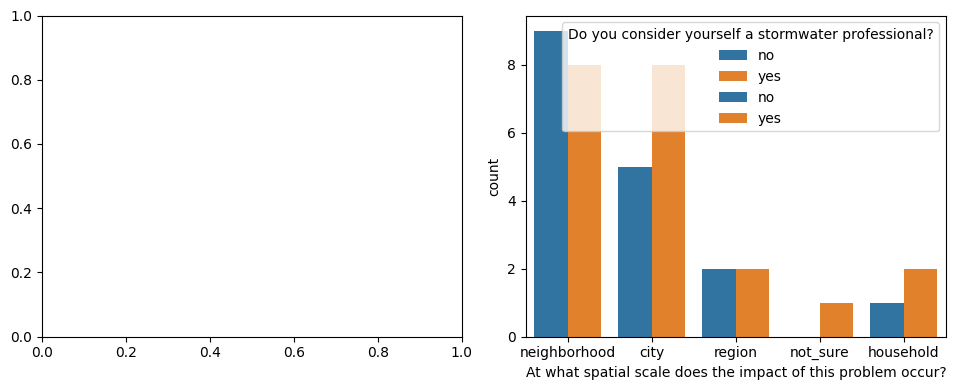

In [158]:
fig, (ax1,ax2) = plt.subplots(1,2, figsize=(10,4)) 

sns.countplot(x='At what spatial scale does the driver of this problem occur?',
              hue='Do you consider yourself a stormwater professional?',
              data=df_survey)

sns.countplot(x='At what spatial scale does the impact of this problem occur?',
              hue='Do you consider yourself a stormwater professional?',
              data=df_survey)

plt.tight_layout()

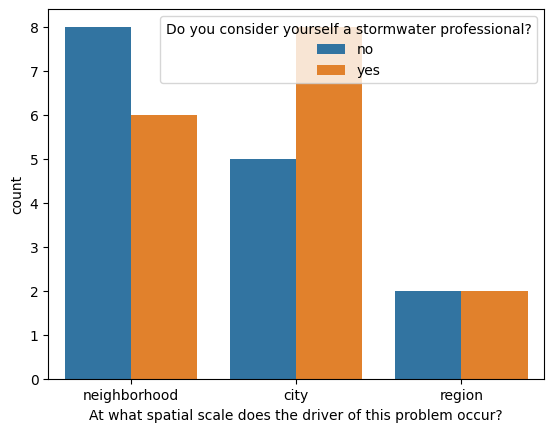

In [279]:
sns.countplot(x='At what spatial scale does the driver of this problem occur?',
              hue='Do you consider yourself a stormwater professional?',
              data=df_survey)



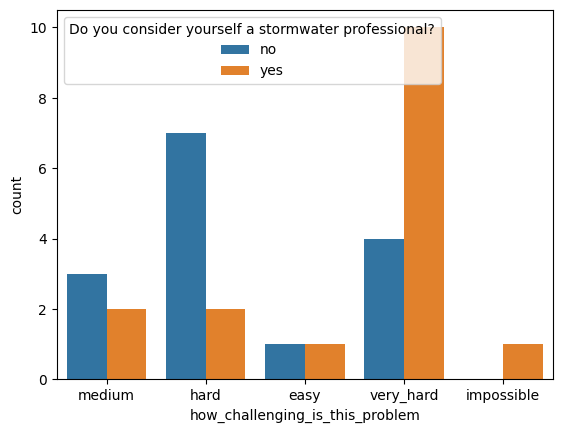

In [280]:

sns.countplot(x='how_challenging_is_this_problem',
              hue='Do you consider yourself a stormwater professional?',
              data=df_survey)


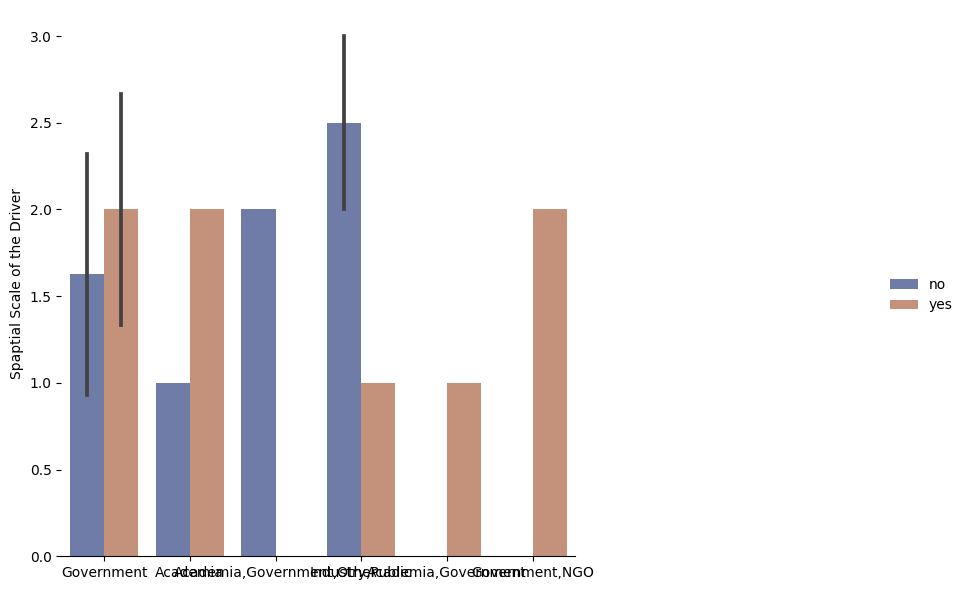

In [281]:
df_survey_cleaned = df_survey[[
                            'driver_extent_scaled',
                            'impact_extent_scaled',
                            'how_long_scaled', 
                            'how_often_scaled',
                            'serious_scaled',
                            'challenge_scaled',
                            'what_type_of_organization_are_y',
                            'Do you consider yourself a stormwater professional?']]

# Initialize a grid of plots with an Axes for each walk
# sns.FacetGrid(df_survey_cleaned, col="Do you consider yourself a stormwater professional?", hue="Do you consider yourself a stormwater professional?", palette="tab20c")
g = sns.catplot(
    data=df_survey_cleaned, kind="bar",
    x="what_type_of_organization_are_y", y="driver_extent_scaled", hue="Do you consider yourself a stormwater professional?",
    ci="sd", palette="dark", alpha=.6, height=6
)
g.despine(left=True)
g.set_axis_labels("", "Spaptial Scale of the Driver")
g.legend.set_title("")

In [159]:
# import scipy.stats as stats
# import statsmodels as sm
# df_expert = df_survey_cleaned[df_survey_cleaned['Do you consider yourself a stormwater professional?'] == 'yes']['challenge_scaled']
# print("Expert Mean: {}, Count: {}".format(df_expert.mean(), df_expert.count()))
# df_genpub = df_survey_cleaned[df_survey_cleaned['Do you consider yourself a stormwater professional?'] == 'no']['challenge_scaled']
# print("Gen Pub Mean: {}, Count: {}".format(df_genpub.mean(), df_genpub.count()))
# stats.weightstats.ztest(x1=df_expert,x2=df_genpub)

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


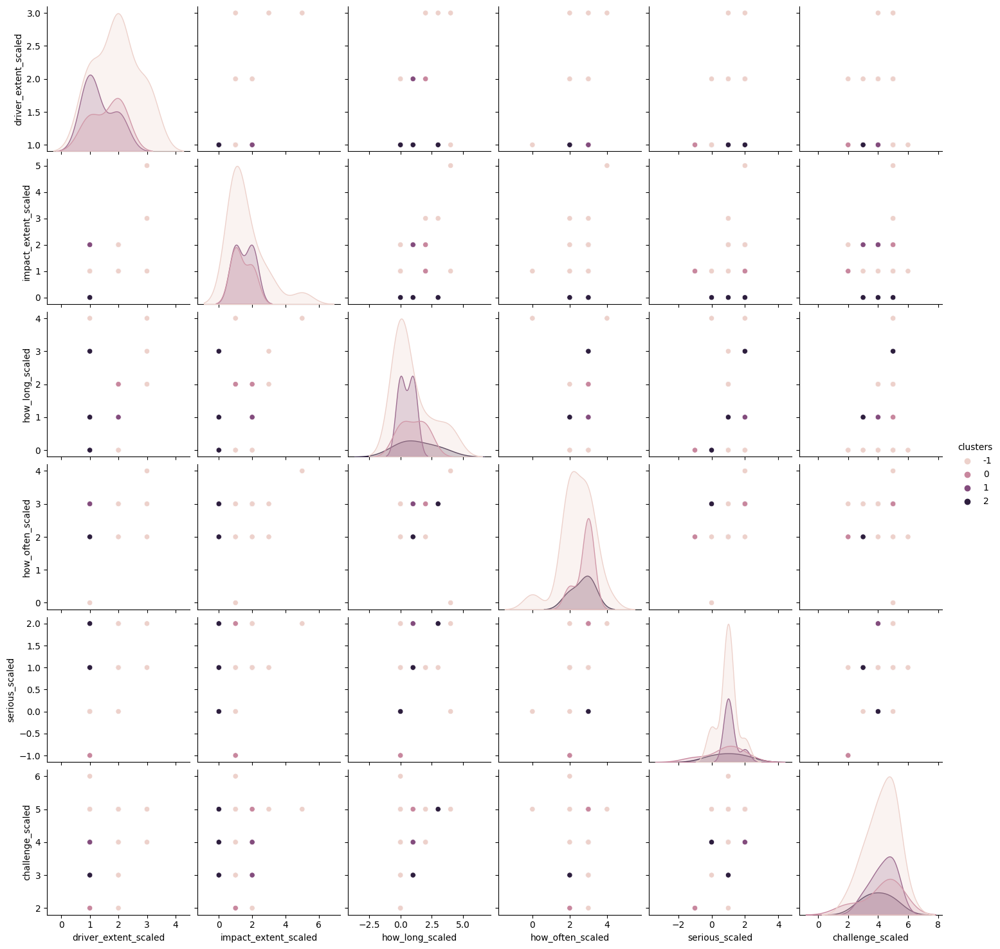

In [327]:
sns.pairplot(df_survey[[
                            'driver_extent_scaled',
                            'impact_extent_scaled',
                            'how_long_scaled', 
                            'how_often_scaled',
                            'serious_scaled',
                            'challenge_scaled',
                            'what_type_of_organization_are_y',
                            'Do you consider yourself a stormwater professional?', 'clusters']], hue="clusters")

# Create Wordcloud

In [99]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator


## Problem

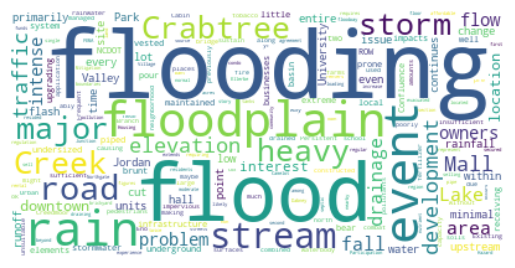

In [100]:
problem_text = " ".join(review for review in df_survey['why_is_this_location_a_problem'])

import re
# problem_text = re.sub(r'\bflood\b', 'flooding', problem_text)
# Create stopword list:
# stopwords = set(STOPWORDS)
# stopwords.update(["drink", "now", "wine", "flavor", "flavors"])

# Generate a word cloud image
problem_wordcloud = WordCloud(background_color="white").generate(problem_text)


# Display the generated image:
# the matplotlib way:
plt.imshow(problem_wordcloud, interpolation='bilinear')


plt.axis("off")
plt.show()


## Barrier

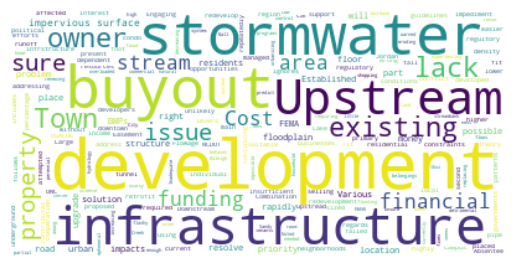

In [101]:
barrier_text = " ".join(review for review in df_survey['what_is_the_greatest_barrier_to'])

# Create stopword list:
# stopwords = set(STOPWORDS)
# stopwords.update(["drink", "now", "wine", "flavor", "flavors"])
# barrier_text = re.sub(r'\bflood\b', 'flooding', problem_text)
# Generate a word cloud image
barrier_wordcloud = WordCloud(background_color="white").generate(barrier_text)

plt.imshow(barrier_wordcloud, interpolation='bilinear')

plt.axis("off")
plt.show()


## Solution

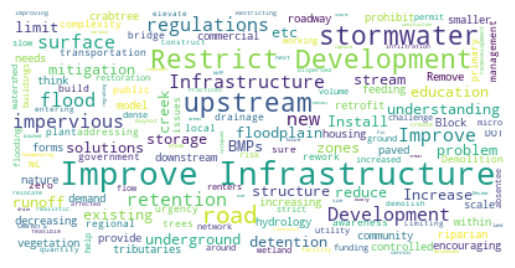

In [102]:
solution_text = " ".join(review for review in df_survey['what_actions_can_be_taken_to_fi'])

# Generate a word cloud image
solution_wordcloud = WordCloud(background_color="white").generate(solution_text)

# Display the generated image:
# the matplotlib way:

plt.imshow(solution_wordcloud, interpolation='bilinear')

plt.axis("off")
plt.show()


## Problem, Barrier and Solution Combined

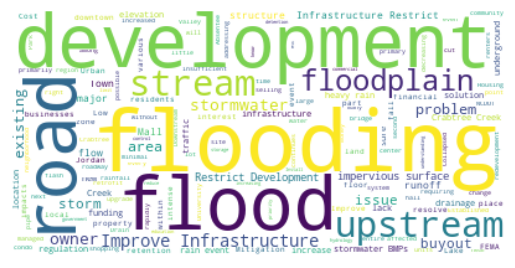

In [103]:
prob_barrier_solution_text = problem_text + barrier_text + solution_text
# Generate a word cloud image
prob_barrier_solution_wordcloud = WordCloud(background_color="white").generate(prob_barrier_solution_text)

# Display the generated image:
# the matplotlib way:

plt.imshow(prob_barrier_solution_wordcloud, interpolation='bilinear')

plt.axis("off")
plt.show()

# FCM from spatial Point

## Function: generate_spatial_fcm

In [136]:
def generate_spatial_fcm(text, ofcm, title=""):
  wordcloud = WordCloud(background_color="white").generate(text)
  filtered_concepts = ofcm.index
  print("Total Original Original Concepts: {}".format(len(filtered_concepts)))
  # Display the generated image:
  # the matplotlib way:
  plt.imshow(wordcloud, interpolation='bilinear')
  plt.axis("off")
  plt.show()
  special_words = {
      "Restrict Development":"development restrictions",
      "funding":"Stormwater Management Budget",
      "BMPs": "SCM",
      "rain": "rainfall",
      "impervious surface": "impervious surfaces",
      "Improve Infrastructure":"infrastructure",
      "detention": "retention/detention capacity",
      "retention": "retention/detention capacity",
      "riparian" :"riparian buffer",
      "buffer": "riparian buffer",
      "education": "public education",
      "floodplain":"development in floodplain",
      "mitigation": "floodplain mitigation"
      } 
  spatial_drop_list = []
  text = text.lower()
  for c in filtered_concepts:
    # concept_map
    c_lower = c.lower()
    text_count = text.count(c_lower)
    
    
    # text_count = re.findall(c, text) 
    # print("{}: {}".format(c, text_count))
    if text_count == 0:
      # Check mapped variations of word to see if they work
      for key, value in concept_map.items():  # for name, age in dictionary.iteritems():  (for Python 2.x)
        if value.lower() == c_lower:
          text_count += text.count(key.lower())
          # print("Mapped {} to {}: {}".format(key, c, text_count))
      for key, value in special_words.items():
        if value.lower() == c_lower:
          text_count += text.count(key.lower())


    if text_count == 0:
      spatial_drop_list.append(c)

  # print(spatial_drop_list)
  df_agg_mean_spatial = ofcm.drop(columns=spatial_drop_list, index=spatial_drop_list)
  df_agg_mean_spatial.to_csv(path_or_buf=os.path.join(save_location, "{}_fcm.csv".format(title)), index=True)

  fig, (ax, ax1) = plt.subplots(1,2,figsize=(20,12)) #(40,20))#w, h
  # plt.suptitle('Spatial', fontsize=20)
  ax.set_title("Adjacency Matrix", fontsize=26)
  ax.set_xticklabels(ax.get_xmajorticklabels(), fontsize = 18)
  ax.set_yticklabels(ax.get_ymajorticklabels(), fontsize = 18)
  sns.heatmap(df_agg_mean_spatial.fillna(0), annot=True, linewidths=.5, ax=ax, center=0,cmap=cmap)
  ax1.set_title("Social Spatial Fuzzy Congintive Map", fontsize=26)
  fig.subplots_adjust(bottom=0.15)
  fcm_stats = generate_map(df_agg_mean_spatial.to_numpy(), df_agg_mean_spatial.index,ax1)
  plt.tight_layout()
  plt.savefig(os.path.join(save_location, "{}.png".format(title)), bbox_inches="tight")
  

  centralityGraph(fcm_stats, title)



## All variables FCM

### Problem

Total Original Original Concepts: 126


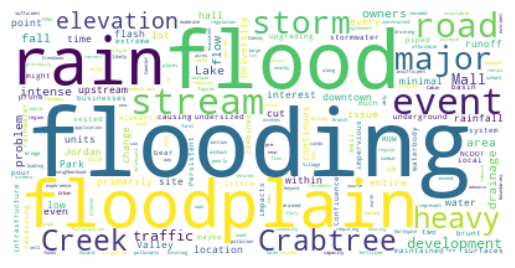

[(0, 2, {'weight': 0.2833333333333333}), (0, 4, {'weight': -0.014761904761904763}), (0, 5, {'weight': 0.2571428571428572}), (0, 8, {'weight': 0.006190476190476191}), (0, 9, {'weight': 0.02238095238095238}), (1, 2, {'weight': 0.08857142857142856}), (1, 4, {'weight': -0.023809523809523808}), (1, 5, {'weight': 0.29095238095238096}), (1, 7, {'weight': -0.007619047619047619}), (1, 8, {'weight': 0.03571428571428571}), (2, 4, {'weight': -0.023809523809523808}), (2, 6, {'weight': 0.06523809523809523}), (3, 1, {'weight': 0.14904761904761907}), (3, 2, {'weight': 0.039523809523809524}), (3, 5, {'weight': 0.024285714285714285}), (3, 6, {'weight': 0.03619047619047619}), (3, 14, {'weight': 0.029523809523809525}), (4, 8, {'weight': 0.03476190476190476}), (5, 2, {'weight': 0.2195238095238095}), (5, 4, {'weight': -0.029523809523809525}), (5, 7, {'weight': 0.08333333333333333}), (5, 8, {'weight': 0.03380952380952381}), (6, 4, {'weight': -0.011428571428571429}), (7, 4, {'weight': -0.07666666666666666}), 

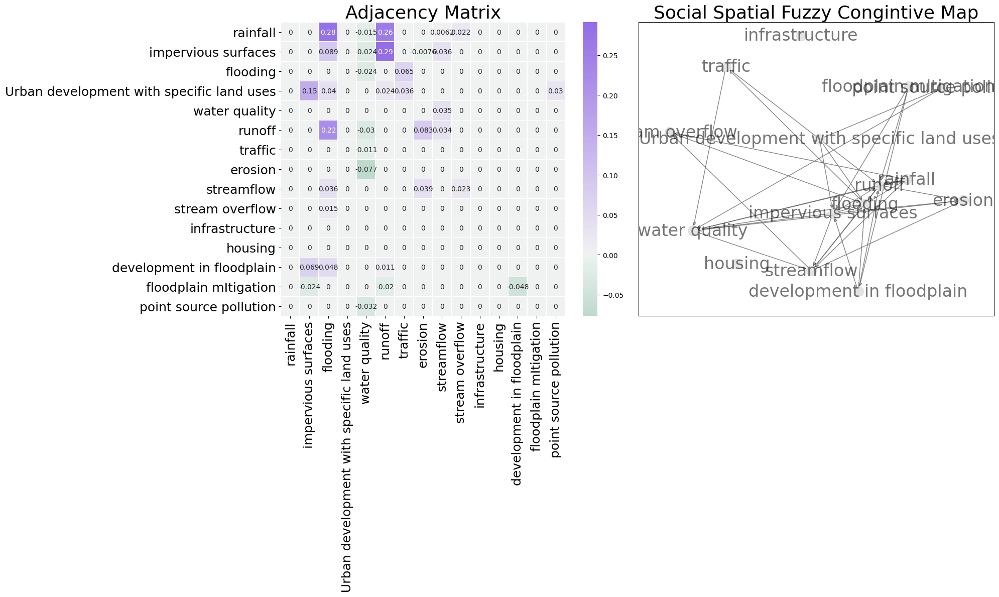

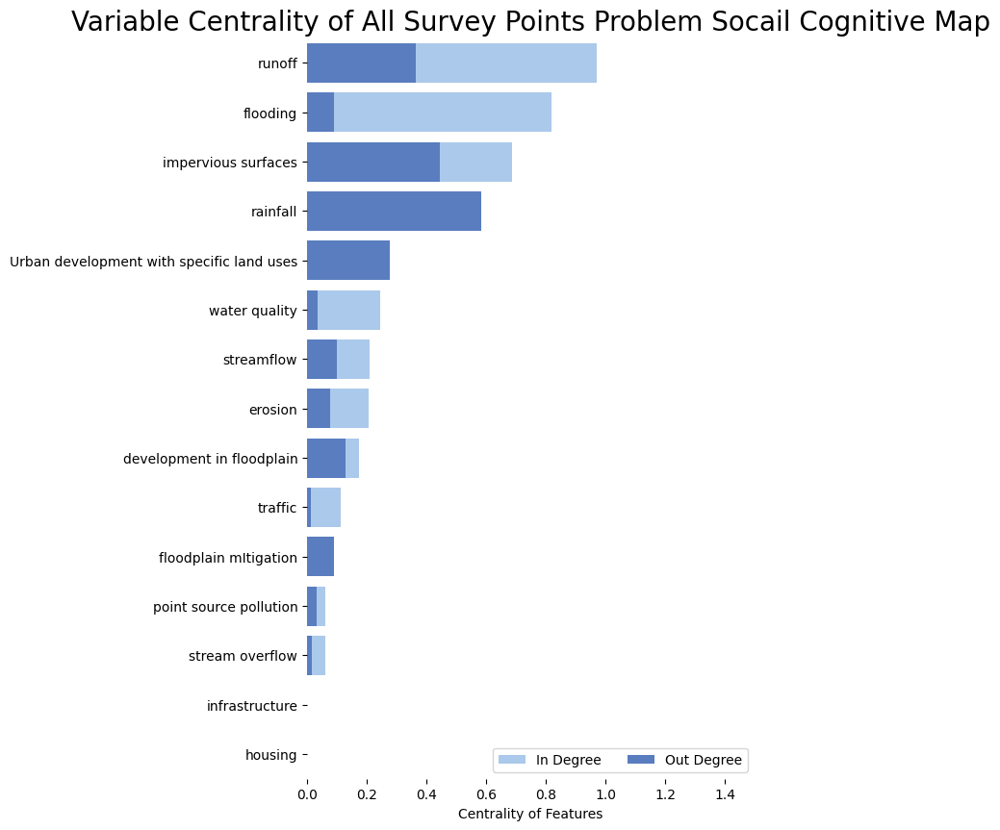

In [137]:
problem_text = " ".join(review for review in df_survey['why_is_this_location_a_problem'])

generate_spatial_fcm(problem_text,df_agg_mean, title="All Survey Points Problem")

### Barrier

Total Original Original Concepts: 126


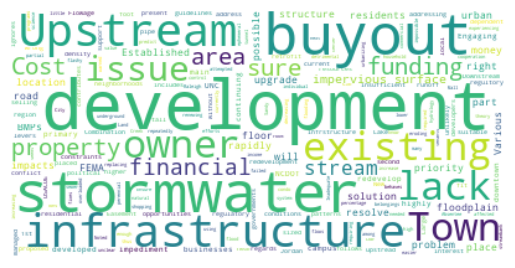

[(0, 2, {'weight': 0.2833333333333333}), (0, 5, {'weight': 0.2571428571428572}), (1, 2, {'weight': 0.08857142857142856}), (1, 5, {'weight': 0.29095238095238096}), (3, 2, {'weight': -0.09047619047619047}), (3, 5, {'weight': -0.05761904761904762}), (4, 1, {'weight': 0.14904761904761907}), (4, 2, {'weight': 0.039523809523809524}), (4, 5, {'weight': 0.024285714285714285}), (4, 7, {'weight': 0.013809523809523808}), (5, 2, {'weight': 0.2195238095238095}), (6, 7, {'weight': 0.03428571428571429}), (7, 5, {'weight': -0.013809523809523808}), (9, 1, {'weight': 0.06857142857142857}), (9, 2, {'weight': 0.047619047619047616}), (9, 5, {'weight': 0.011428571428571429})]
                                           centrality
runoff                                       0.874762
flooding                                     0.769048
impervious surfaces                          0.597143
rainfall                                     0.540476
Urban development with specific land uses    0.226667
SCM          

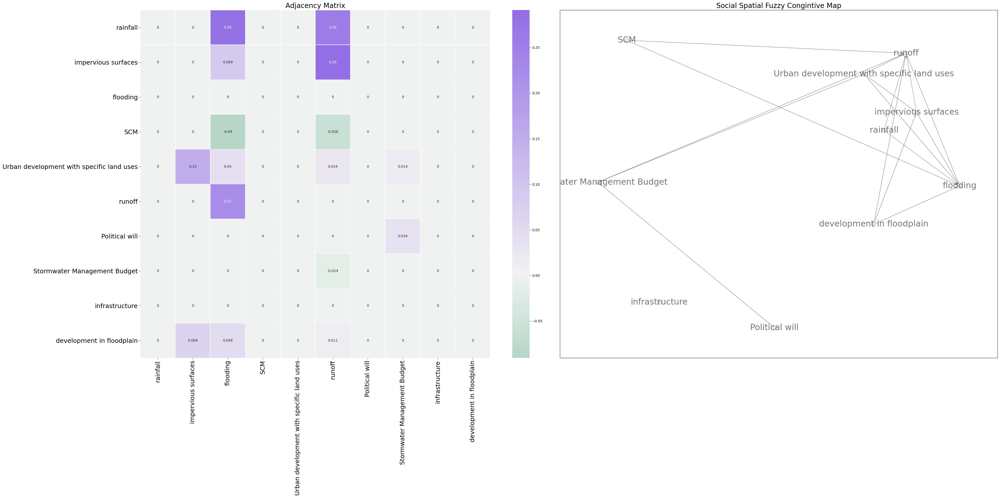

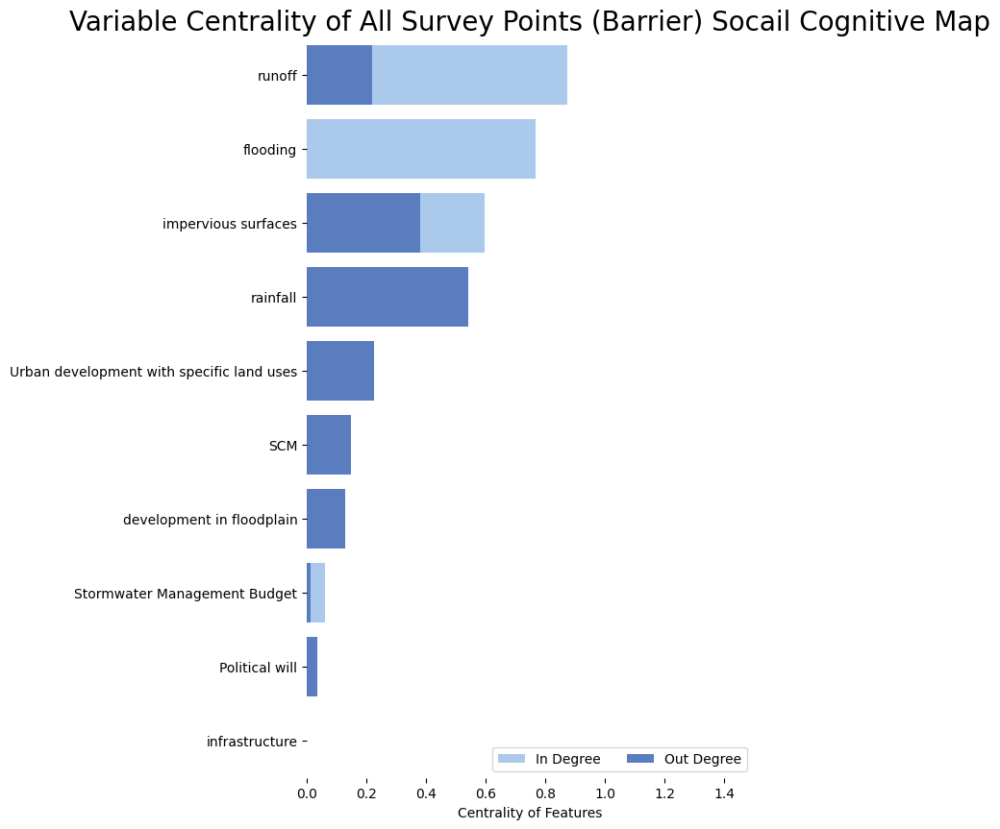

In [106]:
barrier_text = " ".join(review for review in df_survey['what_is_the_greatest_barrier_to'])
generate_spatial_fcm(barrier_text,df_agg_mean,  title="All Survey Points (Barrier)")

### Solution

Total Original Original Concepts: 126


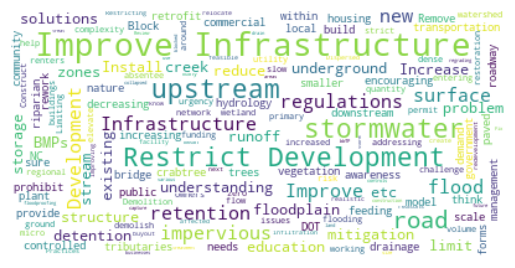

[(0, 3, {'weight': 0.2833333333333333}), (0, 6, {'weight': 0.2571428571428572}), (0, 9, {'weight': 0.004285714285714284}), (0, 10, {'weight': -0.024285714285714285}), (1, 3, {'weight': 0.08857142857142856}), (1, 6, {'weight': 0.29095238095238096}), (1, 9, {'weight': -0.02}), (2, 3, {'weight': 0.0009523809523809532}), (2, 6, {'weight': 0.024285714285714285}), (4, 3, {'weight': -0.09047619047619047}), (4, 6, {'weight': -0.05761904761904762}), (5, 1, {'weight': 0.14904761904761907}), (5, 2, {'weight': -0.032857142857142856}), (5, 3, {'weight': 0.039523809523809524}), (5, 6, {'weight': 0.024285714285714285}), (5, 7, {'weight': 0.013809523809523808}), (5, 9, {'weight': 0.005238095238095238}), (5, 15, {'weight': 0.014761904761904763}), (6, 3, {'weight': 0.2195238095238095}), (7, 6, {'weight': -0.013809523809523808}), (8, 10, {'weight': 0.018571428571428572}), (9, 1, {'weight': -0.010476190476190476}), (9, 6, {'weight': -0.09238095238095238}), (14, 1, {'weight': 0.06857142857142857}), (14, 3,

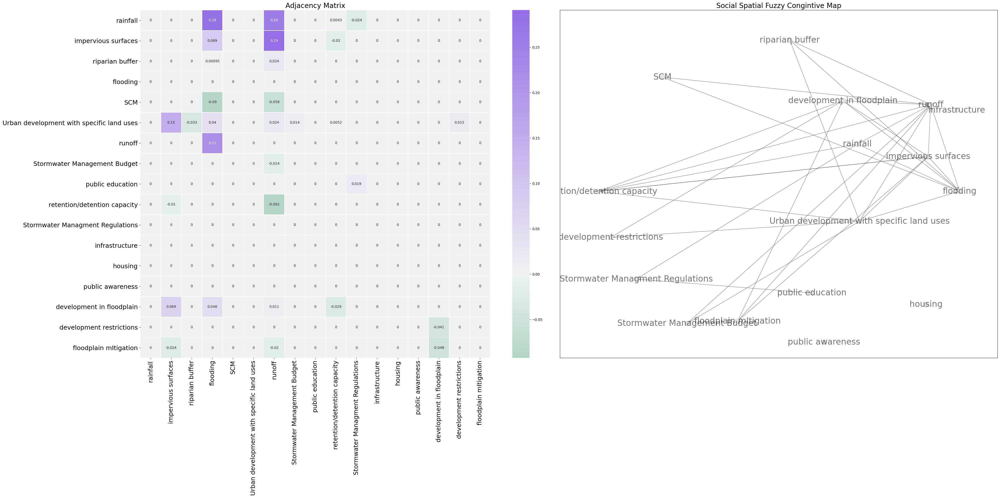

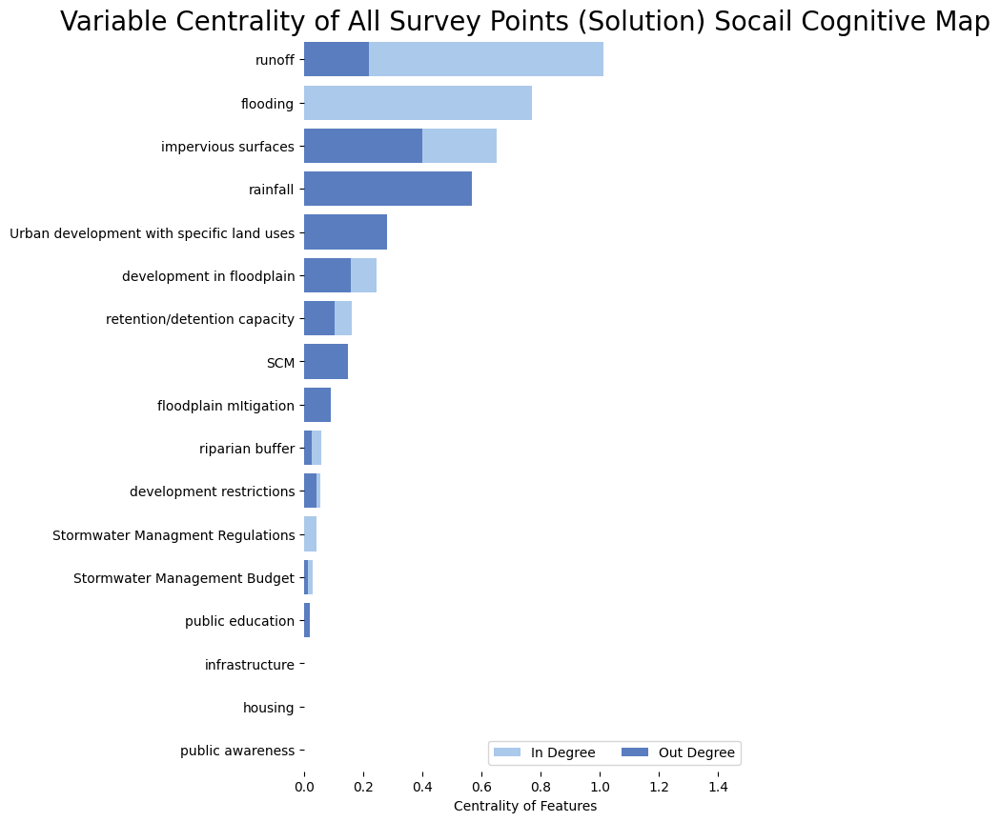

In [107]:
solution_text = " ".join(review for review in df_survey['what_actions_can_be_taken_to_fi'])
generate_spatial_fcm(solution_text,df_agg_mean, title="All Survey Points (Solution)")

### Problem Barrier and Solution Combined

Total Original Original Concepts: 126


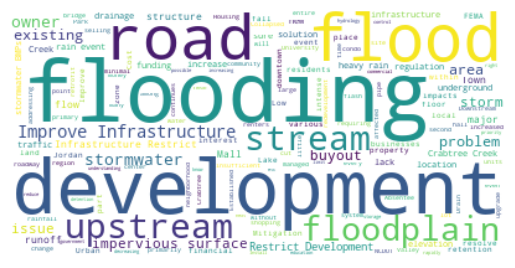

[(0, 3, {'weight': 0.2833333333333333}), (0, 6, {'weight': -0.014761904761904763}), (0, 7, {'weight': 0.2571428571428572}), (0, 11, {'weight': 0.006190476190476191}), (0, 14, {'weight': 0.004285714285714284}), (0, 15, {'weight': -0.024285714285714285}), (0, 16, {'weight': 0.02238095238095238}), (1, 3, {'weight': 0.08857142857142856}), (1, 6, {'weight': -0.023809523809523808}), (1, 7, {'weight': 0.29095238095238096}), (1, 10, {'weight': -0.007619047619047619}), (1, 11, {'weight': 0.03571428571428571}), (1, 14, {'weight': -0.02}), (2, 3, {'weight': 0.0009523809523809532}), (2, 6, {'weight': 0.03333333333333333}), (2, 7, {'weight': 0.024285714285714285}), (3, 6, {'weight': -0.023809523809523808}), (3, 8, {'weight': 0.06523809523809523}), (4, 3, {'weight': -0.09047619047619047}), (4, 6, {'weight': 0.06904761904761905}), (4, 7, {'weight': -0.05761904761904762}), (4, 10, {'weight': -0.02666666666666667}), (4, 11, {'weight': -0.02095238095238095}), (5, 1, {'weight': 0.14904761904761907}), (5,

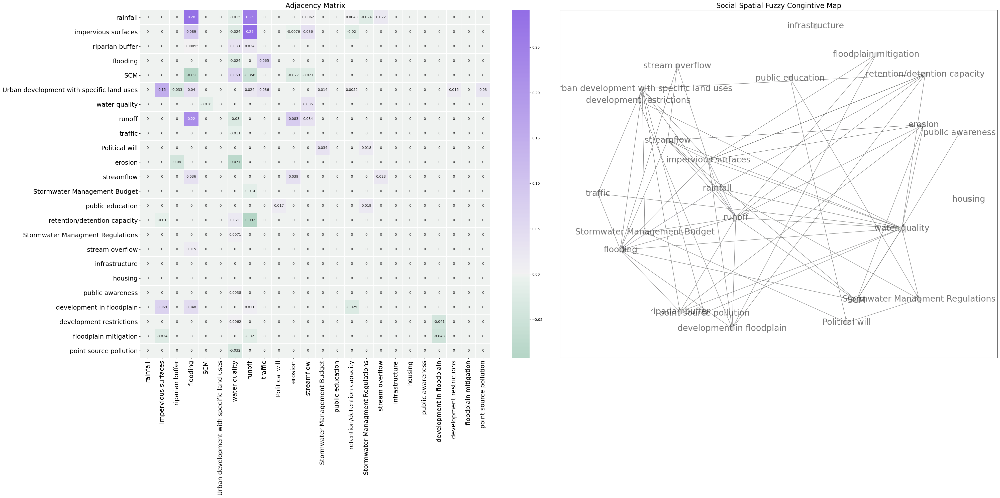

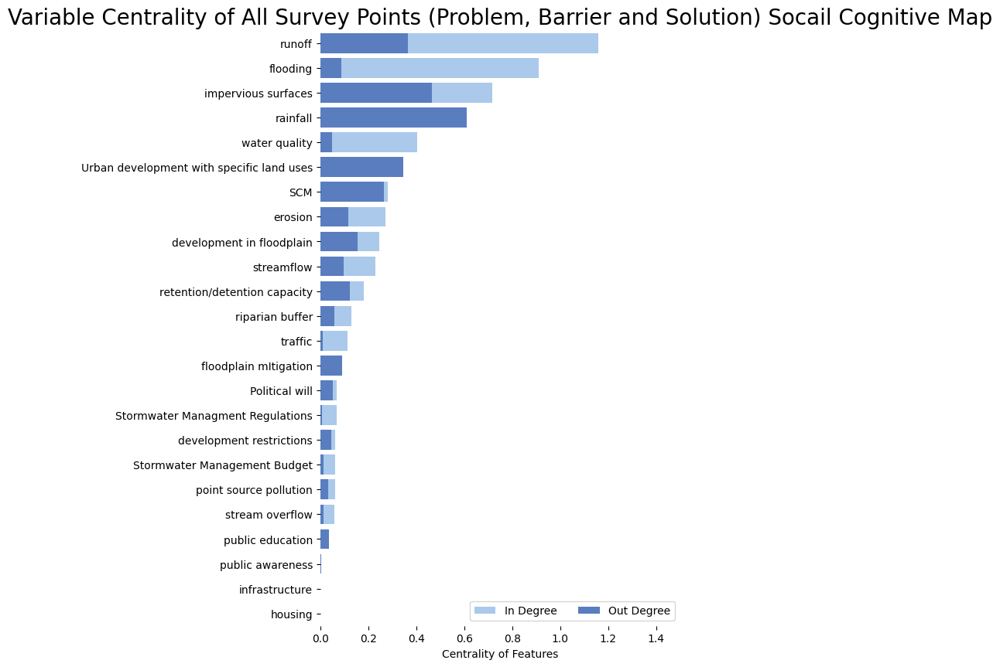

In [108]:
prob_barrier_solution_text = problem_text + barrier_text + solution_text

generate_spatial_fcm(prob_barrier_solution_text,df_agg_mean,  title="All Survey Points (Problem, Barrier and Solution)")

## Social FCM

### Problem

Total Original Original Concepts: 43


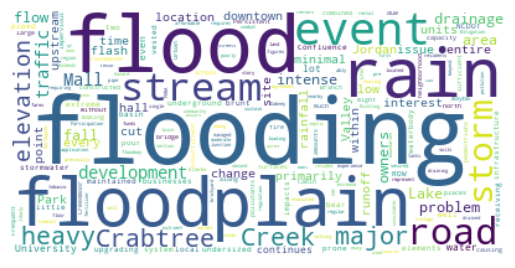

[(0, 5, {'weight': -0.023809523809523808}), (0, 8, {'weight': 0.06523809523809523}), (1, 0, {'weight': 0.08857142857142856}), (1, 3, {'weight': 0.29095238095238096}), (1, 5, {'weight': -0.023809523809523808}), (1, 6, {'weight': 0.03571428571428571}), (1, 7, {'weight': -0.007619047619047619}), (2, 0, {'weight': 0.2833333333333333}), (2, 3, {'weight': 0.2571428571428572}), (2, 5, {'weight': -0.014761904761904763}), (2, 6, {'weight': 0.006190476190476191}), (2, 10, {'weight': 0.02238095238095238}), (3, 0, {'weight': 0.2195238095238095}), (3, 5, {'weight': -0.029523809523809525}), (3, 6, {'weight': 0.03380952380952381}), (3, 7, {'weight': 0.08333333333333333}), (4, 0, {'weight': 0.039523809523809524}), (4, 1, {'weight': 0.14904761904761907}), (4, 3, {'weight': 0.024285714285714285}), (4, 8, {'weight': 0.03619047619047619}), (5, 6, {'weight': 0.03476190476190476}), (6, 0, {'weight': 0.03619047619047619}), (6, 7, {'weight': 0.039047619047619046}), (6, 10, {'weight': 0.023333333333333334}), (

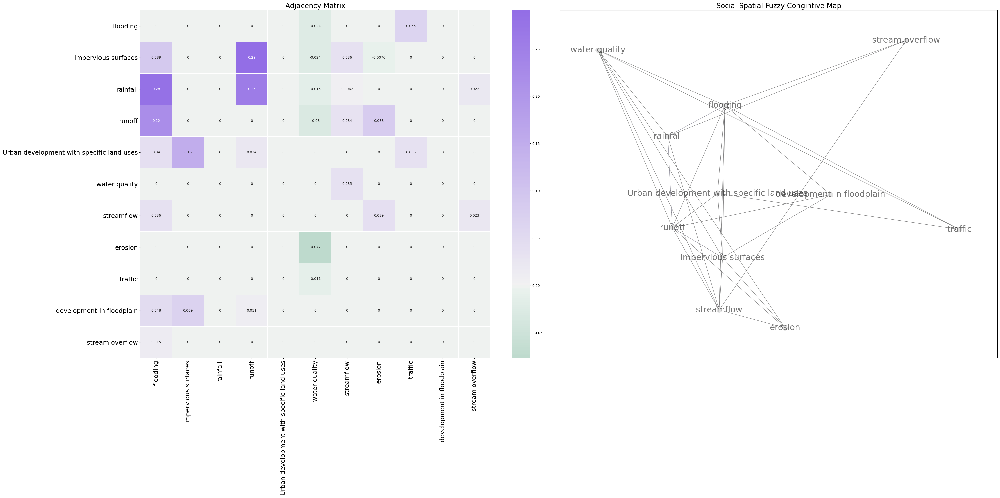

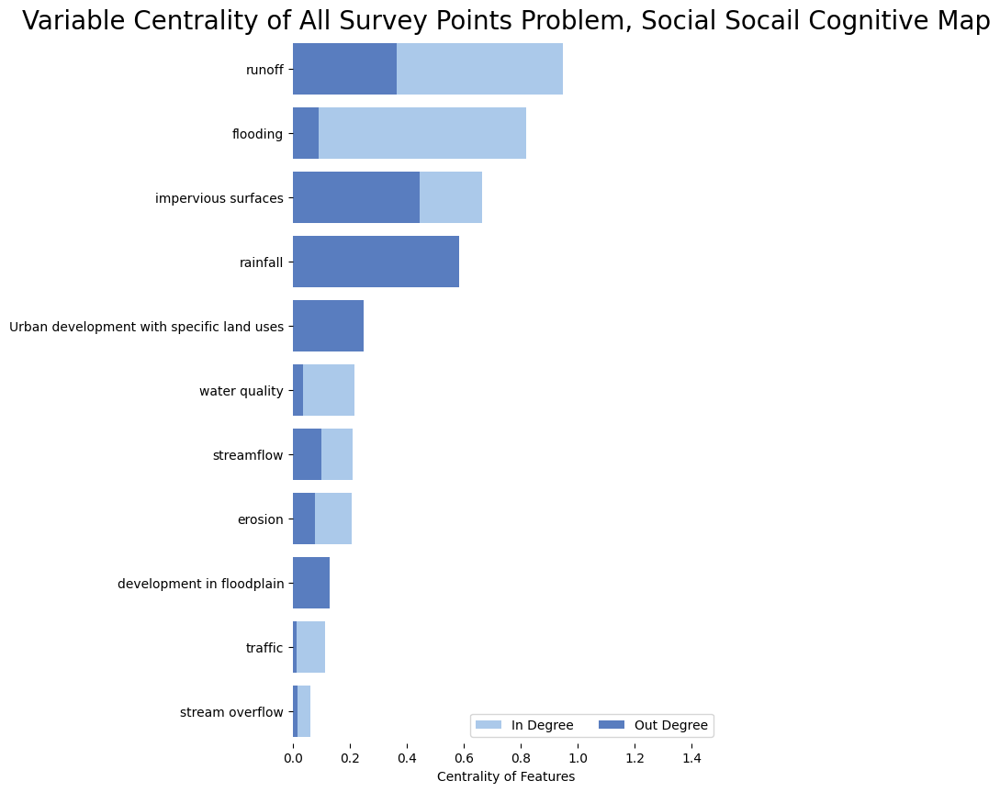

In [109]:
problem_text = " ".join(review for review in df_survey['why_is_this_location_a_problem'])

generate_spatial_fcm(problem_text,df_all_fcm_agg_mean_reduced, title="All Survey Points Problem, Social")

### Barrier

Total Original Original Concepts: 43


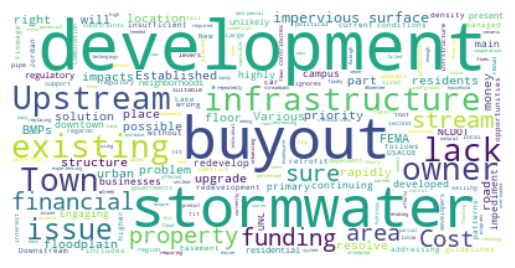

[(1, 0, {'weight': 0.08857142857142856}), (1, 3, {'weight': 0.29095238095238096}), (2, 0, {'weight': 0.2833333333333333}), (2, 3, {'weight': 0.2571428571428572}), (3, 0, {'weight': 0.2195238095238095}), (4, 0, {'weight': 0.039523809523809524}), (4, 1, {'weight': 0.14904761904761907}), (4, 3, {'weight': 0.024285714285714285}), (4, 8, {'weight': 0.013809523809523808}), (5, 8, {'weight': 0.03428571428571429}), (6, 0, {'weight': -0.09047619047619047}), (6, 3, {'weight': -0.05761904761904762}), (7, 0, {'weight': 0.047619047619047616}), (7, 1, {'weight': 0.06857142857142857}), (7, 3, {'weight': 0.011428571428571429}), (8, 3, {'weight': -0.013809523809523808})]
                                           centrality
runoff                                       0.874762
flooding                                     0.769048
impervious surfaces                          0.597143
rainfall                                     0.540476
Urban development with specific land uses    0.226667
SCM          

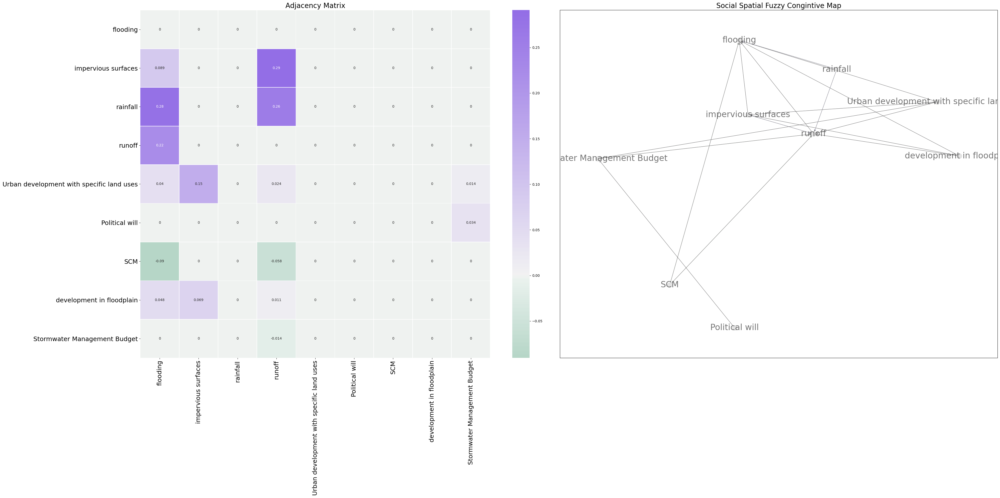

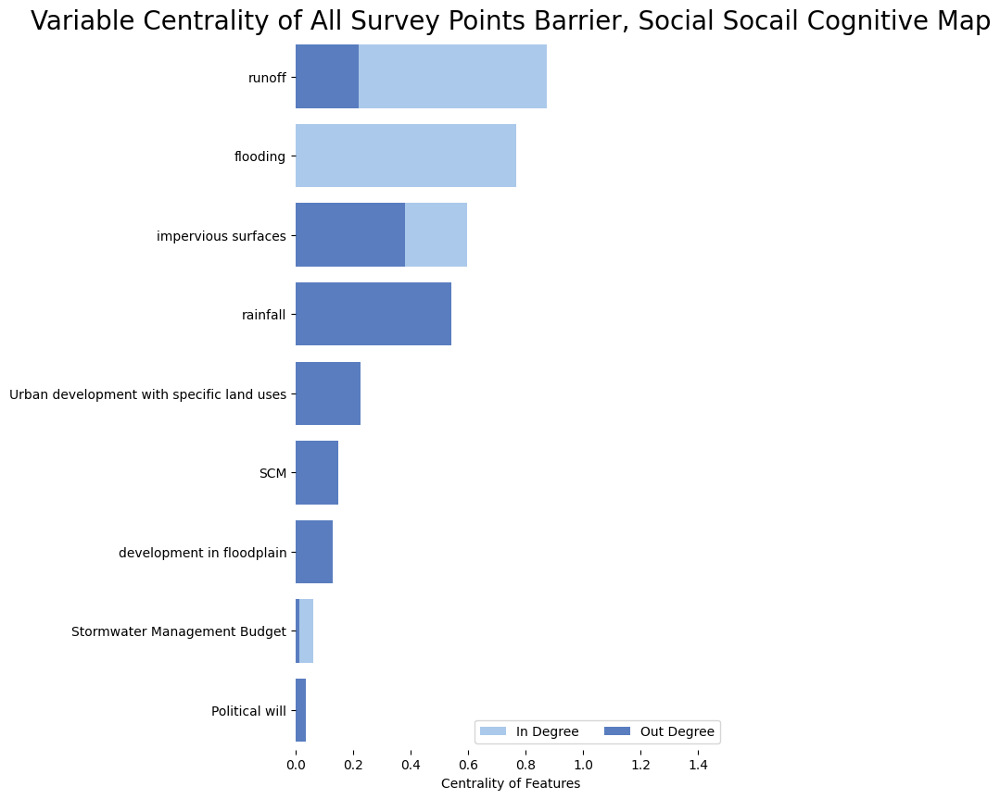

In [110]:
barrier_text = " ".join(review for review in df_survey['what_is_the_greatest_barrier_to'])
generate_spatial_fcm(barrier_text,df_all_fcm_agg_mean_reduced, title="All Survey Points Barrier, Social")

### Solution

Total Original Original Concepts: 43


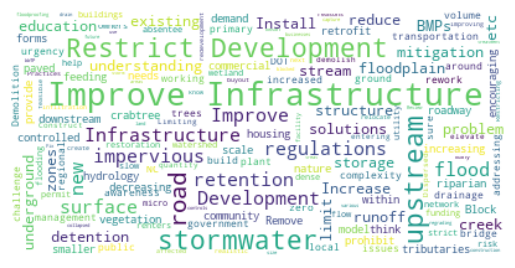

[(1, 0, {'weight': 0.08857142857142856}), (1, 3, {'weight': 0.29095238095238096}), (1, 5, {'weight': -0.02}), (2, 0, {'weight': 0.2833333333333333}), (2, 3, {'weight': 0.2571428571428572}), (2, 5, {'weight': 0.004285714285714284}), (2, 10, {'weight': -0.024285714285714285}), (3, 0, {'weight': 0.2195238095238095}), (4, 0, {'weight': 0.039523809523809524}), (4, 1, {'weight': 0.14904761904761907}), (4, 3, {'weight': 0.024285714285714285}), (4, 5, {'weight': 0.005238095238095238}), (4, 7, {'weight': 0.014761904761904763}), (4, 8, {'weight': -0.032857142857142856}), (4, 11, {'weight': 0.013809523809523808}), (5, 1, {'weight': -0.010476190476190476}), (5, 3, {'weight': -0.09238095238095238}), (6, 0, {'weight': -0.09047619047619047}), (6, 3, {'weight': -0.05761904761904762}), (7, 9, {'weight': -0.04095238095238095}), (8, 0, {'weight': 0.0009523809523809532}), (8, 3, {'weight': 0.024285714285714285}), (9, 0, {'weight': 0.047619047619047616}), (9, 1, {'weight': 0.06857142857142857}), (9, 3, {'w

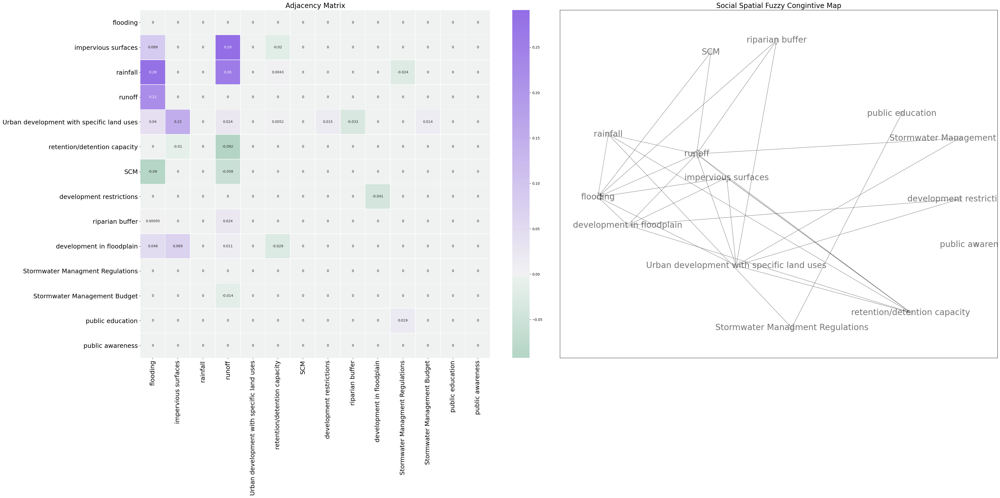

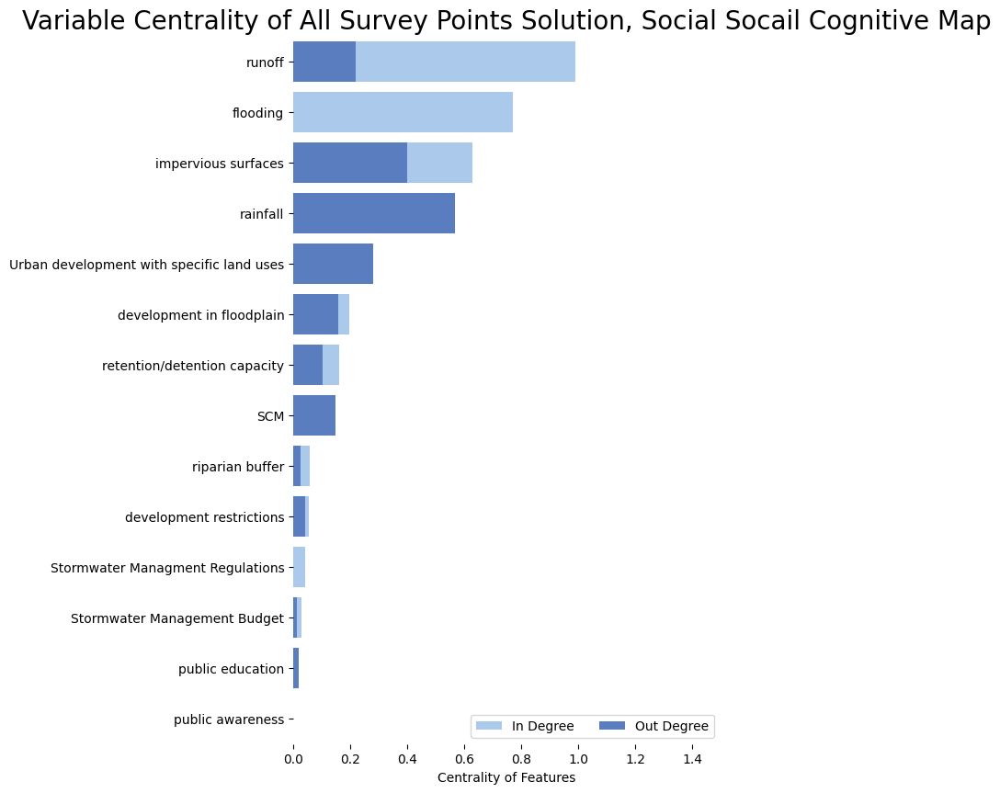

In [111]:
solution_text = " ".join(review for review in df_survey['what_actions_can_be_taken_to_fi'])
generate_spatial_fcm(solution_text,df_all_fcm_agg_mean_reduced, title="All Survey Points Solution, Social")

### Problem, Barrier and Solution Combined

Total Original Original Concepts: 43


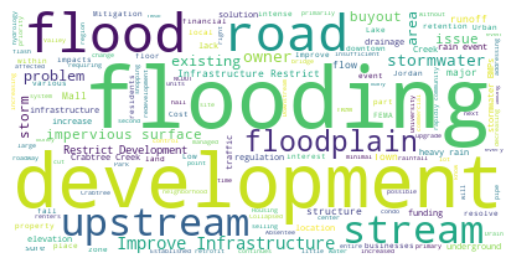

[(0, 5, {'weight': -0.023809523809523808}), (0, 11, {'weight': 0.06523809523809523}), (1, 0, {'weight': 0.08857142857142856}), (1, 3, {'weight': 0.29095238095238096}), (1, 5, {'weight': -0.023809523809523808}), (1, 6, {'weight': -0.02}), (1, 8, {'weight': 0.03571428571428571}), (1, 9, {'weight': -0.007619047619047619}), (2, 0, {'weight': 0.2833333333333333}), (2, 3, {'weight': 0.2571428571428572}), (2, 5, {'weight': -0.014761904761904763}), (2, 6, {'weight': 0.004285714285714284}), (2, 8, {'weight': 0.006190476190476191}), (2, 15, {'weight': -0.024285714285714285}), (2, 18, {'weight': 0.02238095238095238}), (3, 0, {'weight': 0.2195238095238095}), (3, 5, {'weight': -0.029523809523809525}), (3, 8, {'weight': 0.03380952380952381}), (3, 9, {'weight': 0.08333333333333333}), (4, 0, {'weight': 0.039523809523809524}), (4, 1, {'weight': 0.14904761904761907}), (4, 3, {'weight': 0.024285714285714285}), (4, 6, {'weight': 0.005238095238095238}), (4, 11, {'weight': 0.03619047619047619}), (4, 12, {'w

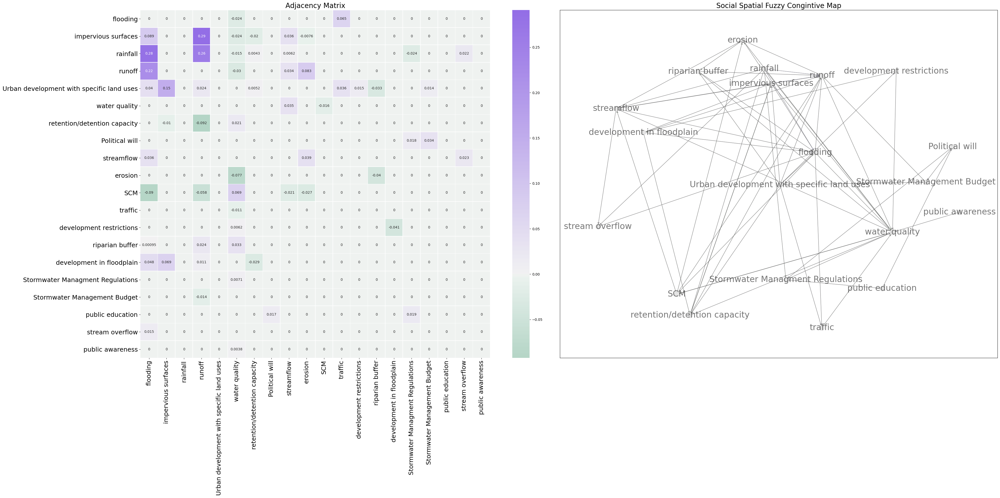

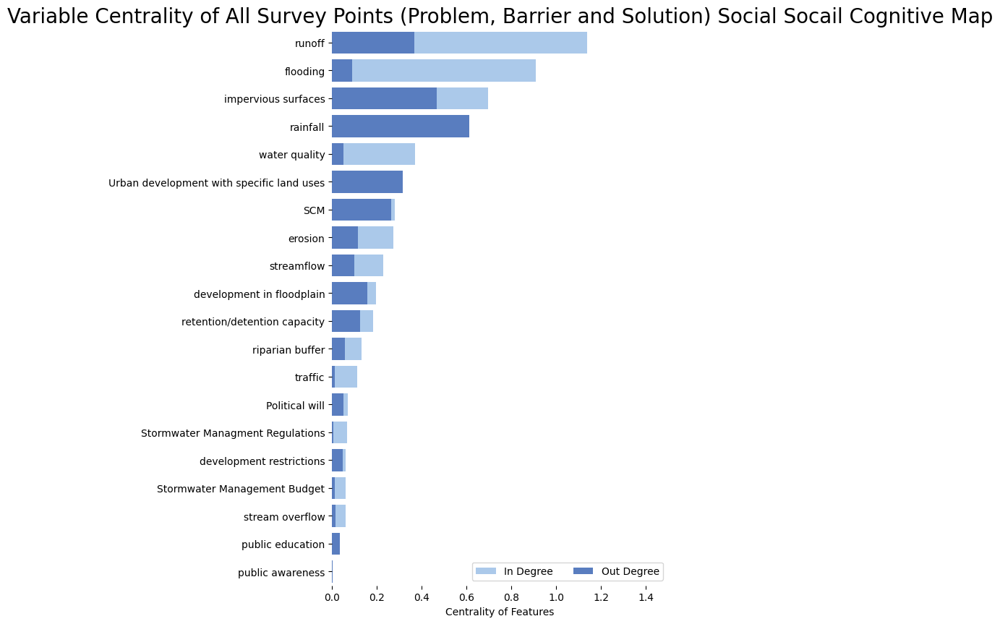

In [112]:
prob_barrier_solution_text = problem_text + barrier_text + solution_text

generate_spatial_fcm(prob_barrier_solution_text,df_all_fcm_agg_mean_reduced, title="All Survey Points (Problem, Barrier and Solution) Social")

## Gov Social FCM

### Problem

Total Original Original Concepts: 25


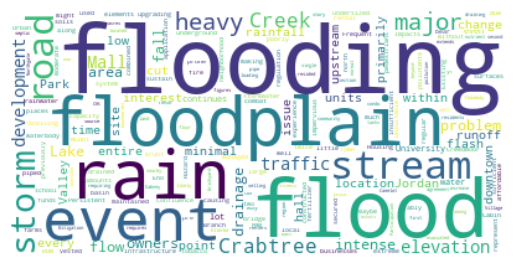

[(0, 1, {'weight': 0.136}), (0, 3, {'weight': 0.287}), (0, 5, {'weight': -0.05}), (0, 8, {'weight': 0.041999999999999996}), (1, 5, {'weight': -0.05}), (1, 6, {'weight': 0.104}), (2, 0, {'weight': 0.29200000000000004}), (2, 1, {'weight': 0.08299999999999999}), (2, 3, {'weight': 0.051000000000000004}), (2, 6, {'weight': 0.076}), (3, 1, {'weight': 0.119}), (3, 5, {'weight': -0.062}), (3, 7, {'weight': 0.053000000000000005}), (4, 1, {'weight': 0.172}), (4, 3, {'weight': 0.255}), (6, 5, {'weight': -0.024}), (7, 5, {'weight': -0.09}), (8, 1, {'weight': 0.076}), (8, 7, {'weight': 0.08199999999999999}), (9, 0, {'weight': 0.044}), (9, 3, {'weight': 0.024})]
                                           centrality
impervious surfaces                             0.851
runoff                                          0.851
flooding                                        0.740
Urban development with specific land uses       0.502
rainfall                                        0.427
water quality      

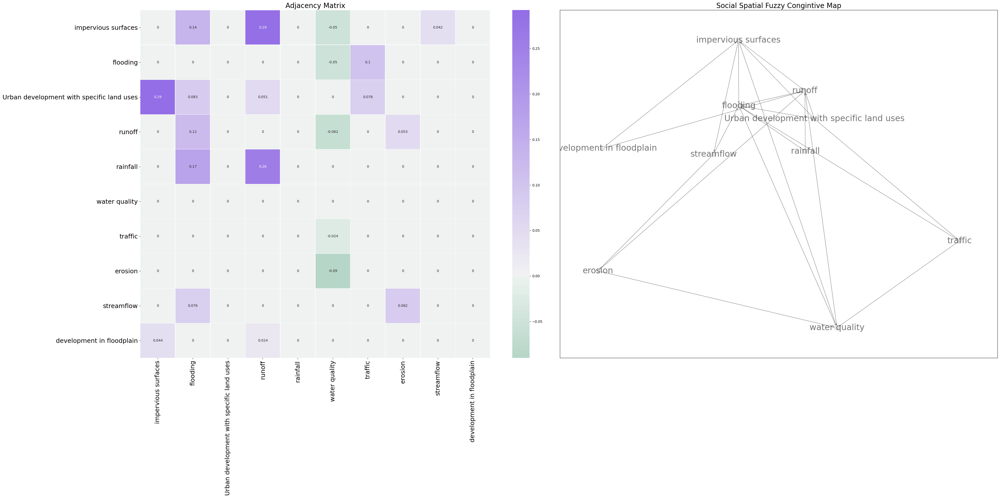

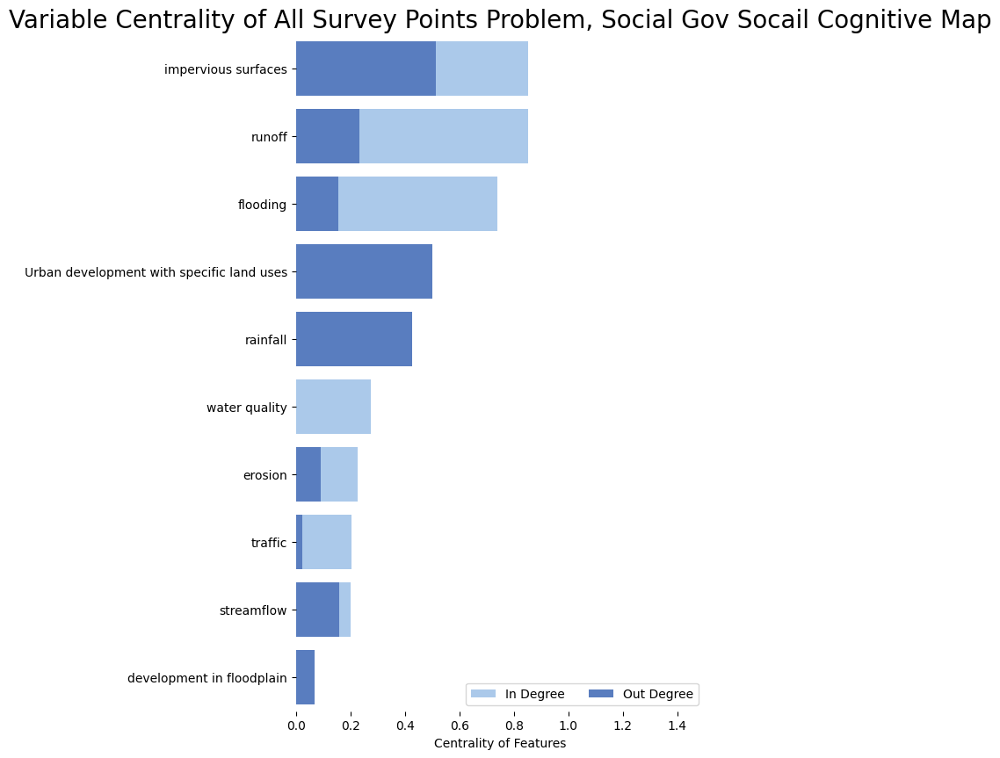

In [113]:
generate_spatial_fcm(problem_text,df_agg_mean_gov, title="All Survey Points Problem, Social Gov")

### Barrier

Total Original Original Concepts: 25


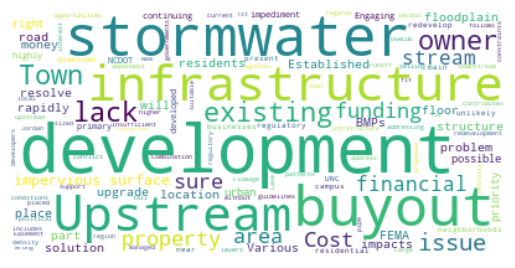

[(0, 1, {'weight': 0.136}), (0, 3, {'weight': 0.287}), (2, 0, {'weight': 0.29200000000000004}), (2, 1, {'weight': 0.08299999999999999}), (2, 3, {'weight': 0.051000000000000004}), (3, 1, {'weight': 0.119}), (4, 1, {'weight': 0.172}), (4, 3, {'weight': 0.255}), (5, 0, {'weight': 0.044}), (5, 3, {'weight': 0.024}), (6, 1, {'weight': -0.064}), (6, 3, {'weight': -0.068})]
                                           centrality
runoff                                          0.804
impervious surfaces                             0.759
flooding                                        0.574
rainfall                                        0.427
Urban development with specific land uses       0.426
SCM                                             0.132
development in floodplain                       0.068
Political will                                  0.000


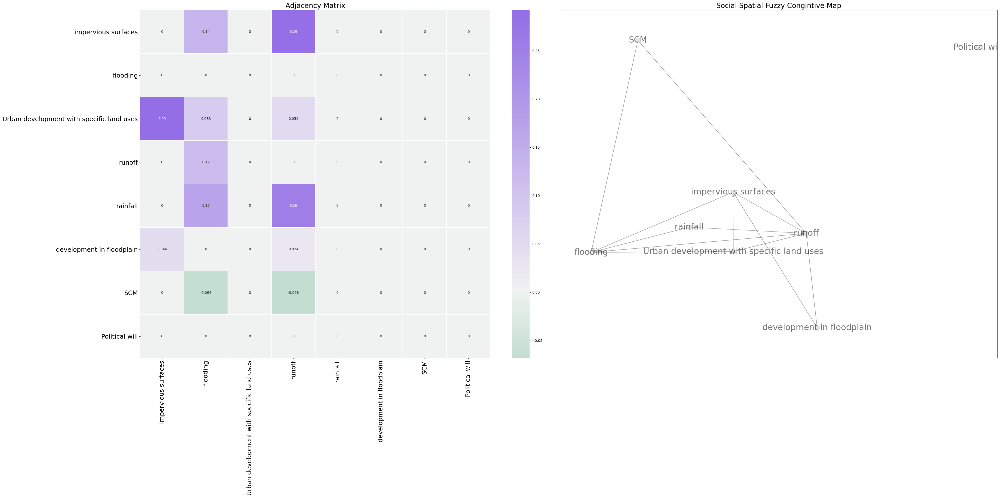

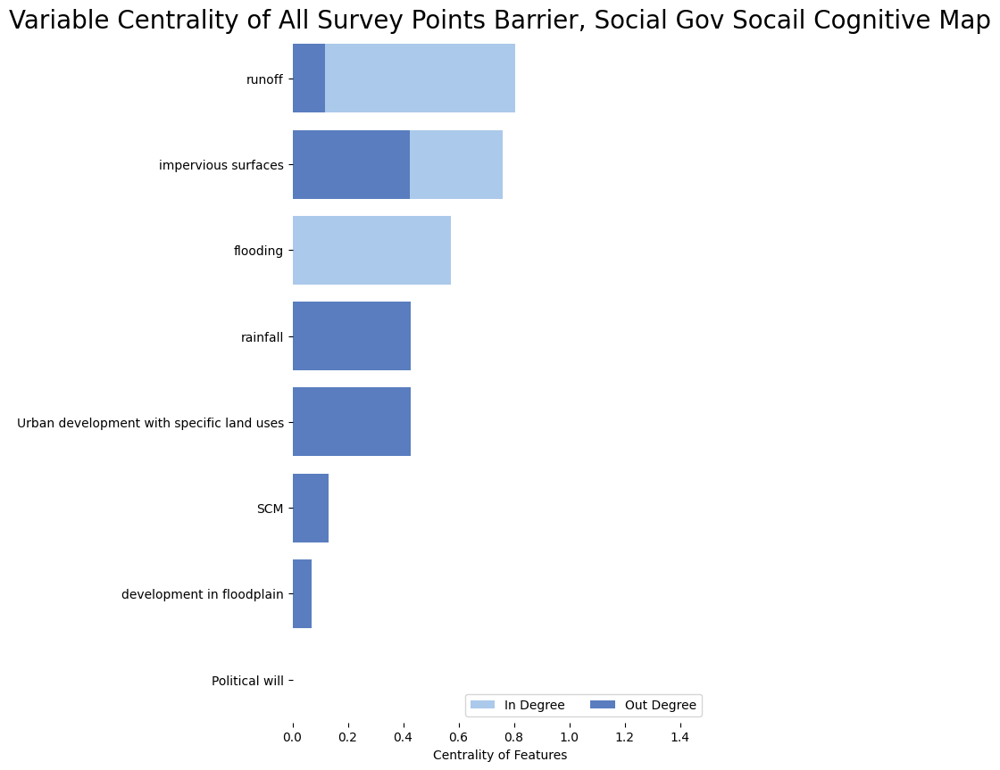

In [114]:

generate_spatial_fcm(barrier_text,df_agg_mean_gov, title="All Survey Points Barrier, Social Gov")

### Solution

Total Original Original Concepts: 25


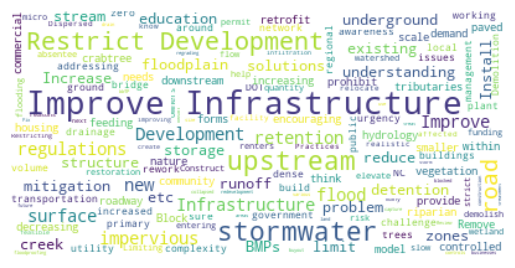

[(0, 1, {'weight': 0.136}), (0, 3, {'weight': 0.287}), (0, 5, {'weight': -0.041999999999999996}), (2, 0, {'weight': 0.29200000000000004}), (2, 1, {'weight': 0.08299999999999999}), (2, 3, {'weight': 0.051000000000000004}), (2, 5, {'weight': 0.011}), (2, 6, {'weight': 0.031}), (3, 1, {'weight': 0.119}), (4, 1, {'weight': 0.172}), (4, 3, {'weight': 0.255}), (4, 5, {'weight': -0.052000000000000005}), (5, 0, {'weight': -0.022}), (5, 3, {'weight': -0.094}), (6, 7, {'weight': -0.086}), (7, 0, {'weight': 0.044}), (7, 3, {'weight': 0.024}), (7, 5, {'weight': -0.061}), (8, 1, {'weight': -0.064}), (8, 3, {'weight': -0.068})]
                                           centrality
runoff                                          0.898
impervious surfaces                             0.823
flooding                                        0.574
rainfall                                        0.479
Urban development with specific land uses       0.468
retention/detention capacity                    0.282


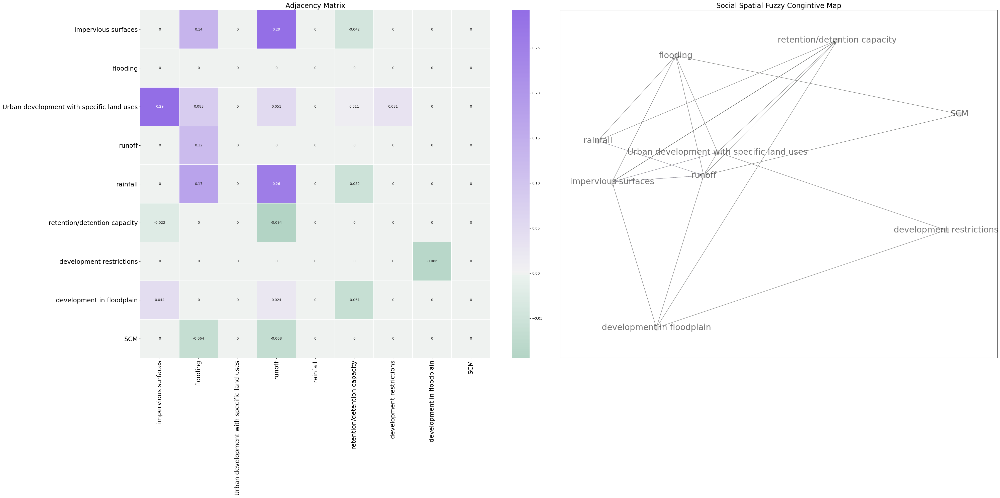

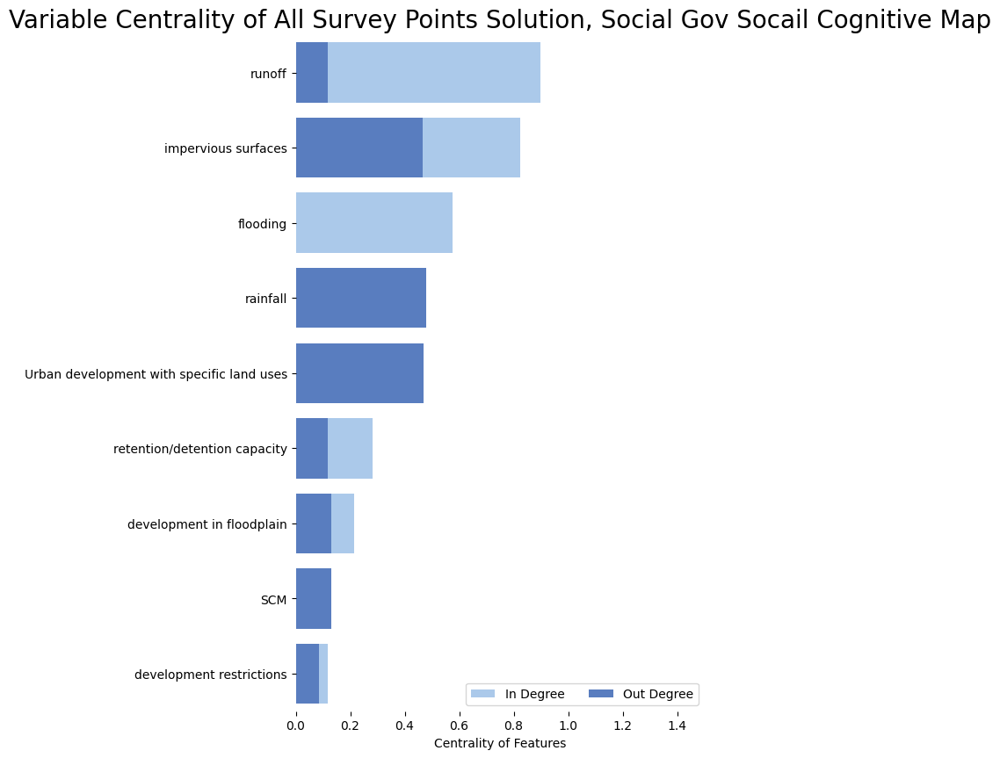

In [115]:
generate_spatial_fcm(solution_text,df_agg_mean_gov, title="All Survey Points Solution, Social Gov")

### Problem, Barrier and Solution Combined

Total Original Original Concepts: 25


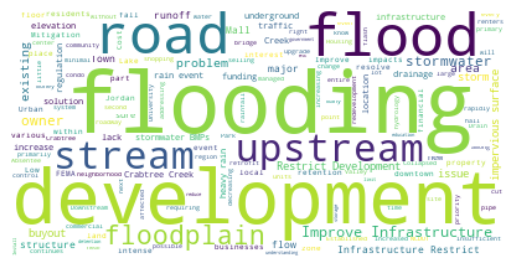

[(0, 1, {'weight': 0.136}), (0, 3, {'weight': 0.287}), (0, 5, {'weight': -0.05}), (0, 8, {'weight': -0.041999999999999996}), (0, 10, {'weight': 0.041999999999999996}), (1, 5, {'weight': -0.05}), (1, 6, {'weight': 0.104}), (2, 0, {'weight': 0.29200000000000004}), (2, 1, {'weight': 0.08299999999999999}), (2, 3, {'weight': 0.051000000000000004}), (2, 6, {'weight': 0.076}), (2, 8, {'weight': 0.011}), (2, 9, {'weight': 0.031}), (3, 1, {'weight': 0.119}), (3, 5, {'weight': -0.062}), (3, 7, {'weight': 0.053000000000000005}), (4, 1, {'weight': 0.172}), (4, 3, {'weight': 0.255}), (4, 8, {'weight': -0.052000000000000005}), (6, 5, {'weight': -0.024}), (7, 5, {'weight': -0.09}), (8, 0, {'weight': -0.022}), (8, 3, {'weight': -0.094}), (9, 5, {'weight': 0.013000000000000001}), (9, 11, {'weight': -0.086}), (10, 1, {'weight': 0.076}), (10, 7, {'weight': 0.08199999999999999}), (11, 0, {'weight': 0.044}), (11, 3, {'weight': 0.024}), (11, 8, {'weight': -0.061}), (12, 1, {'weight': -0.064}), (12, 3, {'wei

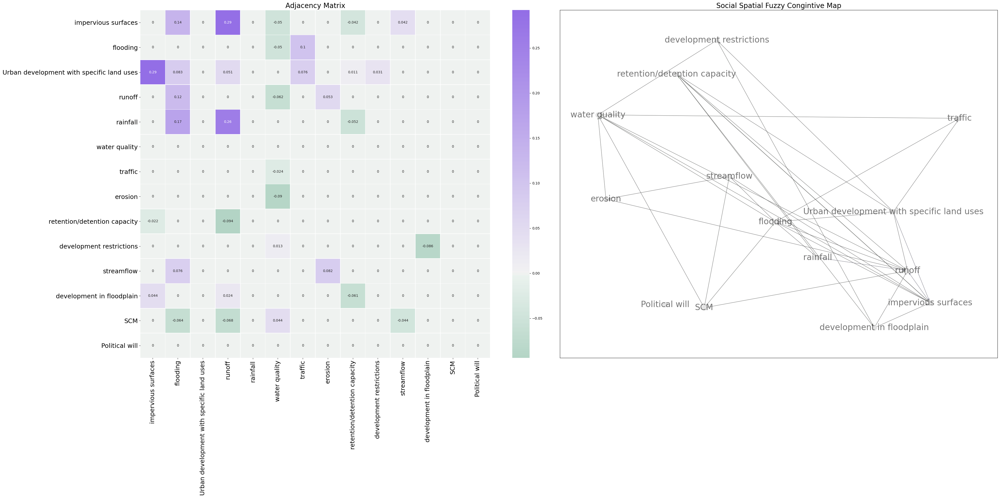

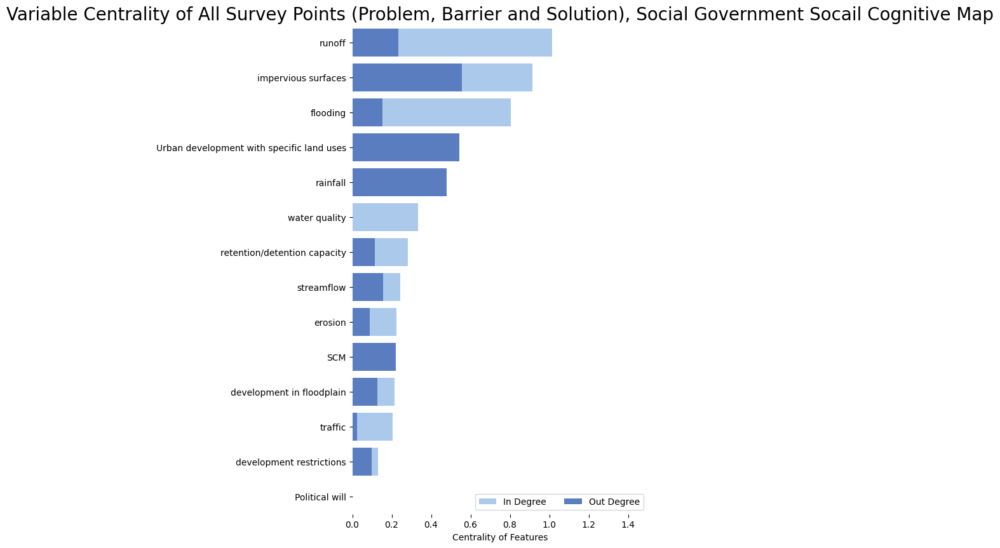

In [116]:
problem_barrier_solution_text = problem_text + barrier_text + solution_text
generate_spatial_fcm(problem_barrier_solution_text,df_agg_mean_gov, title="All Survey Points (Problem, Barrier and Solution), Social Government")

## Academic Social FCM

#### Problem, Barrier and Solution

Total Original Original Concepts: 8


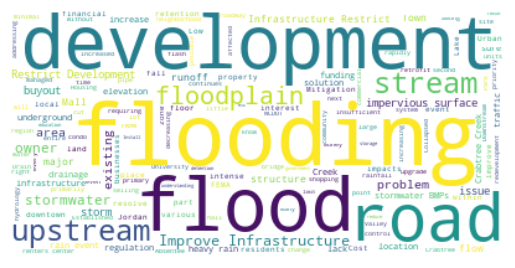

[(0, 1, {'weight': 0.32571428571428573}), (0, 2, {'weight': -0.04428571428571428}), (0, 4, {'weight': 0.23857142857142857}), (0, 5, {'weight': 0.08714285714285715}), (3, 4, {'weight': 0.14285714285714285}), (4, 1, {'weight': 0.2057142857142857}), (5, 2, {'weight': 0.06285714285714286}), (5, 4, {'weight': -0.14285714285714285})]
                              centrality
runoff                          0.730000
rainfall                        0.695714
flooding                        0.531429
retention/detention capacity    0.292857
impervious surfaces             0.142857
water quality                   0.107143


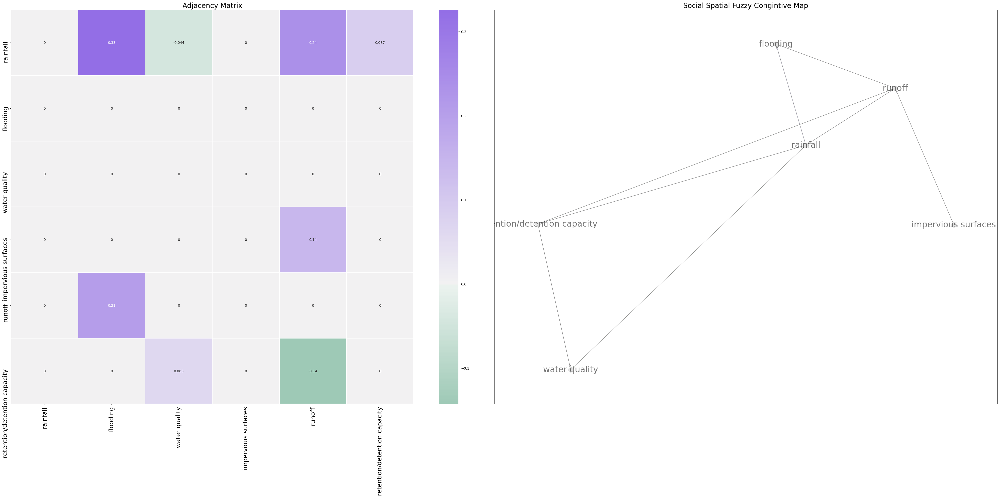

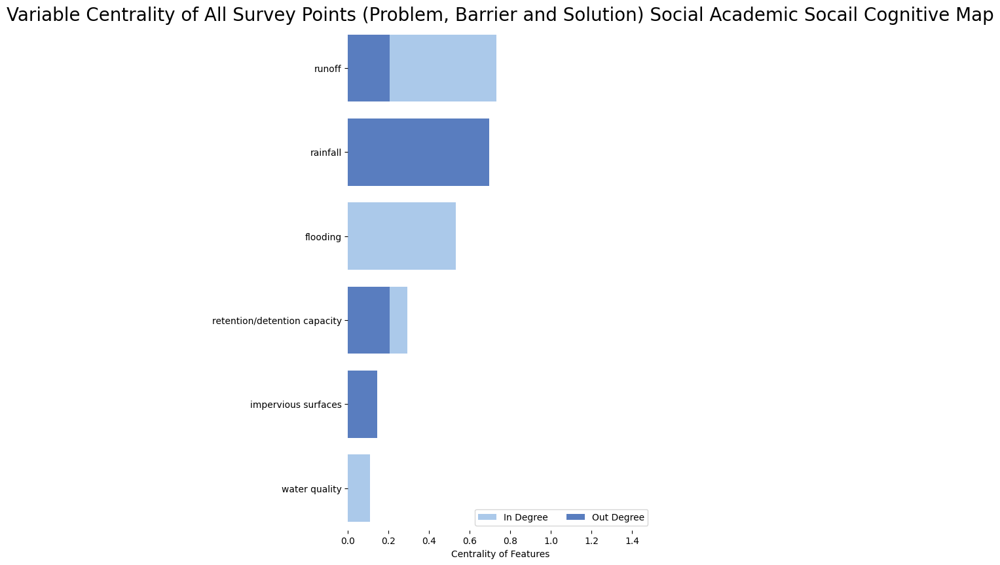

In [117]:
problem_barrier_solution_text = problem_text + barrier_text + solution_text
generate_spatial_fcm(problem_barrier_solution_text,df_agg_mean_academic_reduced, title="All Survey Points (Problem, Barrier and Solution) Social Academic")

## Cluster 2 (Crabtree Valley Mall)

In [291]:
cluster_1 = df_survey[df_survey['clusters'] == 1] #crabtree valley

### Survey Summary Statistics

In [318]:
cluster_1[['challenge_scaled', 'serious_scaled', 'impact_extent_scaled', 'driver_extent_scaled', 'how_often_scaled', 'how_long_scaled', 'when_will_this_problem_exist_']].describe()

,challenge_scaled,serious_scaled,impact_extent_scaled,driver_extent_scaled,how_often_scaled,how_long_scaled
count,6.000000,6.000000,6.000000,6.000000,6.0,6.000000
mean,4.333333,1.166667,1.500000,1.333333,3.0,0.500000
std,0.816497,0.408248,0.547723,0.516398,0.0,0.547723
min,3.000000,1.000000,1.000000,1.000000,3.0,0.000000
25%,4.000000,1.000000,1.000000,1.000000,3.0,0.000000
50%,4.500000,1.000000,1.500000,1.000000,3.0,0.500000
75%,5.000000,1.000000,2.000000,1.750000,3.0,1.000000
max,5.000000,2.000000,2.000000,2.000000,3.0,1.000000


### When will this Problem Exist?

No handles with labels found to put in legend.


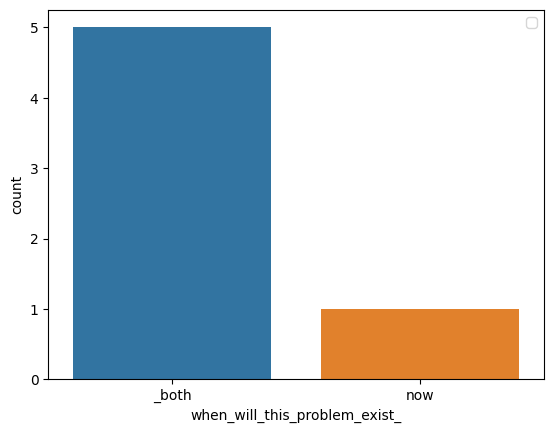

In [320]:
fig, ax1 = plt.subplots(ncols=1)
sns.countplot(x='when_will_this_problem_exist_',
              data=cluster_1, orient='v')
plt.legend(loc='upper right')
# plt.savefig(os.path.join(save_location, "how_challenging_driver_scale.png"), bbox_inches="tight")

### Whats the Purpose of the Game?



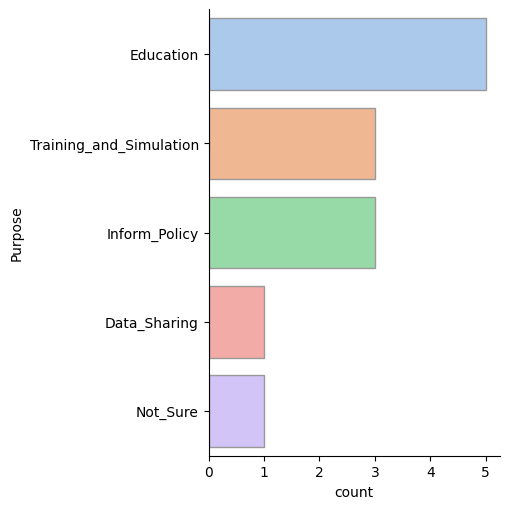

In [354]:
gamePurpose(cluster_1)

### What type of Game?


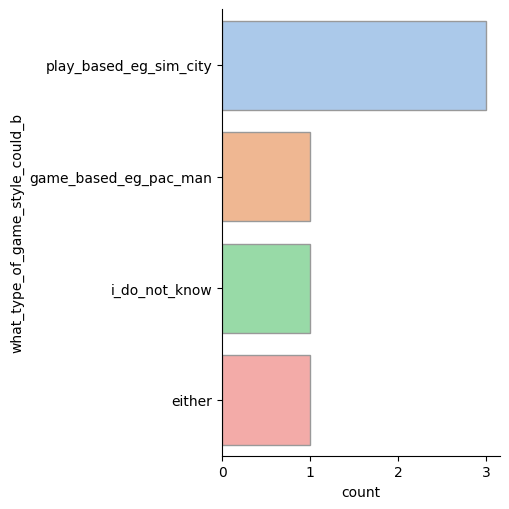

In [356]:
sns.catplot(y="what_type_of_game_style_could_b", kind="count",palette="pastel", edgecolor=".6",data=cluster_1)

### FCM and Wordcloud

#### Problem

In [398]:
for review in cluster_1['why_is_this_location_a_problem']:
  print(review)

Flooding after every heavy rain event.
Too much development and impervious surfaces in a floodplain.
Frequent flooding along Crabtree Creek near Crabtree Valley Mall. 
Crabtree Creek floods Creedmoor Road during large or intense rainfall amounts.  Road was constructed in the floodplain without sufficient flow capacity under the bridge and insufficient road elevation.
Crabtree valley mall floods all the time
During even minor storms this area floods; In intense storm/rain it may impede traffic; Certainly, properties  in the surroundings are impacted too.


Total Original Original Concepts: 126


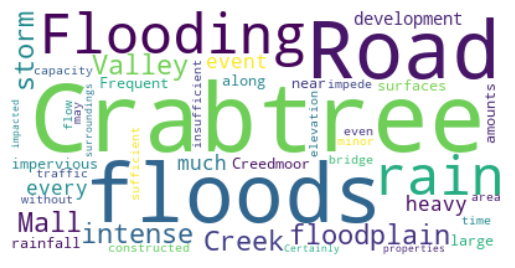

[(0, 2, {'weight': 0.2833333333333333}), (1, 2, {'weight': 0.08857142857142856}), (2, 4, {'weight': 0.06523809523809523}), (3, 1, {'weight': 0.14904761904761907}), (3, 2, {'weight': 0.039523809523809524}), (3, 4, {'weight': 0.03619047619047619}), (5, 1, {'weight': -0.023809523809523808})]
                                           centrality
flooding                                     0.476667
rainfall                                     0.283333
impervious surfaces                          0.261429
Urban development with specific land uses    0.224762
traffic                                      0.101429
floodplain mItigation                        0.023810


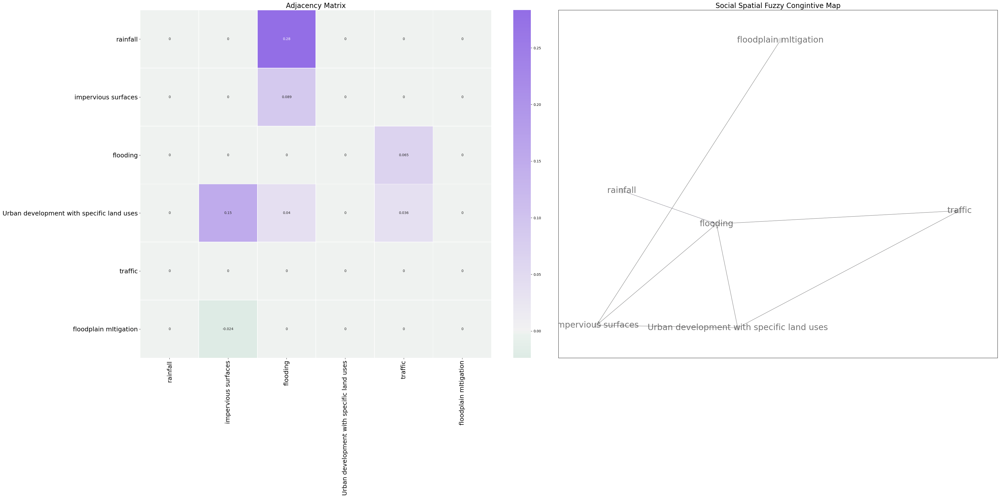

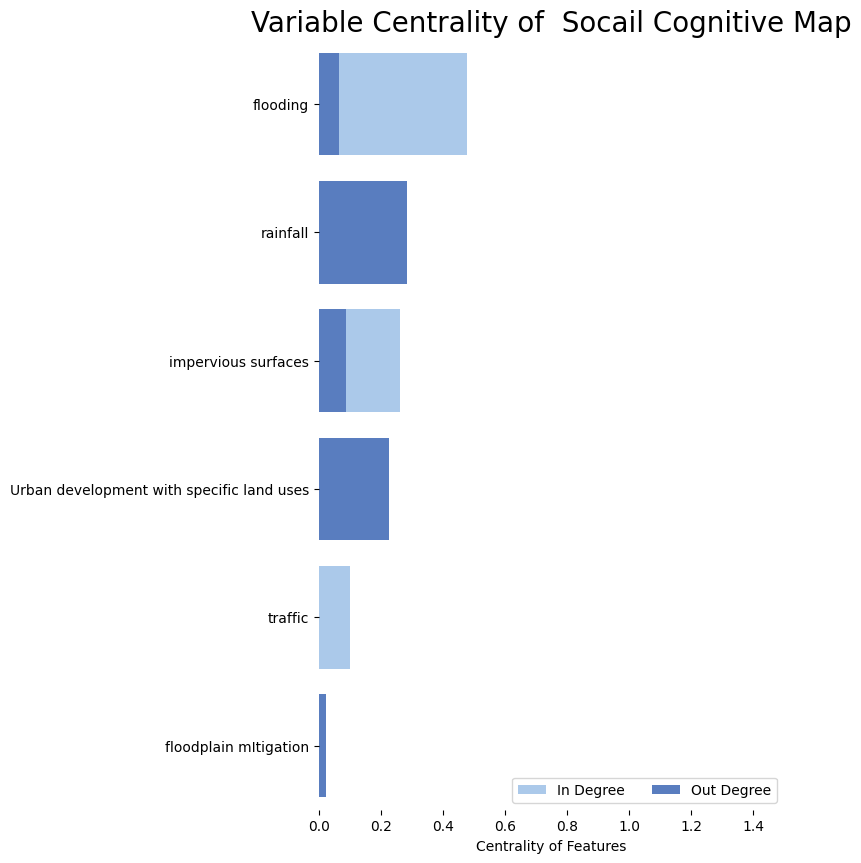

In [402]:
cluster_1_problem_text = " ".join(review for review in cluster_1['why_is_this_location_a_problem'])
generate_spatial_fcm(cluster_1_problem_text,df_agg_mean)

#### Barrier

Total Original Original Concepts: 126


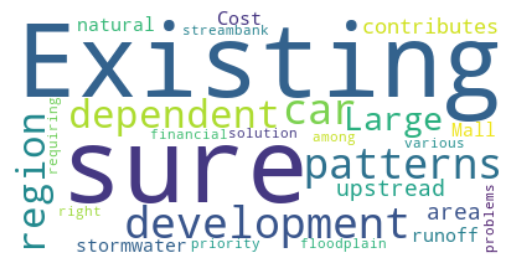

[(0, 1, {'weight': 0.024285714285714285})]
                                           centrality
Urban development with specific land uses    0.024286
runoff                                       0.024286
{'total_nodes': 2, 'total_edges': 1, 'distance': 0.5, 'ordinary': 0, 'receivers': 1, 'transmitters': 1, 'total variables': 2, 'receiver_components': ['runoff'], 'transmitters_components': ['Urban development with specific land uses'], 'central_components': ['Urban development with specific land uses'], 'weights': [0.024285714285714285], 'density': 0.5, 'new_centrality': {'variable': Index(['Urban development with specific land uses', 'runoff'], dtype='object'), 'in-degree': array([0.        , 0.02428571]), 'out-degree': array([0.02428571, 0.        ]), 'centrality': [0.024285714285714285, 0.024285714285714285]}, 'complexity': 1.0, 'hierarchy': 1.0}


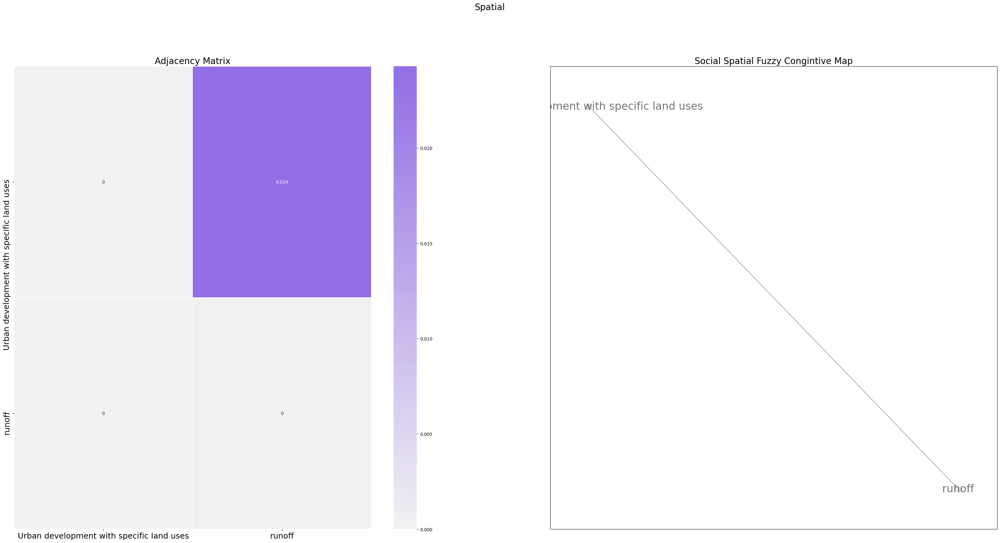

In [293]:
cluster_1_barrier_text = " ".join(review for review in cluster_1['what_is_the_greatest_barrier_to'])
generate_spatial_fcm(cluster_1_barrier_text,df_agg_mean)

#### Solution

Total Original Original Concepts: 126


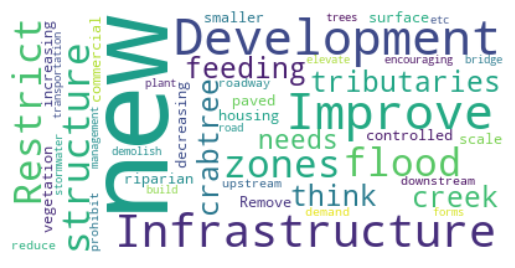

[(1, 0, {'weight': -0.032857142857142856}), (1, 5, {'weight': 0.014761904761904763})]
                                           centrality
Urban development with specific land uses    0.047619
riparian buffer                              0.032857
development restrictions                     0.014762
Stormwater Managment Regulations             0.000000
infrastructure                               0.000000
housing                                      0.000000
{'total_nodes': 6, 'total_edges': 2, 'distance': 0.3333333333333333, 'ordinary': 3, 'receivers': 2, 'transmitters': 1, 'total variables': 6, 'receiver_components': ['riparian buffer', 'development restrictions'], 'transmitters_components': ['Urban development with specific land uses'], 'central_components': ['Urban development with specific land uses'], 'weights': [-0.032857142857142856, 0.014761904761904763], 'density': 0.06666666666666667, 'new_centrality': {'variable': Index(['riparian buffer', 'Urban development with specific 

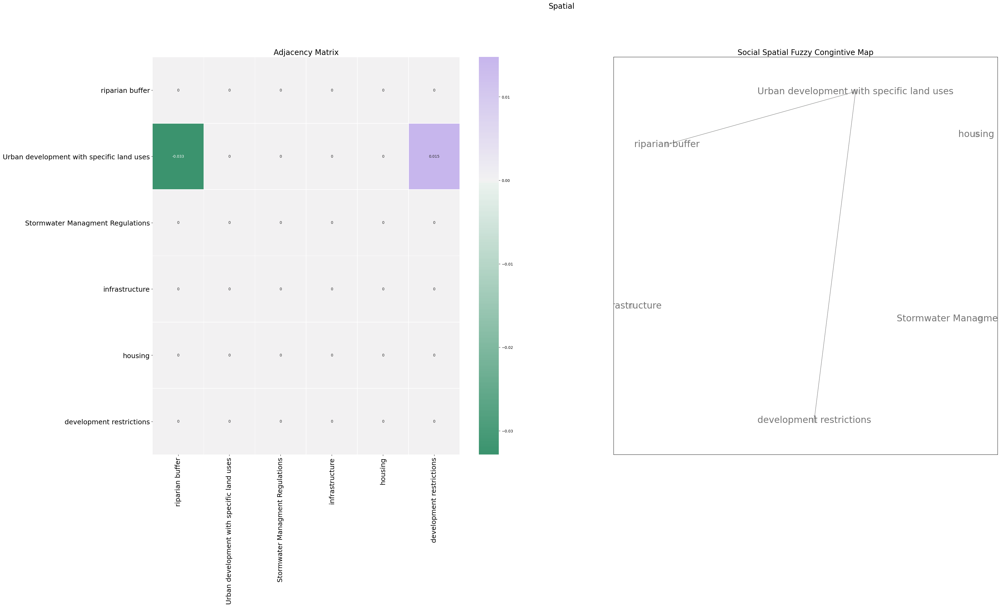

In [295]:
cluster_1_solution_text = " ".join(review for review in cluster_1['what_actions_can_be_taken_to_fi'])
generate_spatial_fcm(cluster_1_solution_text,df_agg_mean)

#### Problem Barrier and Solution

Total Original Original Concepts: 126


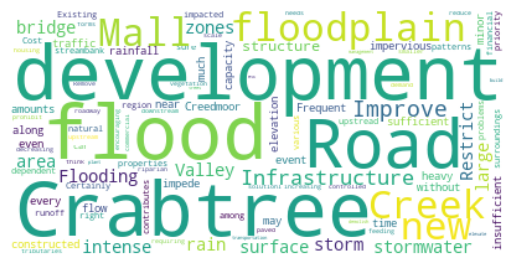

[(0, 3, {'weight': 0.2833333333333333}), (0, 5, {'weight': 0.2571428571428572}), (0, 7, {'weight': -0.024285714285714285}), (1, 3, {'weight': 0.08857142857142856}), (1, 5, {'weight': 0.29095238095238096}), (2, 3, {'weight': 0.0009523809523809532}), (2, 5, {'weight': 0.024285714285714285}), (3, 6, {'weight': 0.06523809523809523}), (4, 1, {'weight': 0.14904761904761907}), (4, 2, {'weight': -0.032857142857142856}), (4, 3, {'weight': 0.039523809523809524}), (4, 5, {'weight': 0.024285714285714285}), (4, 6, {'weight': 0.03619047619047619}), (4, 10, {'weight': 0.014761904761904763}), (5, 3, {'weight': 0.2195238095238095})]
                                           centrality
runoff                                       0.816190
flooding                                     0.697143
rainfall                                     0.564762
impervious surfaces                          0.528571
Urban development with specific land uses    0.296667
traffic                                      0.10142

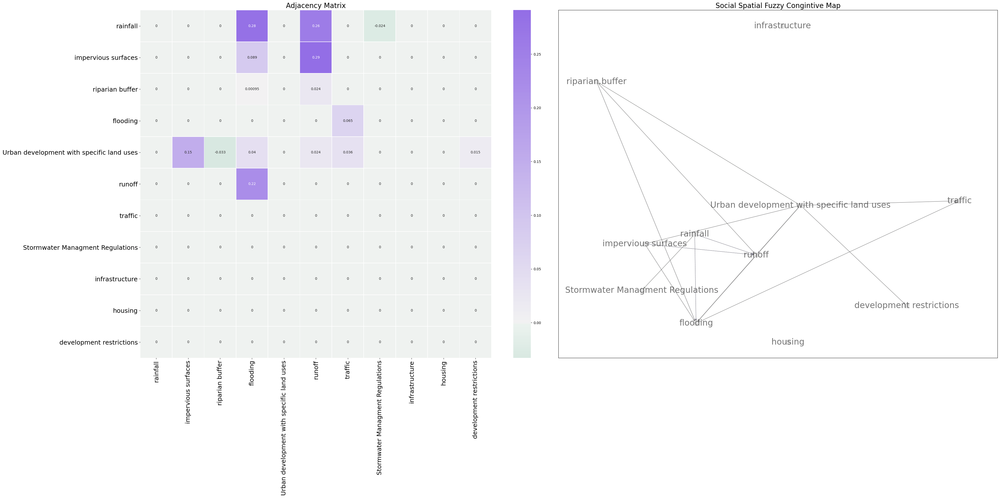

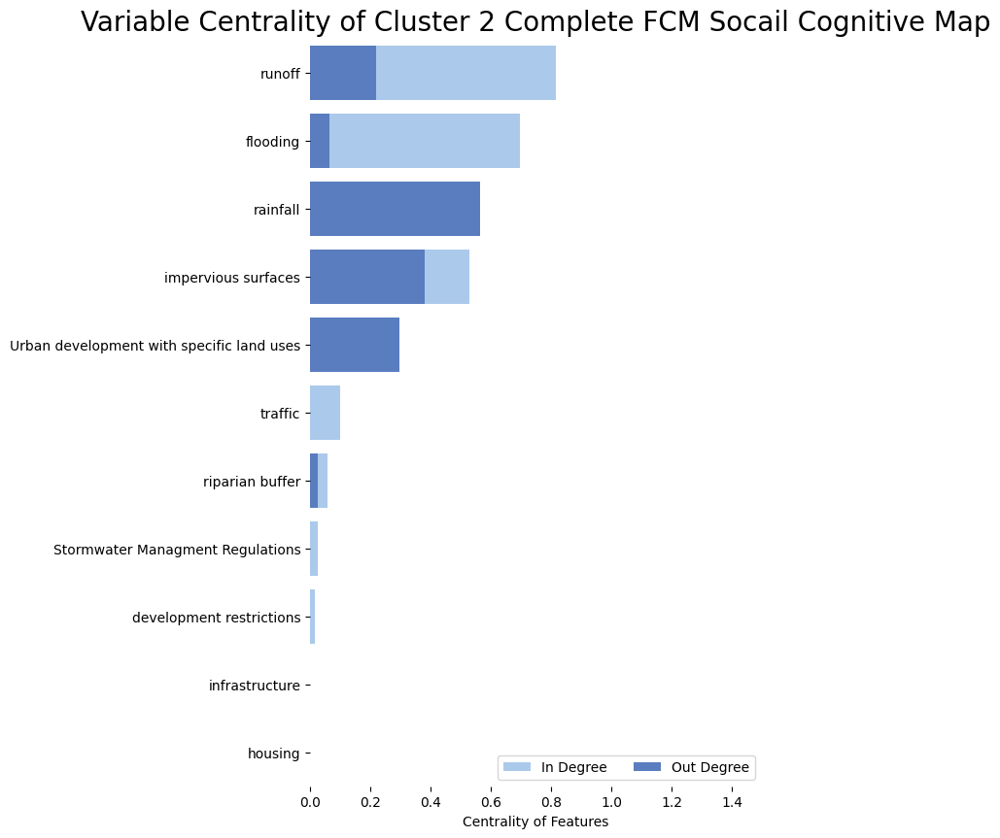

In [397]:
cluster_1_all_text =cluster_1_problem_text+cluster_1_barrier_text+cluster_1_solution_text
generate_spatial_fcm(cluster_1_all_text,df_agg_mean, title="Cluster 2 Complete FCM")

## Cluster 3 (NCSU)

In [297]:
cluster_2 = df_survey[df_survey['clusters'] == 2] #

### Survey Summary Statistics

In [361]:
# time_map = {"day": 0, "week":1, "month": 2,"year": 3, "decade": 4}
# df_survey['how_long_scaled'] = df_survey['how_long'].map(time_map)
# df_survey['how_often_scaled'] = df_survey['how_often'].map(time_map)

# import numpy as np
# extent_map = {"household": 0, "neighborhood":1, "city": 2,"region": 3, 'global': 4, 'not_sure': 5}
# # extent_map = {"household": 1, "neighborhood":10, "city": 100,"region": 1000, 'global': 10000, 'not_sure': 2}

# df_survey['driver_extent_scaled'] = df_survey['At what spatial scale does the driver of this problem occur?'].map(extent_map)
# df_survey['impact_extent_scaled'] = df_survey['At what spatial scale does the impact of this problem occur?'].map(extent_map)

# likert_scale = {'unserious': -2, 'somewhat_unserious': -1, 'neutral': 0, 'somewhat_serious': 1, 'serious': 2}	
# df_survey['serious_scaled'] = df_survey['how_serious_is_this_problem'].map(likert_scale)


# challenge_scale = {'solved': 0, 'very': 1, 'easy': 2, 'medium': 3, 'hard': 4, 'very_hard': 5, 'impossible': 6}

cluster_2[['challenge_scaled', 'serious_scaled', 'impact_extent_scaled', 'driver_extent_scaled', 'how_often_scaled', 'how_long_scaled', 'when_will_this_problem_exist_']].describe()

,challenge_scaled,serious_scaled,impact_extent_scaled,driver_extent_scaled,how_often_scaled,how_long_scaled
count,3.0,3.0,3.0,3.0,3.000000,3.000000
mean,4.0,1.0,0.0,1.0,2.666667,1.333333
std,1.0,1.0,0.0,0.0,0.577350,1.527525
min,3.0,0.0,0.0,1.0,2.000000,0.000000
25%,3.5,0.5,0.0,1.0,2.500000,0.500000
50%,4.0,1.0,0.0,1.0,3.000000,1.000000
75%,4.5,1.5,0.0,1.0,3.000000,2.000000
max,5.0,2.0,0.0,1.0,3.000000,3.000000


### When will this problem exist?

No handles with labels found to put in legend.


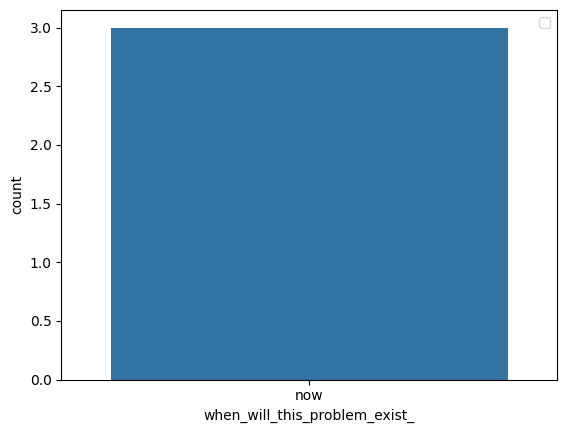

In [358]:
fig, ax1 = plt.subplots(ncols=1)
sns.countplot(x='when_will_this_problem_exist_',
              data=cluster_2, orient='v')
plt.legend(loc='upper right')
# plt.savefig(os.path.join(save_location, "how_challenging_driver_scale.png"), bbox_inches="tight")

### Whats the Purpose of the Game?

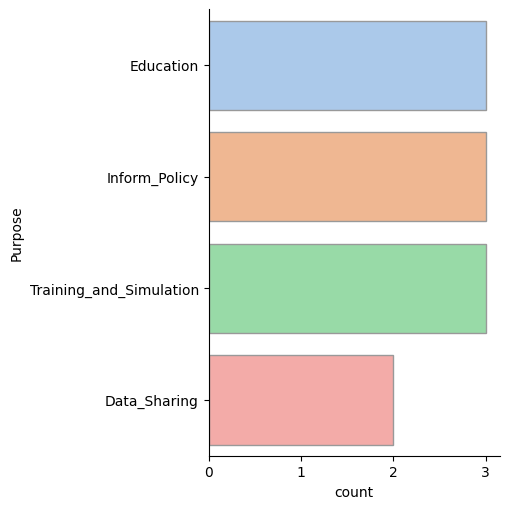

In [371]:
gamePurpose(cluster_2)

### What type of game?

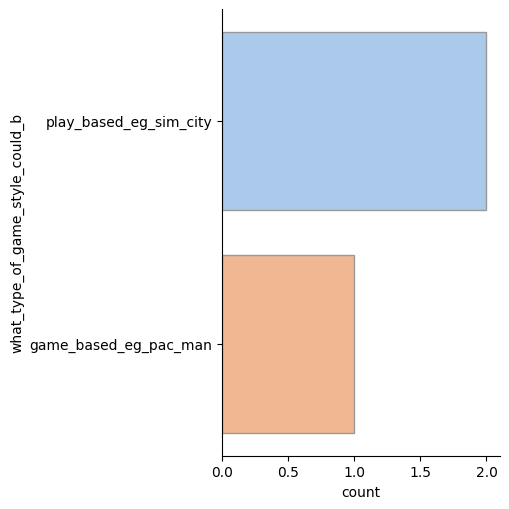

In [372]:
sns.catplot(y="what_type_of_game_style_could_b", kind="count",palette="pastel", edgecolor=".6",data=cluster_2)

### FCM and Wordcloud

#### Problem

In [362]:
for review in cluster_2['why_is_this_location_a_problem']:
  print(review)

50 acres of land draining to a single 30" pipe.
Flooding in the region of Dabney/Cox Hall. Drainage issue from brickyard likely figures.
Collapsed Storm Drain.  Floods Pullen Road.


Total Original Original Concepts: 126


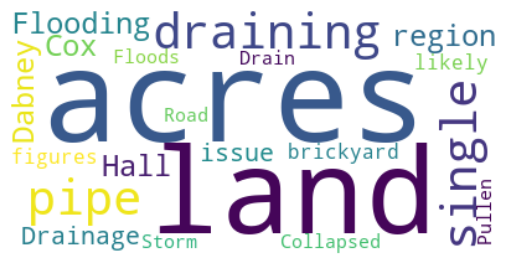

[]
          centrality
rainfall         0.0
Zero transmitters identified
{'total_nodes': 1, 'total_edges': 0, 'distance': 0.0, 'ordinary': 1, 'receivers': 0, 'transmitters': 0, 'total variables': 1, 'receiver_components': [], 'transmitters_components': [], 'central_components': ['rainfall'], 'weights': [], 'density': 0, 'new_centrality': {'variable': Index(['rainfall'], dtype='object'), 'in-degree': array([0.]), 'out-degree': array([0.]), 'centrality': [0.0]}}


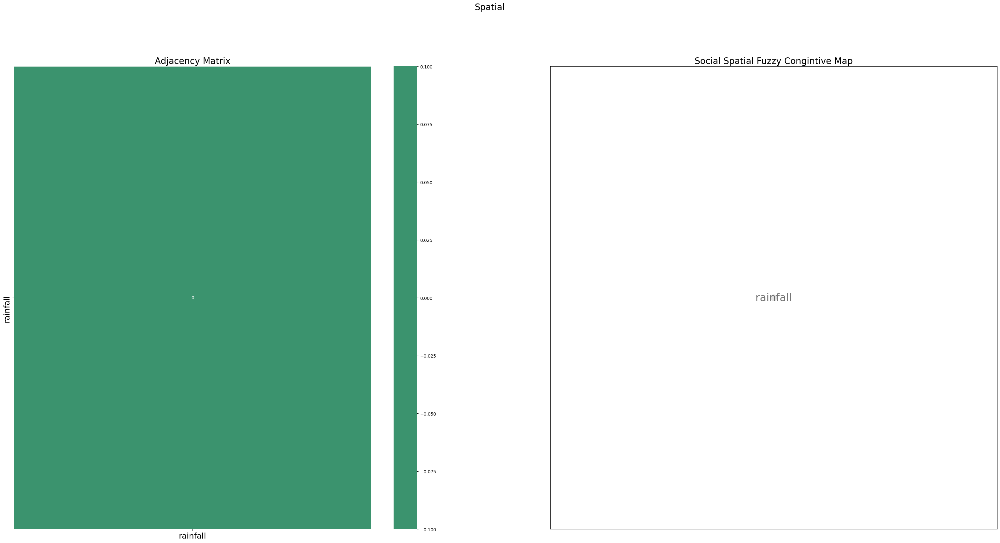

In [298]:
cluster_2_problem_text = " ".join(review for review in cluster_2['why_is_this_location_a_problem'])
generate_spatial_fcm(cluster_2_problem_text,df_agg_mean)

#### Barrier

In [363]:
for review in cluster_2['what_is_the_greatest_barrier_to']:
  print(review)

How to fit a suitable sized pipe over a 10 foot tall underground tunnel.
Inadequate infrastructure
Low priority with City of Raleigh


Total Original Original Concepts: 126


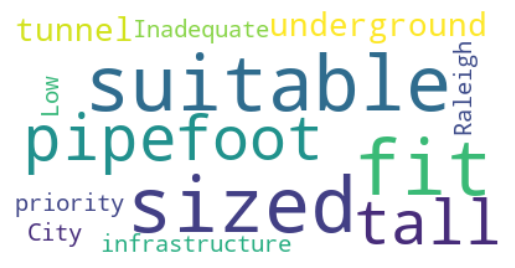

[]
                centrality
infrastructure         0.0
Zero transmitters identified
{'total_nodes': 1, 'total_edges': 0, 'distance': 0.0, 'ordinary': 1, 'receivers': 0, 'transmitters': 0, 'total variables': 1, 'receiver_components': [], 'transmitters_components': [], 'central_components': ['infrastructure'], 'weights': [], 'density': 0, 'new_centrality': {'variable': Index(['infrastructure'], dtype='object'), 'in-degree': array([0.]), 'out-degree': array([0.]), 'centrality': [0.0]}}


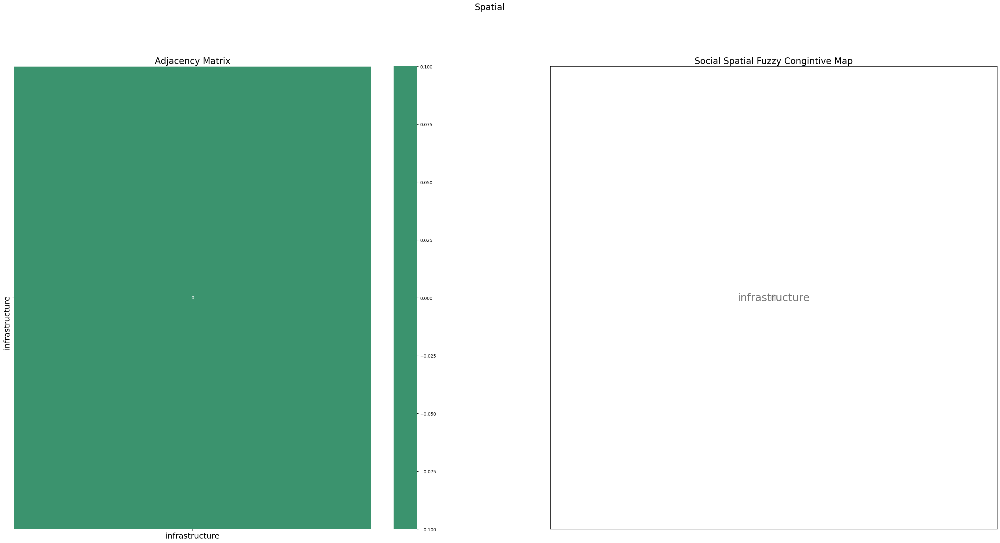

In [299]:
cluster_2_barrier_text = " ".join(review for review in cluster_2['what_is_the_greatest_barrier_to'])
generate_spatial_fcm(cluster_2_barrier_text,df_agg_mean)

#### Solution

In [364]:
for review in cluster_2['what_actions_can_be_taken_to_fi']:
  print(review)

Improve underground infrastructure.  The challenge is working around existing above ground buildings and a very dense existing underground utility network.
Improve Infrastructure
Fix collapsed/blocked storm drain.


Total Original Original Concepts: 126


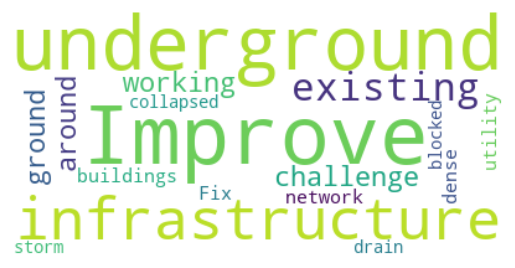

[]
                centrality
rainfall               0.0
infrastructure         0.0
Zero transmitters identified
{'total_nodes': 2, 'total_edges': 0, 'distance': 0.0, 'ordinary': 2, 'receivers': 0, 'transmitters': 0, 'total variables': 2, 'receiver_components': [], 'transmitters_components': [], 'central_components': ['rainfall'], 'weights': [], 'density': 0, 'new_centrality': {'variable': Index(['rainfall', 'infrastructure'], dtype='object'), 'in-degree': array([0., 0.]), 'out-degree': array([0., 0.]), 'centrality': [0.0, 0.0]}}


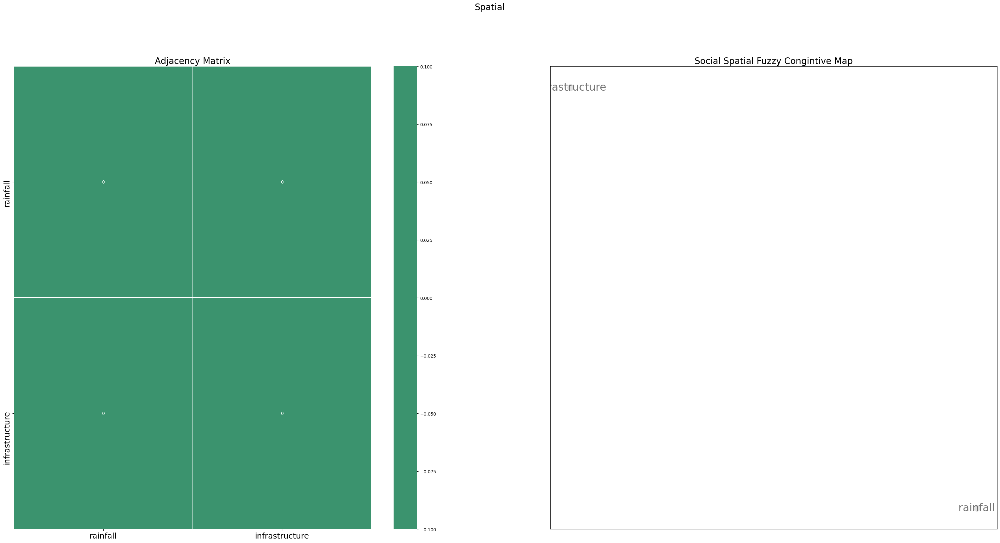

In [300]:
cluster_2_solution_text = " ".join(review for review in cluster_2['what_actions_can_be_taken_to_fi'])
generate_spatial_fcm(cluster_2_solution_text,df_agg_mean)

#### Problem, Barrier and Solution

Total Original Original Concepts: 126


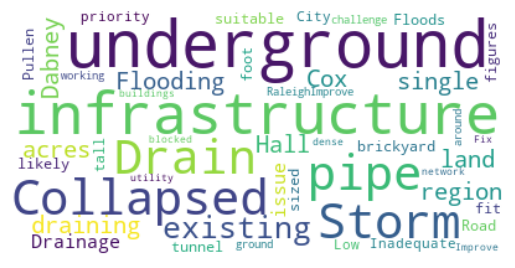

[]
                centrality
rainfall               0.0
infrastructure         0.0
Zero transmitters identified


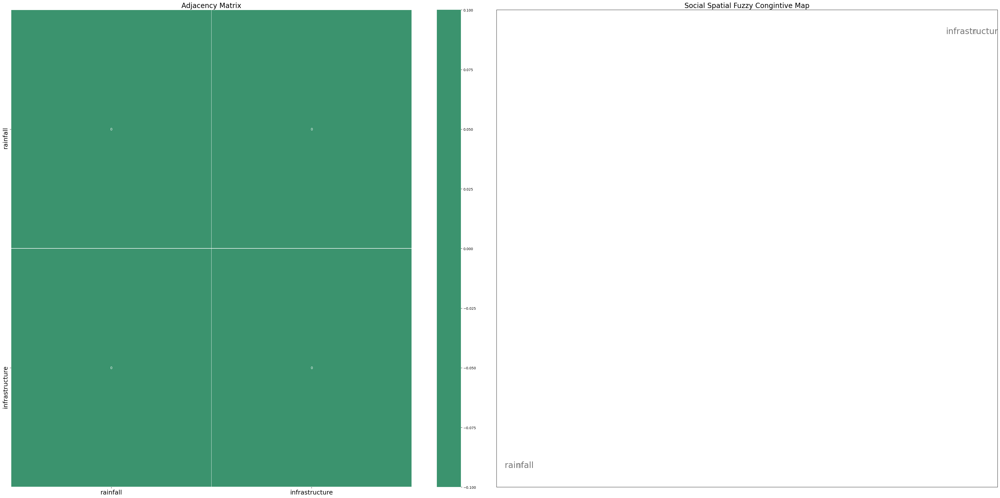

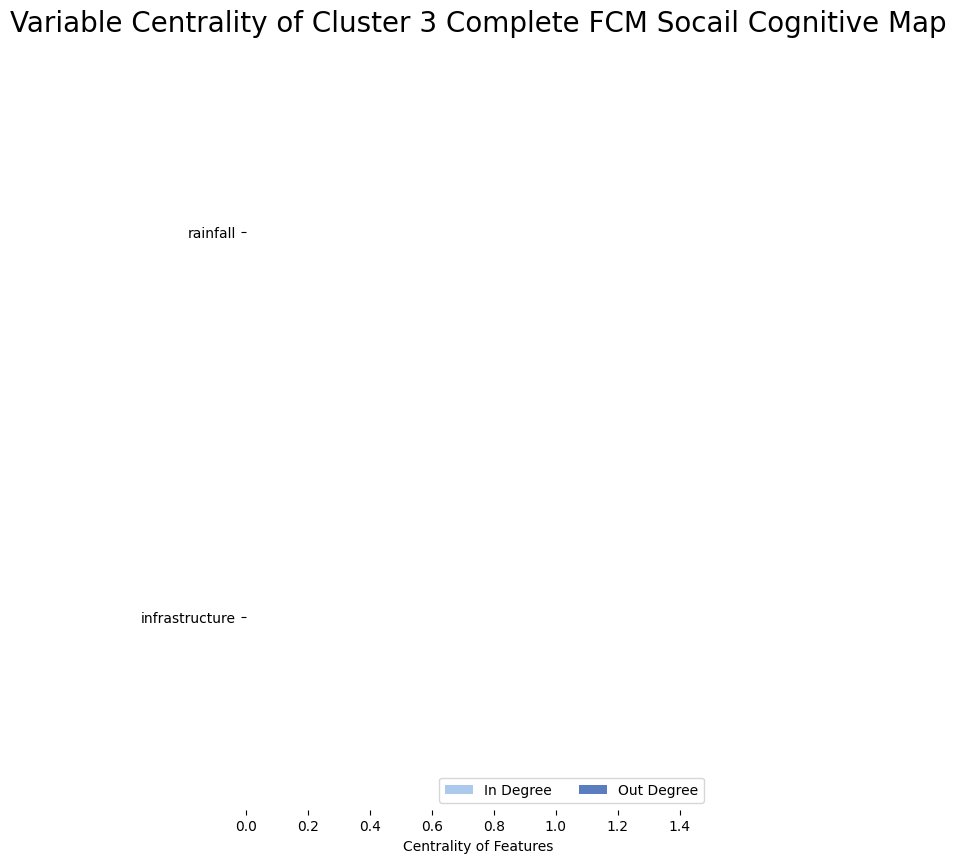

In [396]:
cluster_2_all_text =cluster_2_problem_text+cluster_2_barrier_text+cluster_2_solution_text
generate_spatial_fcm(cluster_2_all_text,df_agg_mean, title="Cluster 3 Complete FCM")

## Cluster 1 (University Mall)

In [120]:
cluster_3 = df_survey[df_survey['clusters'] == 0] #

### Survey Summary Statistics

In [121]:
# time_map = {"day": 0, "week":1, "month": 2,"year": 3, "decade": 4}
# df_survey['how_long_scaled'] = df_survey['how_long'].map(time_map)
# df_survey['how_often_scaled'] = df_survey['how_often'].map(time_map)

# import numpy as np
# extent_map = {"household": 0, "neighborhood":1, "city": 2,"region": 3, 'global': 4, 'not_sure': 5}
# # extent_map = {"household": 1, "neighborhood":10, "city": 100,"region": 1000, 'global': 10000, 'not_sure': 2}

# df_survey['driver_extent_scaled'] = df_survey['At what spatial scale does the driver of this problem occur?'].map(extent_map)
# df_survey['impact_extent_scaled'] = df_survey['At what spatial scale does the impact of this problem occur?'].map(extent_map)

# likert_scale = {'unserious': -2, 'somewhat_unserious': -1, 'neutral': 0, 'somewhat_serious': 1, 'serious': 2}	
# df_survey['serious_scaled'] = df_survey['how_serious_is_this_problem'].map(likert_scale)


# challenge_scale = {'solved': 0, 'very': 1, 'easy': 2, 'medium': 3, 'hard': 4, 'very_hard': 5, 'impossible': 6}

cluster_3[['challenge_scaled', 'serious_scaled', 'impact_extent_scaled', 'driver_extent_scaled', 'how_often_scaled', 'how_long_scaled', 'when_will_this_problem_exist_']].describe()

,challenge_scaled,serious_scaled,impact_extent_scaled,driver_extent_scaled,how_often_scaled,how_long_scaled
count,5.00000,5.000000,5.000000,5.000000,5.000000,5.0
mean,4.20000,0.800000,1.400000,1.600000,2.800000,1.0
std,1.30384,1.095445,0.547723,0.547723,0.447214,1.0
min,2.00000,-1.000000,1.000000,1.000000,2.000000,0.0
25%,4.00000,1.000000,1.000000,1.000000,3.000000,0.0
50%,5.00000,1.000000,1.000000,2.000000,3.000000,1.0
75%,5.00000,1.000000,2.000000,2.000000,3.000000,2.0
max,5.00000,2.000000,2.000000,2.000000,3.000000,2.0


### When will this problem exist?

No handles with labels found to put in legend.


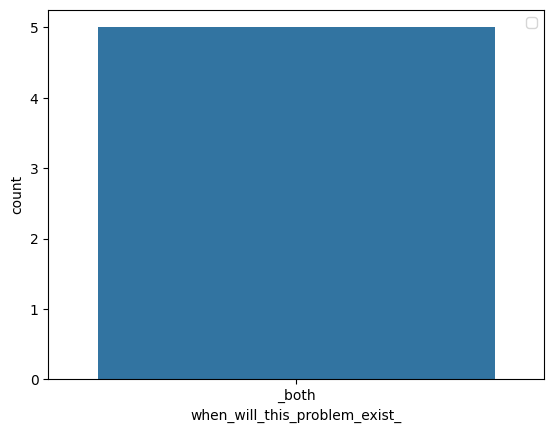

In [122]:
fig, ax1 = plt.subplots(ncols=1)
sns.countplot(x='when_will_this_problem_exist_',
              data=cluster_3, orient='v')
plt.legend(loc='upper right')
# plt.savefig(os.path.join(save_location, "how_challenging_driver_scale.png"), bbox_inches="tight")

### What is the purpose of the game?

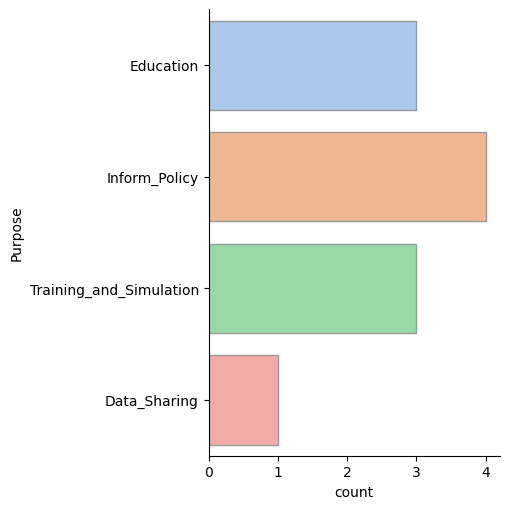

In [123]:
gamePurpose(cluster_3)

### What type of game?

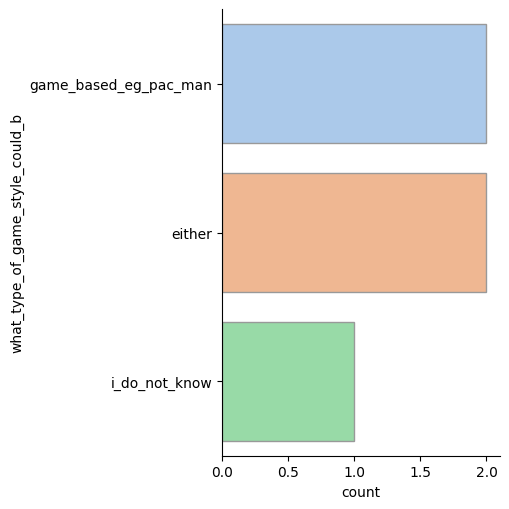

In [373]:
sns.catplot(y="what_type_of_game_style_could_b", kind="count",palette="pastel", edgecolor=".6",data=cluster_3)

### FCM and Wordcloud

#### Problem

In [124]:
for review in cluster_3['why_is_this_location_a_problem']:
  print(review)

Confluence of two major streams/drainage basin pour points in a location where there is minimal fall/elevation change to the receiving waterbody (Jordan Lake). Persistent flooding due to upstream development combined with the minimal elevation change. 
It might not be a problem; it's just that it floods all the time - but it's in a floodplain so maybe that's ok
Existing development in the 100-yr floodplain (pre-regulation).  Housing units represent affordable rental units, but experience regular flooding with moderate-heavy rain events. The Town has twice secured funds for Hazard Mitigation through FEMA, but the second story owners have no interest in selling while the first floor owners want to sell. Participation requires 100% agreement among owners.
Camelot Village is a condo community, primarily resided in by renters.  Most of the site is located in the floodway and the entire site is in the floodplain.  It floods in every major rain, requiring residents to be evacuated. 
Universit

Total Original Original Concepts: 126


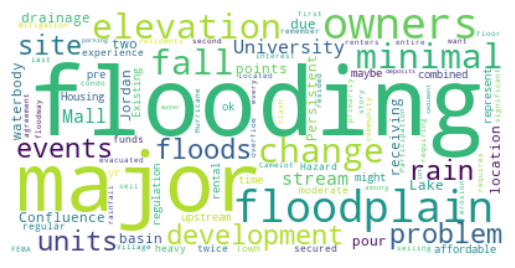

[(0, 1, {'weight': 0.2833333333333333}), (0, 4, {'weight': 0.02238095238095238}), (2, 1, {'weight': 0.039523809523809524}), (4, 1, {'weight': 0.014761904761904763}), (6, 1, {'weight': 0.047619047619047616}), (7, 6, {'weight': -0.047619047619047616})]
                                           centrality
flooding                                     0.385238
rainfall                                     0.305714
development in floodplain                    0.095238
floodplain mItigation                        0.047619
Urban development with specific land uses    0.039524
stream overflow                              0.037143
erosion                                      0.000000
housing                                      0.000000


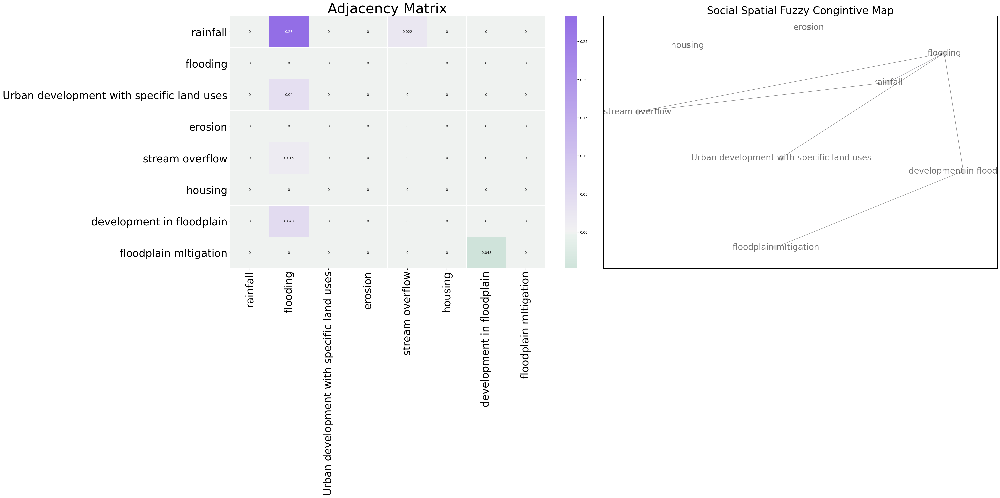

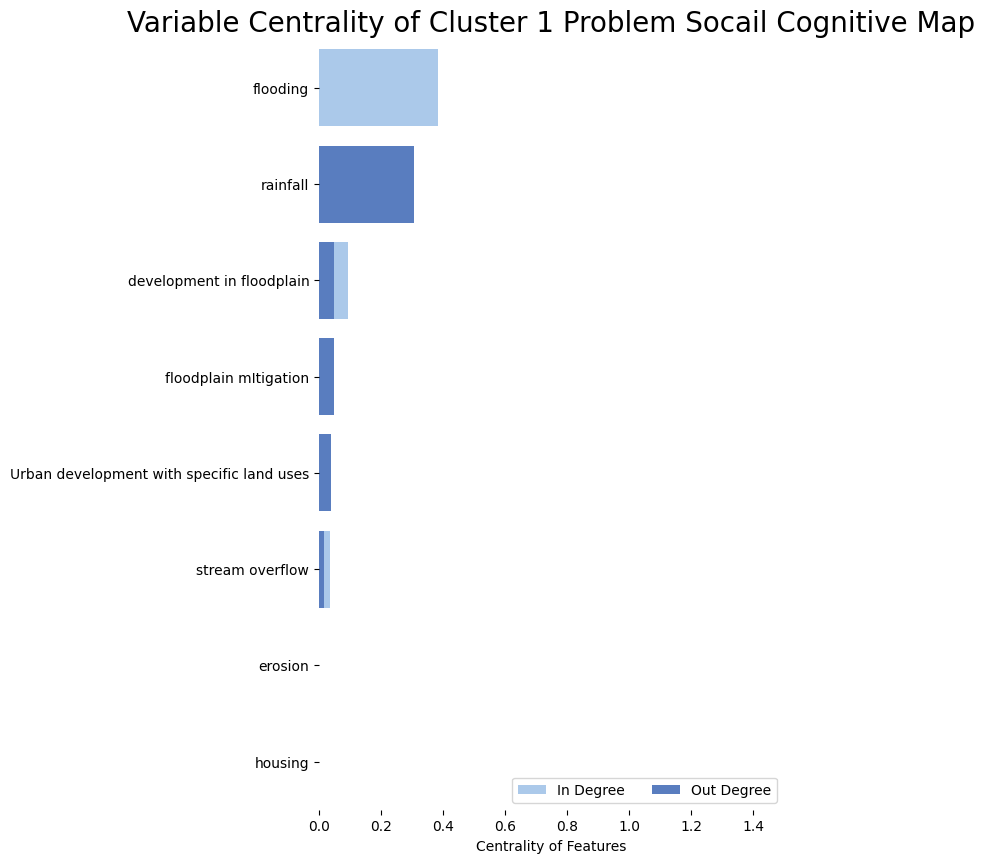

In [125]:
cluster_3_problem_text = " ".join(review for review in cluster_3['why_is_this_location_a_problem'])
generate_spatial_fcm(cluster_3_problem_text,df_agg_mean, "Cluster 1 Problem")

#### Barrier

In [126]:
for review in cluster_3['what_is_the_greatest_barrier_to']:
  print(review)

Established neighborhoods in this location are in and near the regulatory floodplain. Upstream development is >80% established residential and unlikely to present redevelopment retrofit opportunities. New higher density development follows current guidelines, but this is insufficient without addressing the existing conditions. Downstream property is USACOE managed and includes the Jordan Lake Flowage Easement.
The road is in the wrong place
The conflict between 1st floor owner/residents and second floor owners with regards to their interest in selling to the Town.
The Town has attempted to buyout the property using FEMA money.  Because there are so many individual owners as part of the condo structure, efforts to get the required percentage of cooperation have failed.   In theory a Town buyout would be easier than a FEMA buyout, but the Town does not have funding.   Absentee owners are not affected.  The lower income residents are repeatedly experiencing the impacts to their household 

Total Original Original Concepts: 126


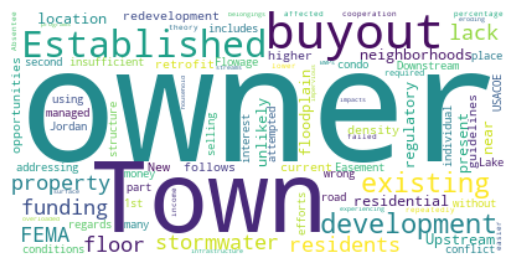

[(2, 0, {'weight': 0.14904761904761907}), (2, 3, {'weight': 0.013809523809523808}), (5, 0, {'weight': 0.06857142857142857})]
                                           centrality
impervious surfaces                          0.217619
Urban development with specific land uses    0.162857
development in floodplain                    0.068571
Stormwater Management Budget                 0.013810
SCM                                          0.000000
infrastructure                               0.000000


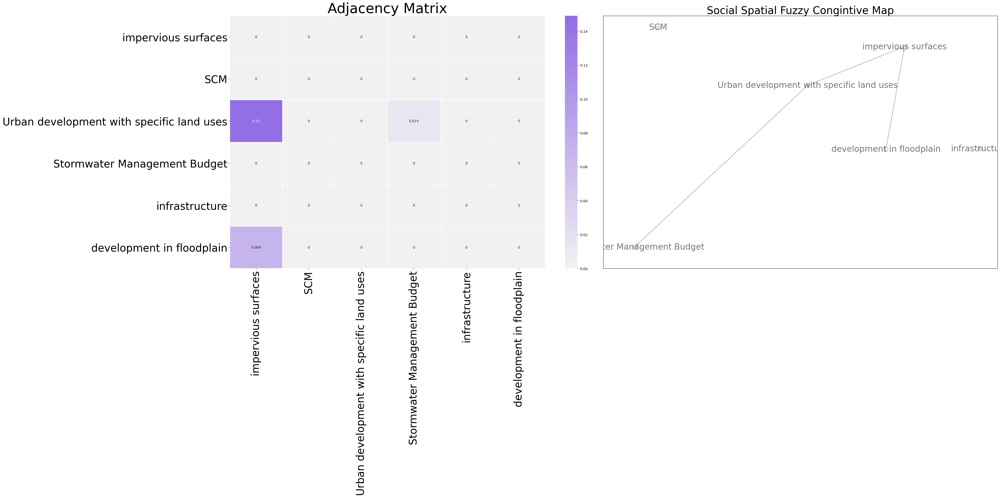

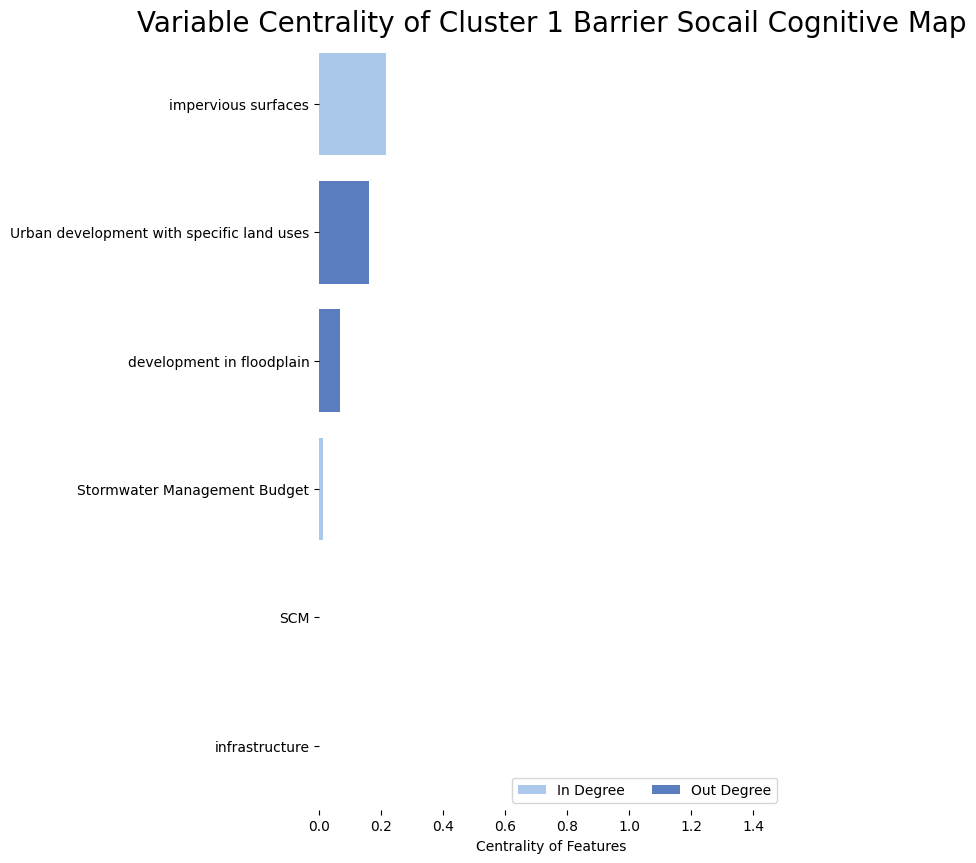

In [130]:
cluster_3_barrier_text = " ".join(review for review in cluster_3['what_is_the_greatest_barrier_to'])
generate_spatial_fcm(cluster_3_barrier_text,df_agg_mean,"Cluster 1 Barrier")

#### Solution

In [127]:
for review in cluster_3['what_actions_can_be_taken_to_fi']:
  print(review)

Upstream retention/retrofit, community understanding of nature of the problem, mitigation within floodplain,
Block the road
Demolition, Floodplain Mitigation, increased retention/detention volume
More funding,  education of absentee owners, education of renters about the risk of flooding, 
Install stormwater BMPs in various areas to treat/capture runoff, limit further impervious surface construction in the future


Total Original Original Concepts: 126


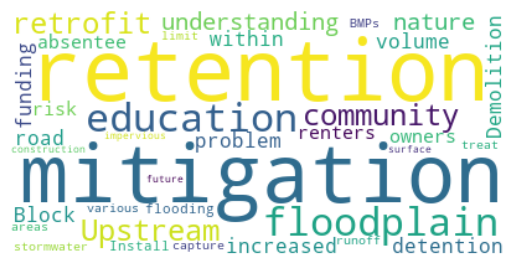

[(0, 1, {'weight': 0.08857142857142856}), (0, 3, {'weight': 0.29095238095238096}), (0, 6, {'weight': -0.02}), (2, 1, {'weight': -0.09047619047619047}), (2, 3, {'weight': -0.05761904761904762}), (3, 1, {'weight': 0.2195238095238095}), (4, 3, {'weight': -0.013809523809523808}), (6, 0, {'weight': -0.010476190476190476}), (6, 3, {'weight': -0.09238095238095238}), (7, 0, {'weight': 0.06857142857142857}), (7, 1, {'weight': 0.047619047619047616}), (7, 3, {'weight': 0.011428571428571429}), (7, 6, {'weight': -0.029047619047619048}), (8, 0, {'weight': -0.023809523809523808}), (8, 3, {'weight': -0.02}), (8, 7, {'weight': -0.047619047619047616})]
                              centrality
runoff                          0.705714
impervious surfaces             0.502381
flooding                        0.446190
development in floodplain       0.204286
retention/detention capacity    0.151905
SCM                             0.148095
floodplain mItigation           0.091429
Stormwater Management Budget 

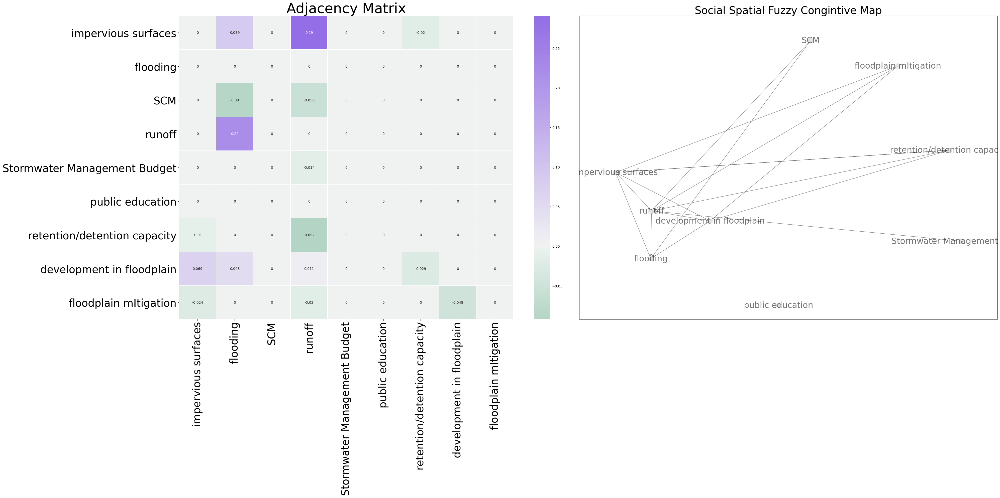

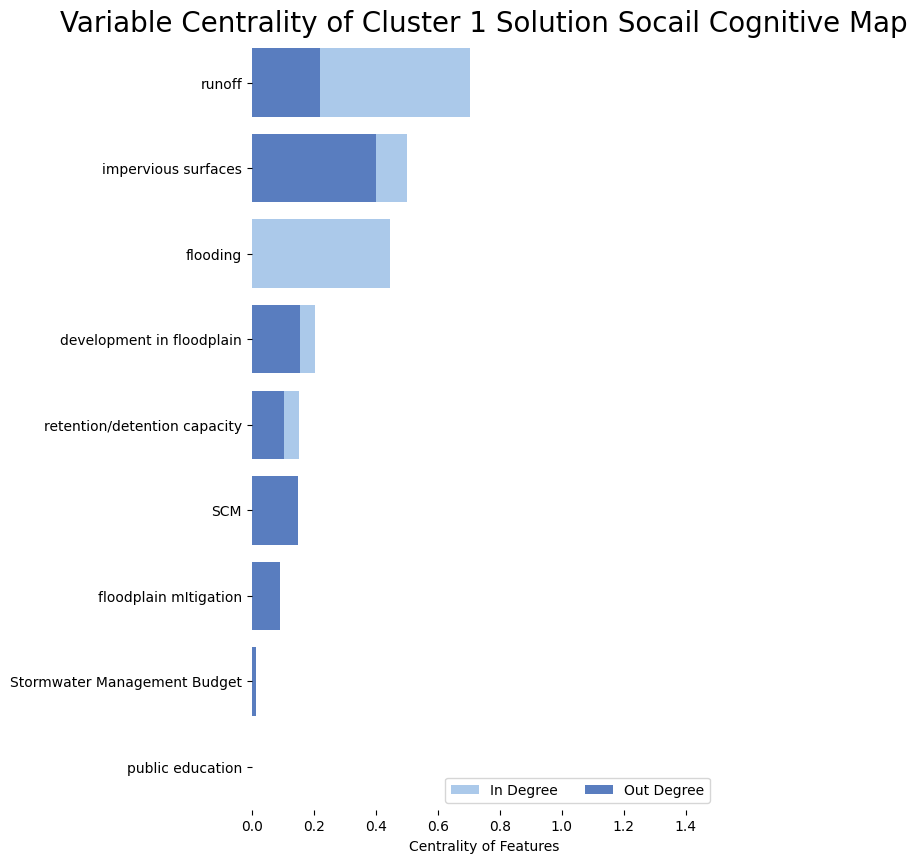

In [129]:
cluster_3_solution_text = " ".join(review for review in cluster_3['what_actions_can_be_taken_to_fi'])
generate_spatial_fcm(cluster_3_solution_text,df_agg_mean, "Cluster 1 Solution")

#### Problem, Barrier and Solution

Total Original Original Concepts: 126


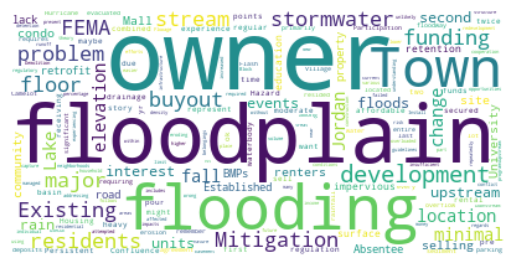

[(0, 2, {'weight': 0.2833333333333333}), (0, 5, {'weight': 0.2571428571428572}), (0, 9, {'weight': 0.004285714285714284}), (0, 10, {'weight': 0.02238095238095238}), (1, 2, {'weight': 0.08857142857142856}), (1, 5, {'weight': 0.29095238095238096}), (1, 6, {'weight': -0.007619047619047619}), (1, 9, {'weight': -0.02}), (3, 2, {'weight': -0.09047619047619047}), (3, 5, {'weight': -0.05761904761904762}), (3, 6, {'weight': -0.02666666666666667}), (4, 1, {'weight': 0.14904761904761907}), (4, 2, {'weight': 0.039523809523809524}), (4, 5, {'weight': 0.024285714285714285}), (4, 7, {'weight': 0.013809523809523808}), (4, 9, {'weight': 0.005238095238095238}), (5, 2, {'weight': 0.2195238095238095}), (5, 6, {'weight': 0.08333333333333333}), (7, 5, {'weight': -0.013809523809523808}), (9, 1, {'weight': -0.010476190476190476}), (9, 5, {'weight': -0.09238095238095238}), (10, 2, {'weight': 0.014761904761904763}), (13, 1, {'weight': 0.06857142857142857}), (13, 2, {'weight': 0.047619047619047616}), (13, 5, {'w

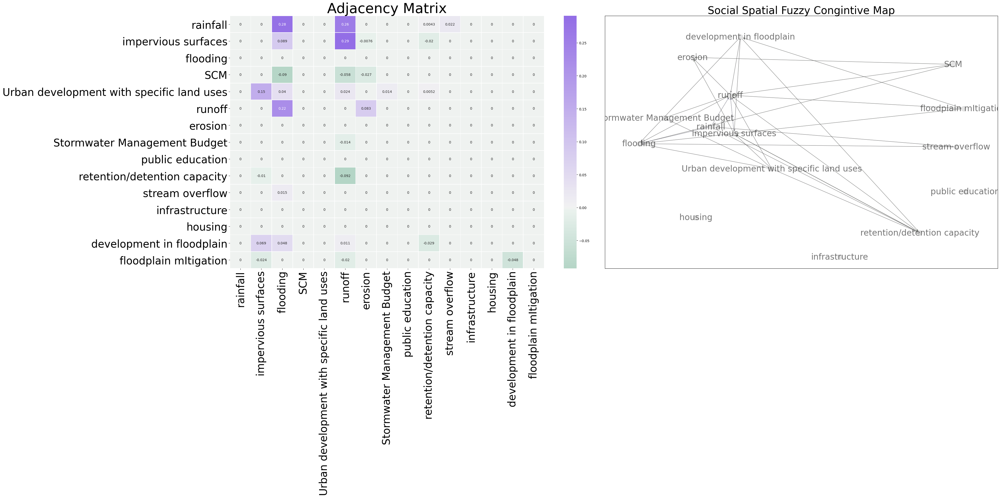

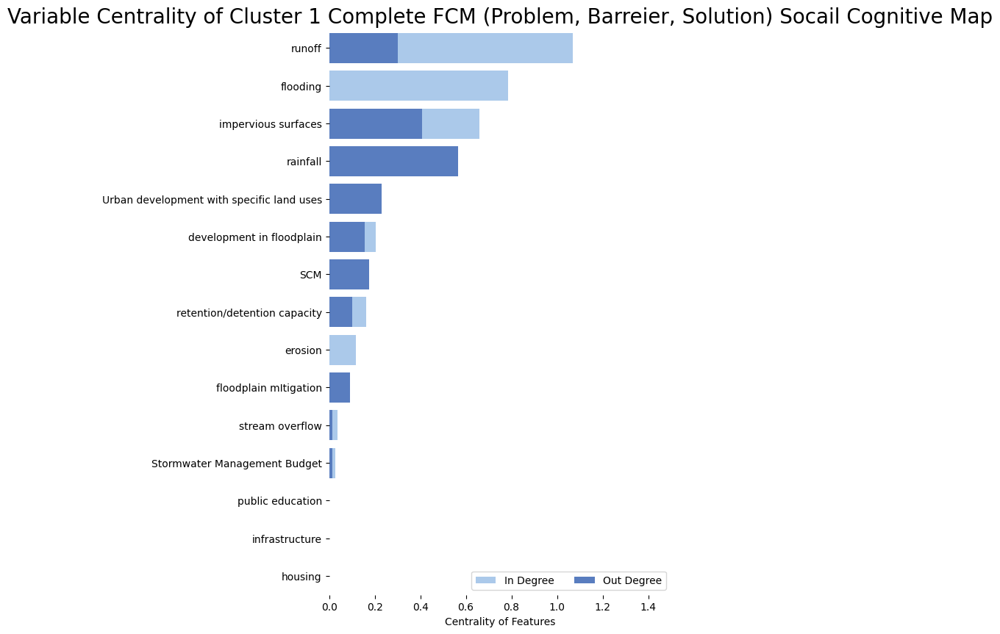

In [131]:
cluster_3_all_text =cluster_3_problem_text+cluster_3_barrier_text+cluster_3_solution_text
generate_spatial_fcm(cluster_3_all_text,df_agg_mean, title="Cluster 1 Complete FCM (Problem, Barreier, Solution)")

# Textnet

In [228]:
!pip install textnets


     |████████████████████████████████| 9.5MB 4.8MB/s 
     |████████████████████████████████| 3.2MB 40.8MB/s 
     |████████████████████████████████| 51kB 5.8MB/s 
     |████████████████████████████████| 71kB 6.9MB/s 
     |████████████████████████████████| 2.4MB 35.5MB/s 
     |████████████████████████████████| 9.9MB 38.5MB/s 
     |████████████████████████████████| 25.9MB 109kB/s 
     |████████████████████████████████| 2.1MB 27.5MB/s 
  Created wheel for toolz: filename=toolz-0.10.0-cp37-none-any.whl size=55575 sha256=abd7f1e9393ae4432f04a70419ef6ba9f94e4cfe2f4e78612de43ce56182c412
  Stored in directory: /root/.cache/pip/wheels/e1/8b/65/3294e5b727440250bda09e8c0153b7ba19d328f661605cb151
  Created wheel for cairocffi: filename=cairocffi-1.1.0-cp37-none-any.whl size=88589 sha256=00c6624d2ed69bfd3dde41226e38dfa8e428bae44fc7b374959fdd30d878ccbe
  Stored in directory: /root/.cache/pip/wheels/11/5e/47/167d9dfd5fa5850dd0cd3db80afe6db46e620edec3419dce5a
Successfully built toolz cairocffi
E

In [231]:
from textnets import Corpus, Textnet
from textnets import examples

#https://textnets.readthedocs.io/en/stable/tutorial.html

In [254]:
cluster_1.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 6 entries, 3 to 25
Data columns (total 34 columns):
 #   Column                                                        Non-Null Count  Dtype   
---  ------                                                        --------------  -----   
 0   geometry                                                      6 non-null      geometry
 1   ObjectId                                                      6 non-null      int64   
 2   globalid                                                      6 non-null      object  
 3   CreationDate                                                  6 non-null      int64   
 4   Creator                                                       6 non-null      object  
 5   EditDate                                                      6 non-null      int64   
 6   Editor                                                        6 non-null      object  
 7   why_is_this_location_a_problem                           

In [258]:
df_cluster1_melt = cluster_1[['ObjectId','why_is_this_location_a_problem', 'what_is_the_greatest_barrier_to', 'what_actions_can_be_taken_to_fi']].melt(id_vars=["ObjectId"], 
        var_name="Question", 
        value_name="Value")
print(df_cluster1_melt.info())
corpus = Corpus(df_cluster1_melt['Value'])


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18 entries, 0 to 17
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   ObjectId  18 non-null     int64 
 1   Question  18 non-null     object
 2   Value     18 non-null     object
dtypes: int64(1), object(2)
memory usage: 560.0+ bytes
None


In [259]:
tn = Textnet(corpus.tokenized(), min_docs=1)


/usr/local/lib/python3.7/dist-packages/spacy/util.py:275: UserWarning: [W031] Model 'en_core_web_sm' (2.2.5) requires spaCy v2.2 and is incompatible with the current spaCy version (2.3.2). This may lead to unexpected results or runtime errors. To resolve this, download a newer compatible model or retrain your custom model with the current spaCy version. For more details and available updates, run: python -m spacy validate
  warnings.warn(warn_msg)


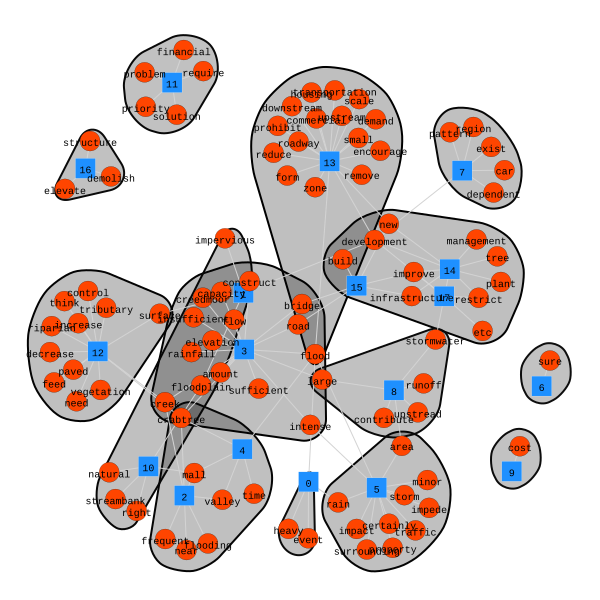

In [260]:
tn.plot(label_term_nodes=True,
        label_doc_nodes=True,
        show_clusters=True)

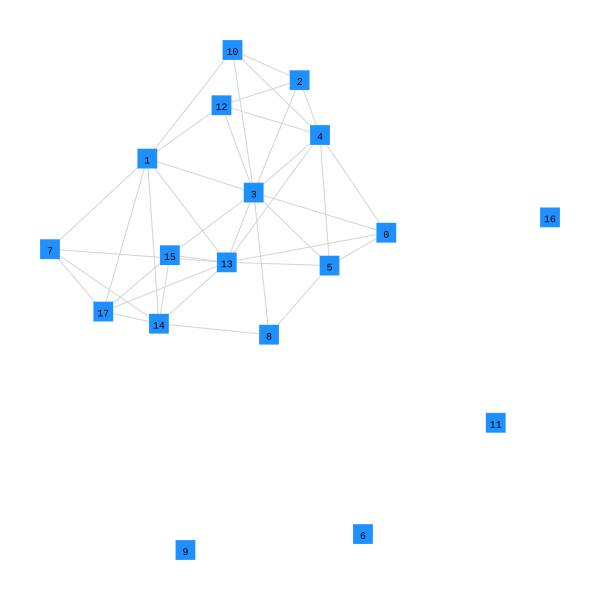

In [261]:
papers = tn.project(node_type='doc')
papers.plot(label_nodes=True)

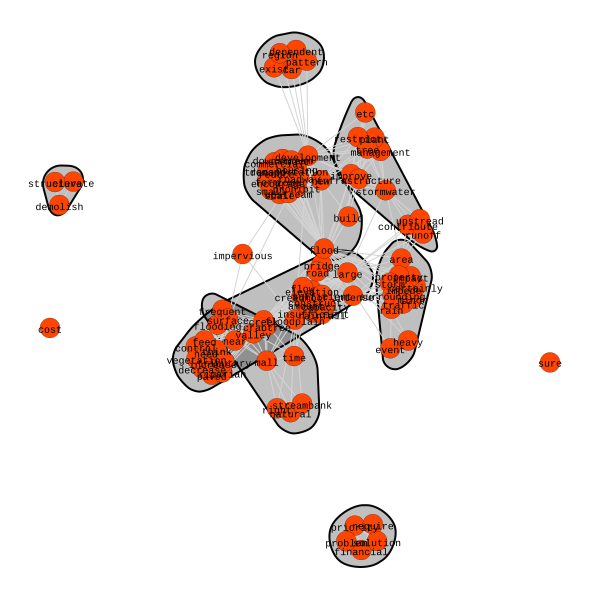

In [262]:
words = tn.project(node_type='term')
words.plot(label_nodes=True,
           show_clusters=True)

In [263]:
papers.top_betweenness()


3     31.0
15    11.0
14     6.0
13     5.0
1      4.0
4      3.0
12     2.0
8      1.0
2      1.0
5      1.0
dtype: float64

In [264]:
words.top_betweenness()


flood          908.000000
development    545.000000
creek          484.000000
crabtree       367.000000
intense        332.000000
floodplain     267.000000
new            218.333333
large          202.000000
road           200.000000
stormwater     198.000000
dtype: float64

In [247]:
# words.plot(label_nodes=True,
#            scale_nodes_by='closeness',
#            color_clusters=True,
#            alpha=0.5,node_label_filter=lambda n: n.betweenness() > words.betweenness.median())

In [ ]:
from google.colab import files

for root, dirs, filez in os.walk("./FCMs", topdown=False):
    for name in filez:
      if "Mean" in name:
        files.download("%s%s" % ("./FCMs/", name))

In [ ]:
files.download("./mean_of_stakeholders_combined_fcm.csv")
